# **Modules and Libraries**

In [ ]:
# General-purpose libraries
import numpy as np  # Operasi array dan aljabar linear
import pandas as pd  # Manipulasi data tabular
import seaborn as sns  # Visualisasi data berbasis Matplotlib
import matplotlib.pyplot as plt  # Visualisasi data
import os  # Operasi sistem file
from os import path  # Operasi lintasan file
import pickle  # Menyimpan dan memuat objek Python
import time  # Operasi waktu
import warnings  # Menangani peringatan runtime
import logging  # Logging aktivitas aplikasi
import sys  # Interaksi dengan interpreter Python

# Scikit-learn (Machine Learning dan utilitas)
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder  # Pranormalisasi dan encoding data
from sklearn import metrics  # Metode evaluasi model
from sklearn.model_selection import train_test_split, KFold, ParameterGrid  # Teknik pembagian dataset dan pencarian hyperparameter
from sklearn.metrics import (  # Evaluasi performa model
    accuracy_score,
    classification_report,
    confusion_matrix,
    precision_score,
    recall_score,
    f1_score,
    roc_auc_score
)
from sklearn.feature_extraction.text import TfidfVectorizer  # Ekstraksi fitur teks menggunakan TF-IDF
from sklearn.feature_extraction.text import CountVectorizer  # Ekstraksi fitur teks menggunakan frequensi kata

# Imbalanced-learn library
from imblearn.over_sampling import SMOTE  # Menangani ketidakseimbangan kelas dengan oversampling
from collections import Counter  # Menghitung elemen dalam koleksi

# PyTorch (Deep Learning)
import torch  # Kerangka kerja deep learning
import torch.nn as nn  # Modul neural network
import torch.nn.functional as F  # Fungsi aktifasi dan operasi tensor
from torch.utils.data import DataLoader, TensorDataset  # Manajemen data batch
from torch.cuda.amp import GradScaler, autocast  # Mixed precision training
from torch.optim import AdamW  # Optimizer berbasis Adam untuk weight decay

# Hugging Face Transformers (NLP)
import transformers  # Perpustakaan untuk model berbasis Transformer
from transformers import (
    BertTokenizer,  # Tokenisasi teks untuk model BERT
    BertTokenizerFast,  # Versi cepat tokenizer BERT
    AdamW  # Optimizer
)

# Progress bar
from tqdm.auto import tqdm  # Progress bar untuk iterasi

# File dan JSON
from contextlib import nullcontext  # Manajemen konteks kosong
import json  # Menangani file JSON
from datetime import datetime  # Menangani waktu dan tanggal

# Google Colab
from google.colab import drive  # Integrasi Google Drive


In [ ]:
import torch
if hasattr(torch, "_dynamo"):
    torch._dynamo.config.skip_fsdp_hooks = True

# **Importing Datasets**

In [ ]:
# from google.colab import drive
# drive.flush_and_unmount()  # Unmount the drive
# drive.mount('/content/gdrive', force_remount=True)


Mounted at /content/gdrive


In [ ]:
# import os
# os.chdir('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/')
# !ls

best_model_nontune_fold_10.pth	best_model_smote_nontune_fold_8.pth
best_model_nontune_fold_1.pth	best_model_smote_tune_fold_8.pth
best_model_nontune_fold_2.pth	best_model_tune_fold_3.pth
best_model_nontune_fold_3.pth	data_default_nontune_evaluation_metrics.json
best_model_nontune_fold_4.pth	dataset
best_model_nontune_fold_5.pth	Phising_Detection_Bonifasius.ipynb
best_model_nontune_fold_6.pth	plot
best_model_nontune_fold_7.pth	result
best_model_nontune_fold_9.pth	results


In [ ]:
#Mount Google Drive:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
!ls

os.chdir("/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/")
!ls

Mounted at /content/gdrive
gdrive	sample_data
best_model_nontune_fold_10.pth	best_model_smote_nontune_fold_8.pth
best_model_nontune_fold_1.pth	best_model_smote_tune_fold_8.pth
best_model_nontune_fold_2.pth	best_model_tune_fold_3.pth
best_model_nontune_fold_3.pth	data_default_nontune_evaluation_metrics.json
best_model_nontune_fold_4.pth	dataset
best_model_nontune_fold_5.pth	Phising_Detection_Bonifasius.ipynb
best_model_nontune_fold_6.pth	plot
best_model_nontune_fold_7.pth	result
best_model_nontune_fold_9.pth	results


Dataset **malicious_phish.csv** dimuat ke dalam variabel data.

In [ ]:
df = pd.read_csv('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/dataset/malicious_phish.csv')
print("Jumlah data asli:", len(df))

Jumlah data asli: 651191


# **EDA**

In [ ]:
# Menampilkan dimensi data (baris dan kolom)
print(f"Dimensi data (rows, columns): {df.shape}\n")

# Menampilkan nilai unik dan jumlah setiap kelas
kelas = df['type'].value_counts()
print("Jumlah setiap kelas:")
print(kelas, "\n")

# Menampilkan nama kolom dalam dataset
print("Kolom pada dataset:")
print(list(df.columns), "\n")

# Menampilkan jumlah kelas unik
jumlah_kelas = df['type'].nunique()
print(f"Jumlah kelas unik: {jumlah_kelas}\n")

# Menampilkan data secara ringkas
print("Informasi dataset:")
df.info()
print("\nContoh data teratas:")
print(df.head(5))


Dimensi data (rows, columns): (651191, 2)

Jumlah setiap kelas:
type
benign        428103
defacement     96457
phishing       94111
malware        32520
Name: count, dtype: int64 

Kolom pada dataset:
['url', 'type'] 

Jumlah kelas unik: 4

Informasi dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 651191 entries, 0 to 651190
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype 
---  ------  --------------   ----- 
 0   url     651191 non-null  object
 1   type    651191 non-null  object
dtypes: object(2)
memory usage: 9.9+ MB

Contoh data teratas:
                                                 url        type
0                                   br-icloud.com.br    phishing
1                mp3raid.com/music/krizz_kaliko.html      benign
2                    bopsecrets.org/rexroth/cr/1.htm      benign
3  http://www.garage-pirenne.be/index.php?option=...  defacement
4  http://adventure-nicaragua.net/index.php?optio...  defacement


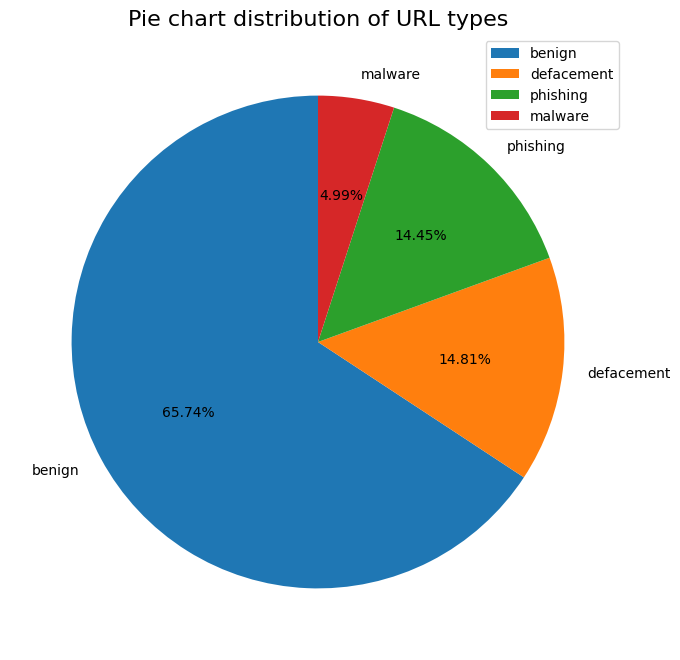

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load dataset

# Hitung distribusi semua label
label_counts = df['type'].value_counts()

# Plot pie chart
plt.figure(figsize=(8, 8))
plt.pie(label_counts, labels=label_counts.index, autopct='%0.2f%%', startangle=90)
plt.title("Pie chart distribution of URL types", fontsize=16)
plt.legend()
plt.savefig('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/plot/Pie_chart_all_classes.png')
plt.show()


In [ ]:
# Inisialisasi tokenizer BERT
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")

# Memastikan kolom URL ada dalam dataset
if 'url' not in df.columns:
    raise ValueError("Dataset tidak memiliki kolom 'url'")

# Ambil semua URL
urls = df['url'].tolist()

# Hitung panjang token untuk setiap URL
url_lengths = [len(tokenizer.encode(url, truncation=False, padding=False)) for url in urls]

Token indices sequence length is longer than the specified maximum sequence length for this model (812 > 512). Running this sequence through the model will result in indexing errors


Jumlah URL dengan panjang di atas persentil ke-95: 31196
Persentase URL di atas persentil ke-95: 4.79%
Contoh URL terpanjang (token: 1187): https://asana.com/guide/videos/%22//fast.wistia.net/embed/iframe/nfi3dx4h43?plugin%5Bchapters%5D%5Bch_1_title%5D=Intro%3A%20Workspace%20or%20Organization%3F&plugin%5Bchapters%5D%5Bch_1_time%5D=15&plugin%5Bchapters%5D%5Bch_2_title%5D=My%20Tasks%20and%20Inbox&plugin%5Bchapters%5D%5Bch_2_time%5D=63&plugin%5Bchapters%5D%5Bch_3_title%5D=Today%2C%20Upcoming%2C%20and%20Later&plugin%5Bchapters%5D%5Bch_3_time%5D=96&plugin%5Bchapters%5D%5Bch_4_title%5D=Inbox&plugin%5Bchapters%5D%5Bch_4_time%5D=112&plugin%5Bchapters%5D%5Bch_5_title%5D=Turn%20off%20activity%20Emails&plugin%5Bchapters%5D%5Bch_5_time%5D=145&plugin%5Bchapters%5D%5Bch_6_title%5D=Hierarchy%20in%20Asana&plugin%5Bchapters%5D%5Bch_6_time%5D=165&plugin%5Bchapters%5D%5Bch_7_title%5D=Sections&plugin%5Bchapters%5D%5Bch_7_time%5D=220&plugin%5Bchapters%5D%5Bch_8_title%5D=Account%20Settings&plugin%5Bchapters

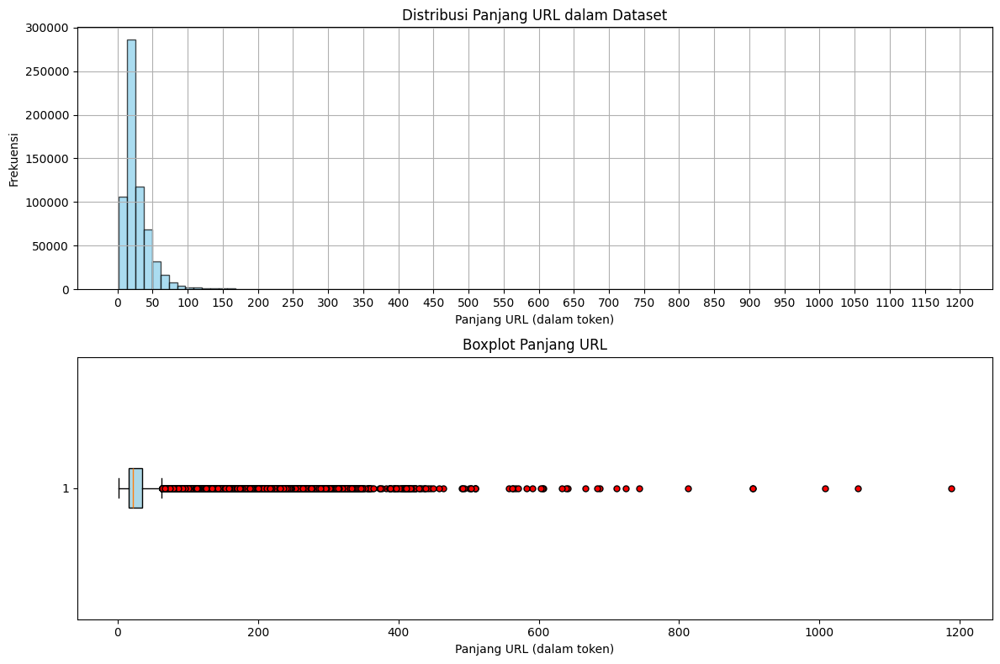

In [ ]:
# Menampilkan statistik deskriptif
mean_length = np.mean(url_lengths)
max_length = np.max(url_lengths)
min_length = np.min(url_lengths)
std_dev = np.std(url_lengths)
median_length = np.median(url_lengths)
q1 = np.percentile(url_lengths, 25)
q3 = np.percentile(url_lengths, 75)
percentile_90 = np.percentile(url_lengths, 90)
percentile_95 = np.percentile(url_lengths, 95)

# Menghitung jumlah dan persentase URL yang berada di luar persentil ke-95%
outliers_above_95 = sum(length > percentile_95 for length in url_lengths)
outliers_percentage = (outliers_above_95 / len(url_lengths)) * 100

# Menemukan URL dengan panjang maksimum
longest_url = urls[np.argmax(url_lengths)]

print(f"Jumlah URL dengan panjang di atas persentil ke-95: {outliers_above_95}")
print(f"Persentase URL di atas persentil ke-95: {outliers_percentage:.2f}%")
print(f"Contoh URL terpanjang (token: {max_length}): {longest_url}")

print("Panjang rata-rata URL (token):", mean_length)
print("Panjang maksimum URL (token):", max_length)
print("Panjang minimum URL (token):", min_length)
print("Panjang median URL (token):", median_length)
print("Standar deviasi panjang URL (token):", std_dev)
print("Kuartil pertama (25%):", q1)
print("Kuartil ketiga (75%):", q3)
print("Persentil ke-90 panjang URL (token):", percentile_90)
print("Persentil ke-95 panjang URL (token):", percentile_95)
print(f"Jumlah URL dengan panjang di atas persentil ke-95: {outliers_above_95}")

# Plot distribusi panjang URL
plt.figure(figsize=(12, 8))

# Histogram
plt.subplot(2, 1, 1)
plt.hist(url_lengths, bins=100, color='skyblue', edgecolor='black', alpha=0.7)
plt.title('Distribusi Panjang URL dalam Dataset')
plt.xlabel('Panjang URL (dalam token)')
plt.ylabel('Frekuensi')
plt.grid(True)

# Menyesuaikan axis X dengan interval yang lebih rinci
plt.xticks(np.arange(0, max_length + 50, 50))  # Menyesuaikan interval sesuai rentang panjang URL

# Boxplot untuk distribusi yang lebih jelas
plt.subplot(2, 1, 2)
plt.boxplot(url_lengths, vert=False, patch_artist=True,
            boxprops=dict(facecolor='lightblue', color='black'),
            whiskerprops=dict(color='black'),
            flierprops=dict(markerfacecolor='red', marker='o', markersize=5))
plt.title('Boxplot Panjang URL')
plt.xlabel('Panjang URL (dalam token)')

plt.tight_layout()
plt.show()

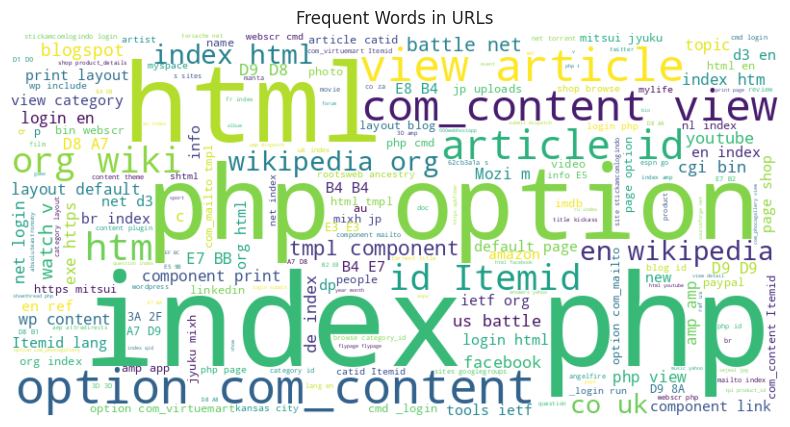

In [ ]:
from wordcloud import WordCloud

# 3. Frekuensi Kata Penting
# Gabungkan semua URL dalam satu string
urls_text = ' '.join(df['url'])

# Generate word cloud dari kata-kata umum dalam URL
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(urls_text)

# Visualisasi word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Frequent Words in URLs")
plt.savefig('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/result/Frequent_word_in_URL.png')
plt.show()



<ipython-input-12-de37b1c9b2d6>:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_domains.values, y=top_domains.index, palette='viridis')


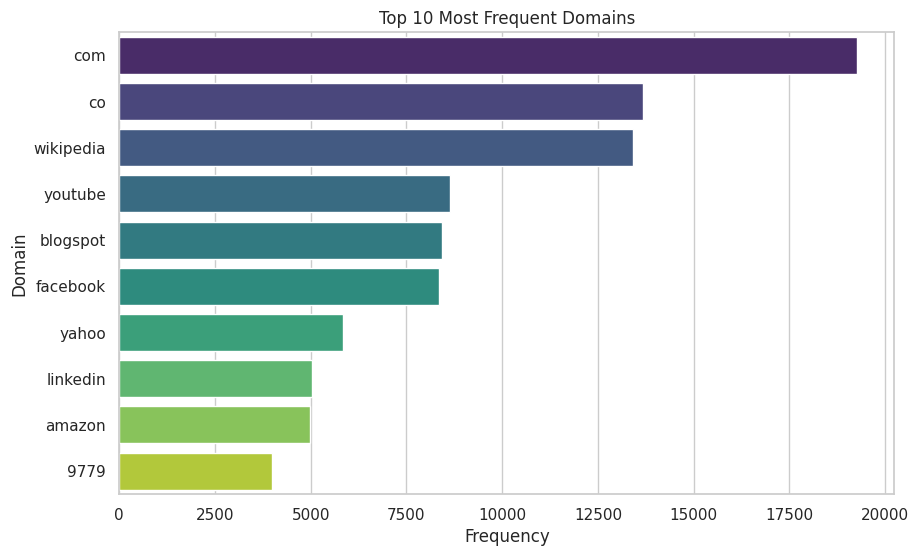

In [ ]:
# Ekstraksi domain utama dari URL dengan penanganan error
def extract_domain(url):
    try:
        # Mengambil bagian domain dari URL
        parts = url.split('//')[-1].split('/')[0].split('.')
        if len(parts) >= 2:
            return parts[-2]
        else:
            return parts[0]  # Jika hanya ada satu bagian, gunakan itu
    except IndexError:
        return None  # Kembalikan None jika terjadi error

# Terapkan fungsi pada kolom URL untuk mendapatkan domain utama
data['domain'] = data['url'].apply(extract_domain)

# Visualisasikan 10 domain yang paling sering muncul
top_domains = data['domain'].value_counts().head(10)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_domains.values, y=top_domains.index, palette='viridis')
plt.title("Top 10 Most Frequent Domains")
plt.xlabel("Frequency")
plt.ylabel("Domain")
plt.savefig('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/plot/10_Most_Frequent_Domains.png')
plt.show()


# Preprocessing

Jumlah data filtered: 522214
Jumlah data per kelas setelah filtering:
type
benign      428103
phishing     94111
Name: count, dtype: int64


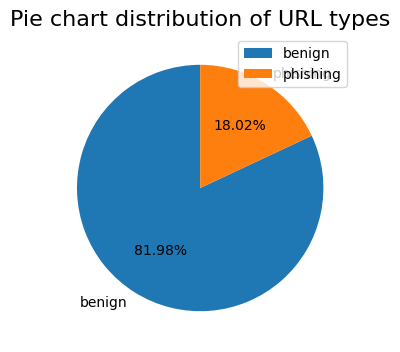

In [ ]:
# Filter the data to keep only benign and phishing types
df_clean = df[df['type'].isin(['benign', 'phishing'])]
print("Jumlah data filtered:", len(df_clean))

# data_filtered = data_filtered.sample(frac=0.5, random_state=42).reset_index(drop=True)
# print("Jumlah data trim:", len(data_filtered))

# Hitung distribusi semua label
label_counts = df_clean['type'].value_counts()

print("Jumlah data per kelas setelah filtering:")
print(label_counts)

# Plot pie chart
plt.figure(figsize=(4, 4))
plt.pie(label_counts, labels=label_counts.index, autopct='%0.2f%%', startangle=90)
plt.title("Pie chart distribution of URL types", fontsize=16)
plt.legend()
plt.savefig('/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/plot/Pie_chart_filter.png')
plt.show()

In [ ]:
# Inisialisasi tokenizer BERT
tokenizer = BertTokenizer.from_pretrained("bert-base-uncased")

# Memastikan kolom URL ada dalam dataset
if 'url' not in df_clean.columns:
    raise ValueError("Dataset tidak memiliki kolom 'url'")

# Ambil semua URL
urls_dfclean = df_clean['url'].tolist()

# Hitung panjang token untuk setiap URL
url_lengths_dfclean = [len(tokenizer.encode(url, truncation=False, padding=False)) for url in urls_dfclean]

Token indices sequence length is longer than the specified maximum sequence length for this model (812 > 512). Running this sequence through the model will result in indexing errors


In [ ]:
# Menampilkan statistik deskriptif
mean_length_dfclean = np.mean(url_lengths_dfclean)
max_length_dfclean = np.max(url_lengths_dfclean)
min_length_dfclean = np.min(url_lengths_dfclean)
std_dev_dfclean = np.std(url_lengths_dfclean)
median_length_dfclean = np.median(url_lengths_dfclean)
q1_dfclean = np.percentile(url_lengths_dfclean, 25)
q3_dfclean = np.percentile(url_lengths_dfclean, 75)
percentile_90_dfclean = np.percentile(url_lengths_dfclean, 90)
percentile_95_dfclean = np.percentile(url_lengths_dfclean, 95)

# Menghitung jumlah dan persentase URL yang berada di luar persentil ke-95%
outliers_above_95_dfclean = sum(length > percentile_95_dfclean for length in url_lengths_dfclean)
outliers_percentage_dfclean = (outliers_above_95_dfclean / len(url_lengths_dfclean)) * 100

# Menemukan URL dengan panjang maksimum
longest_url_dfclean = urls[np.argmax(url_lengths_dfclean)]

# Filter data di luar persentil ke-95
df_outliers_dfclean = df_clean[url_lengths_dfclean > percentile_95_dfclean]
benign_count_outliers = sum(df_outliers_dfclean['type'] == 'benign')
phishing_count_outliers = sum(df_outliers_dfclean['type'] == 'phishing')

Jumlah URL dengan panjang di atas persentil ke-95: 26074
Persentase URL di atas persentil ke-95: 4.99%
Contoh URL terpanjang (token: 1187): sports.espn.go.com/ncb/player/photo?playerId=35801
Jumlah benign di atas persentil ke-95: 21528
Jumlah phishing di atas persentil ke-95: 4546


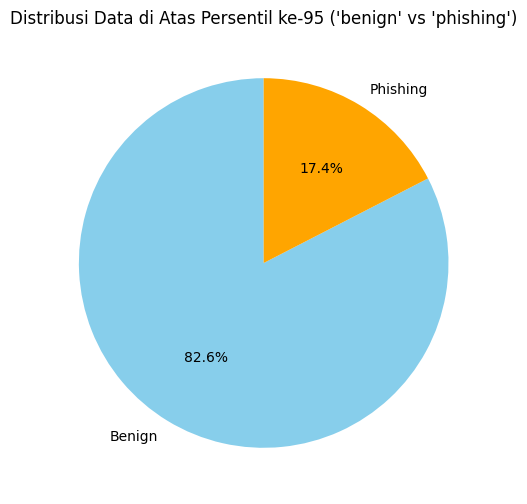

Panjang rata-rata URL (token): 26.567792131195258
Panjang maksimum URL (token): 1187
Panjang minimum URL (token): 2
Panjang median URL (token): 20.0
Standar deviasi panjang URL (token): 25.215176708562016
Kuartil pertama (25%): 14.0
Kuartil ketiga (75%): 29.0
Persentil ke-90 panjang URL (token): 47.0
Persentil ke-95 panjang URL (token): 62.0


In [ ]:

# Informasi tambahan
print(f"Jumlah URL dengan panjang di atas persentil ke-95: {outliers_above_95_dfclean}")
print(f"Persentase URL di atas persentil ke-95: {outliers_percentage_dfclean:.2f}%")
print(f"Contoh URL terpanjang (token: {max_length_dfclean}): {longest_url_dfclean}")
print(f"Jumlah benign di atas persentil ke-95: {benign_count_outliers}")
print(f"Jumlah phishing di atas persentil ke-95: {phishing_count_outliers}")

# Pie chart untuk distribusi data di luar persentil ke-95
plt.figure(figsize=(8, 6))
plt.pie(
    [benign_count_outliers, phishing_count_outliers],
    labels=['Benign', 'Phishing'],
    autopct='%1.1f%%',
    colors=['skyblue', 'orange'],
    startangle=90
)
plt.title("Distribusi Data di Atas Persentil ke-95 ('benign' vs 'phishing')")
plt.show()

# Menampilkan statistik deskriptif
print("Panjang rata-rata URL (token):", mean_length_dfclean)
print("Panjang maksimum URL (token):", max_length_dfclean)
print("Panjang minimum URL (token):", min_length_dfclean)
print("Panjang median URL (token):", median_length_dfclean)
print("Standar deviasi panjang URL (token):", std_dev_dfclean)
print("Kuartil pertama (25%):", q1_dfclean)
print("Kuartil ketiga (75%):", q3_dfclean)
print("Persentil ke-90 panjang URL (token):", percentile_90_dfclean)
print("Persentil ke-95 panjang URL (token):", percentile_95_dfclean)


Filtering URLs:   0%|          | 0/105 [00:00<?, ?it/s]

Jumlah data per kelas setelah filtering (panjang URL <= 64):
type
benign      407955
phishing     89854
Name: count, dtype: int64


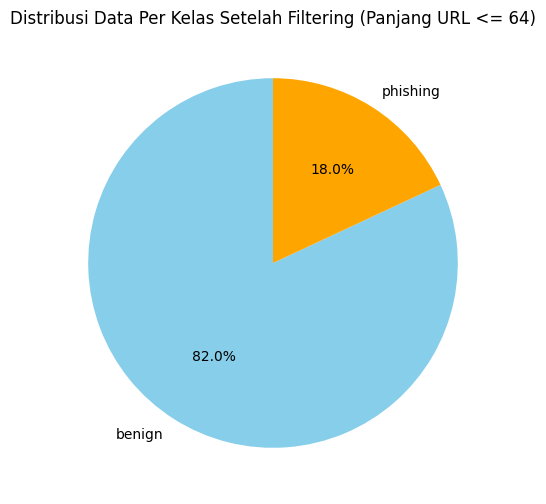

In [ ]:
# # Filter df_clean untuk URL dengan panjang token <= 64
# df_clean = df_clean[[len(tokenizer.encode(url, truncation=False, padding=False)) <= 64 for url in df_clean['url']]]

from concurrent.futures import ProcessPoolExecutor

# Fungsi untuk memfilter URL berdasarkan panjang token
def filter_urls_batch(urls):
    return [len(tokenizer.encode(url, truncation=False, padding=False)) <= 64 for url in urls]

# Mengatur jumlah batch
batch_size = 5000  # Sesuaikan ukuran batch untuk keseimbangan antara memori dan kecepatan
url_batches = [df_clean['url'][i:i + batch_size] for i in range(0, len(df_clean), batch_size)]

# Progress bar dan multiprocessing untuk mempercepat
results = []
with ProcessPoolExecutor() as executor:
    with tqdm(total=len(url_batches), desc="Filtering URLs") as pbar:
        for result in executor.map(filter_urls_batch, url_batches):
            results.extend(result)
            pbar.update(1)

# Filter data berdasarkan hasil
df_clean = df_clean[results]

# Hitung jumlah data per kelas setelah filtering
label_counts = df_clean['type'].value_counts()
print("Jumlah data per kelas setelah filtering (panjang URL <= 64):")
print(label_counts)

# Visualisasi distribusi kelas dengan pie chart
plt.figure(figsize=(8, 6))
label_counts.plot.pie(autopct='%1.1f%%', startangle=90, colors=['skyblue', 'orange'], labels=label_counts.index)
plt.title("Distribusi Data Per Kelas Setelah Filtering (Panjang URL <= 64)")
plt.ylabel("")  # Menghilangkan label pada sumbu Y
plt.show()


In [ ]:
print("Jumlah data asli:", len(df_clean))
print(df_clean.head(5))

Jumlah data asli: 497809
                                                 url      type
0                                   br-icloud.com.br  phishing
1                mp3raid.com/music/krizz_kaliko.html    benign
2                    bopsecrets.org/rexroth/cr/1.htm    benign
5  http://buzzfil.net/m/show-art/ils-etaient-loin...    benign
6      espn.go.com/nba/player/_/id/3457/brandon-rush    benign


In [ ]:
# Tentukan path untuk menyimpan file CSV
output_path = '/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/dataset/malicious_phish_cleaned.csv'

# Simpan df_clean ke CSV
df_clean.to_csv(output_path, index=False)

print(f"File df_clean telah disimpan di: {output_path}")

File df_clean telah disimpan di: /content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/dataset/malicious_phish_cleaned.csv


# **DATA SPLITTING**

type
benign      407955
phishing     89854
Name: count, dtype: int64
                                                 url      type
0                                   br-icloud.com.br  phishing
1                mp3raid.com/music/krizz_kaliko.html    benign
2                    bopsecrets.org/rexroth/cr/1.htm    benign
3  http://buzzfil.net/m/show-art/ils-etaient-loin...    benign
4      espn.go.com/nba/player/_/id/3457/brandon-rush    benign
Jumlah data per kelas setelah mengambil 50% sampel:
type
benign      122293
phishing     27050
Name: count, dtype: int64


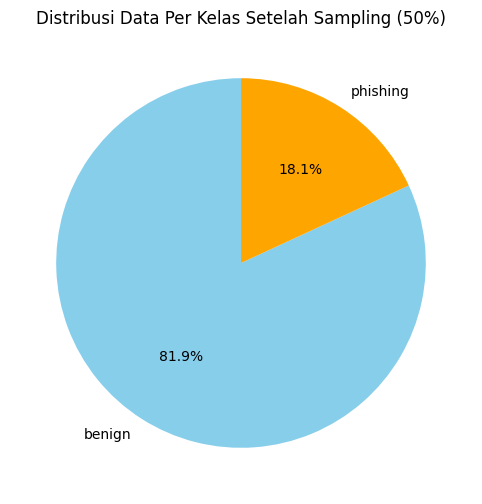

Ukuran set pelatihan: 104540
Ukuran set pengujian: 44803


In [ ]:
# Tentukan path untuk mengimpor file CSV
input_path = '/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/dataset/malicious_phish_cleaned.csv'

# Mengimpor df_clean dari file CSV
df_clean_import = pd.read_csv(input_path)

# Menampilkan jumlah data per kelas setelah sampling
label_counts_import = df_clean_import['type'].value_counts()
print(label_counts_import)

# Menampilkan 5 baris pertama untuk memastikan data terimpor dengan benar
print(df_clean_import.head())

# Lanjutkan dengan mengambil sampel data
data_filtered = df_clean_import.sample(frac=0.3, random_state=42).reset_index(drop=True)

# Menampilkan jumlah data per kelas setelah sampling
label_counts = data_filtered['type'].value_counts()
print("Jumlah data per kelas setelah mengambil 50% sampel:")
print(label_counts)

# Visualisasi distribusi kelas dengan pie chart
plt.figure(figsize=(8, 6))
label_counts.plot.pie(autopct='%1.1f%%', startangle=90, colors=['skyblue', 'orange'], labels=label_counts.index)
plt.title("Distribusi Data Per Kelas Setelah Sampling (50%)")
plt.ylabel("")  # Menghilangkan label pada sumbu Y
plt.show()


# Define features and labels
X_multi = data_filtered['url']  # Fitur: URL
y_multi = data_filtered['type'].map({'benign': 0, 'phishing': 1})  # Mengonversi label ke numerik


# Membagi data menjadi set pelatihan (70%) dan set pengujian (30%)
X_train_bin, X_test_bin, y_train_bin, y_test_bin = train_test_split(X_multi, y_multi, test_size=0.3, random_state=42)

# Menampilkan informasi tentang ukuran set
print(f'Ukuran set pelatihan: {X_train_bin.shape[0]}')
print(f'Ukuran set pengujian: {X_test_bin.shape[0]}')



# **Fine Tuning Hyperparameter**

In [ ]:
# Suppress warnings and set logging
logging.basicConfig(level=logging.ERROR)
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", module="torch.utils.data.dataloader")
sys.stderr = open(os.devnull, 'w')

# Hyperparameter grid
param_grid = {
    'lr': [2e-4],
    'batch_size': [64],
    'dim_feedforward': [1024],
    'num_attention_heads': [8],
    'num_layers': [6]
}

# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
k_folds = 3
num_epochs = 3
num_workers = 4
patience = 3  # Early stopping patience
scaler = torch.cuda.amp.GradScaler()

# Custom Transformer-based model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output

# Tokenizer function
def tokenize_data(texts, tokenizer, max_length=64):
    encodings = tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )
    return encodings

# Early Stopping Class
class EarlyStopping:
    def __init__(self, patience=3, verbose=False, delta=0):
        self.patience = patience
        self.verbose = verbose
        self.delta = delta
        self.best_score = None
        self.counter = 0
        self.early_stop = False
        self.best_model = None

    def __call__(self, score, model):
        if self.best_score is None:
            self.best_score = score
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.verbose:
                print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.counter = 0
            self.best_model = model

# Train and evaluate function
def train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels, batch_size, lr, nhead, dim_feedforward, num_layers):
    model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels, nhead=nhead, dim_feedforward=dim_feedforward, num_layers=num_layers).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0.01)
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2, verbose=True)

    early_stopping = EarlyStopping(patience=patience, verbose=True)

    best_recall = 0
    best_accuracy = 0
    best_f1_score = 0
    best_auc_roc = 0
    best_model_path = None
    fold_metrics = []

    y_val_np = y_val.values if hasattr(y_val, 'values') else np.array(y_val)

    for epoch in tqdm(range(num_epochs), desc=f'Fold {fold} - Epoch', leave=False):
        model.train()
        total_train_loss = 0

        with tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{num_epochs}", leave=False) as t_train:
            for batch in t_train:
                optimizer.zero_grad()
                input_ids, attention_mask, labels = [b.to(device) for b in batch]
                with torch.cuda.amp.autocast():
                    outputs = model(input_ids, attention_mask)
                    loss = criterion(outputs, labels)
                scaler.scale(loss).backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                scaler.step(optimizer)
                scaler.update()
                total_train_loss += loss.item()
                t_train.set_postfix({"Train Loss": loss.item()})

        avg_train_loss = total_train_loss / len(train_loader)

        # Validation phase
        model.eval()
        val_predictions = []
        val_probs = []
        total_val_loss = 0

        with tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}", leave=False) as t_val:
            with torch.no_grad():
                for batch in t_val:
                    input_ids, attention_mask, labels = [b.to(device) for b in batch]
                    with torch.cuda.amp.autocast():
                        outputs = model(input_ids, attention_mask)
                        loss = criterion(outputs, labels)
                    total_val_loss += loss.item()
                    batch_probs = torch.softmax(outputs, dim=1)
                    batch_predictions = torch.argmax(outputs, dim=1)
                    val_predictions.extend(batch_predictions.cpu().numpy())
                    val_probs.extend(batch_probs.cpu().numpy())
                    t_val.set_postfix({"Val Loss": loss.item()})

        avg_val_loss = total_val_loss / len(val_loader)

        # Calculate metrics
        val_predictions_np = np.array(val_predictions)
        val_probs_np = np.array(val_probs)

        accuracy = accuracy_score(y_val_np, val_predictions_np)
        recall = recall_score(y_val_np, val_predictions_np, average='weighted')
        precision = precision_score(y_val_np, val_predictions_np, average='weighted')
        f1 = f1_score(y_val_np, val_predictions_np, average='weighted')

        y_val_onehot = F.one_hot(torch.LongTensor(y_val_np), num_classes=num_labels).numpy()

        try:
            auc_roc = roc_auc_score(y_val_onehot, val_probs_np, multi_class='ovr')
        except ValueError:
            auc_roc = 0

        print(f"Fold {fold}, Epoch {epoch + 1} - Avg train loss: {avg_train_loss:.4f}, Val loss: {avg_val_loss:.4f}, "
              f"Accuracy: {accuracy * 100:.2f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1: {f1:.4f}, AUC-ROC: {auc_roc:.4f}")

        fold_metrics.append({
            'epoch': epoch + 1,
            'train_loss': avg_train_loss,
            'val_loss': avg_val_loss,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1_score': f1,
            'auc_roc': auc_roc
        })

        # Update best metrics based on recall first, followed by accuracy, F1, and AUC-ROC
        if (recall > best_recall or
            (recall == best_recall and accuracy > best_accuracy) or
            (recall == best_recall and accuracy == best_accuracy and f1 > best_f1_score) or
            (recall == best_recall and accuracy == best_accuracy and f1 == best_f1_score and auc_roc > best_auc_roc)):
            best_recall = recall
            best_accuracy = accuracy
            best_f1_score = f1
            best_auc_roc = auc_roc
            best_model_path = f'best_model_fold_{fold}.pth'
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model for fold {fold} at epoch {epoch + 1}.")

        # Early stopping based on recall
        early_stopping(recall, model)
        if early_stopping.early_stop:
            print("Early stopping triggered")
            break

        # Scheduler step
        scheduler.step(avg_val_loss)

    return fold_metrics, best_model_path, avg_val_loss, best_recall, best_accuracy, best_f1_score, best_auc_roc



# Main function for grid search
def main():
    # Initialize data
    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)
    input_dim = 30522  # Vocabulary size for tokenizer
    num_labels = len(y_train_bin.unique())

    best_hyperparameters = None
    best_val_loss = float('inf')
    best_recall = 0
    best_accuracy = 0
    best_f1_score = 0
    best_auc_roc = 0

    # Grid search over hyperparameters
    for params in tqdm(ParameterGrid(param_grid), desc="Hyperparameter Search"):
        print(f"\nEvaluating params: {params}")

        all_fold_metrics = []

        for fold, (train_index, val_index) in enumerate(kf.split(X_train_bin), 1):
            print(f"\n=== Fold {fold}/{k_folds} ===")
            X_train, X_val = X_train_bin.iloc[train_index], X_train_bin.iloc[val_index]
            y_train, y_val = y_train_bin.iloc[train_index], y_train_bin.iloc[val_index]

            tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
            train_encodings = tokenize_data(list(X_train), tokenizer)
            val_encodings = tokenize_data(list(X_val), tokenizer)

            y_train_tensor = torch.LongTensor(y_train.values)
            y_val_tensor = torch.LongTensor(y_val.values)

            train_dataset = TensorDataset(train_encodings['input_ids'], train_encodings['attention_mask'], y_train_tensor)
            val_dataset = TensorDataset(val_encodings['input_ids'], val_encodings['attention_mask'], y_val_tensor)

            train_loader = DataLoader(train_dataset, batch_size=params['batch_size'], shuffle=True, pin_memory=True, num_workers=num_workers, persistent_workers=True)
            val_loader = DataLoader(val_dataset, batch_size=params['batch_size'], shuffle=False, pin_memory=True, num_workers=num_workers, persistent_workers=True)

            # Train and evaluate for the current fold
            fold_metrics, best_model_path, fold_val_loss, fold_recall, fold_accuracy, fold_f1_score, fold_auc_roc = train_and_evaluate(
                fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels,
                params['batch_size'], params['lr'], params['num_attention_heads'], params['dim_feedforward'], params['num_layers']
            )

            # Append fold metrics
            all_fold_metrics.append(fold_metrics)

            # Check if this set of hyperparameters is better than previous
            if (fold_recall > best_recall or
                (fold_recall == best_recall and fold_accuracy > best_accuracy) or
                (fold_recall == best_recall and fold_accuracy == best_accuracy and fold_f1_score > best_f1_score) or
                (fold_recall == best_recall and fold_accuracy == best_accuracy and fold_f1_score == best_f1_score and fold_auc_roc > best_auc_roc)):
                best_recall = fold_recall
                best_accuracy = fold_accuracy
                best_f1_score = fold_f1_score
                best_auc_roc = fold_auc_roc
                best_val_loss = fold_val_loss
                best_hyperparameters = params

        # Print the best parameters and metrics
        print(f"\nBest parameters: {best_hyperparameters}")
        print(f"Best validation loss: {best_val_loss:.4f}")
        print(f"Best Recall: {best_recall:.4f} | Best Accuracy: {best_accuracy:.4f} | "
              f"Best F1 Score: {best_f1_score:.4f} | Best AUC-ROC: {best_auc_roc:.4f}")



if __name__ == "__main__":
    main()


Hyperparameter Search:   0%|          | 0/1 [00:00<?, ?it/s]


Evaluating params: {'batch_size': 64, 'dim_feedforward': 1024, 'lr': 0.0002, 'num_attention_heads': 8, 'num_layers': 6}

=== Fold 1/3 ===


Fold 1 - Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Training Epoch 1/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 1/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 1, Epoch 1 - Avg train loss: 0.6315, Val loss: 0.5004, Accuracy: 80.72, Precision: 0.7106, Recall: 0.8072, F1: 0.7377, AUC-ROC: 0.5659
Saved best model for fold 1 at epoch 1.


Training Epoch 2/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 2/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 1, Epoch 2 - Avg train loss: 0.4686, Val loss: 0.4463, Accuracy: 81.67, Precision: 0.6683, Recall: 0.8167, F1: 0.7351, AUC-ROC: 0.6853
Saved best model for fold 1 at epoch 2.


Training Epoch 3/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 3/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 1, Epoch 3 - Avg train loss: 0.4215, Val loss: 0.4115, Accuracy: 81.84, Precision: 0.7793, Recall: 0.8184, F1: 0.7407, AUC-ROC: 0.7700
Saved best model for fold 1 at epoch 3.

=== Fold 2/3 ===


Fold 2 - Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Training Epoch 1/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 1/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 2, Epoch 1 - Avg train loss: 0.6109, Val loss: 0.4735, Accuracy: 84.07, Precision: 0.7080, Recall: 0.8407, F1: 0.7687, AUC-ROC: 0.5020
Saved best model for fold 2 at epoch 1.


Training Epoch 2/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 2/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 2, Epoch 2 - Avg train loss: 0.4822, Val loss: 0.4300, Accuracy: 84.07, Precision: 0.7080, Recall: 0.8407, F1: 0.7687, AUC-ROC: 0.6742
Saved best model for fold 2 at epoch 2.


Training Epoch 3/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 3/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 2, Epoch 3 - Avg train loss: 0.4447, Val loss: 0.4037, Accuracy: 83.98, Precision: 0.7788, Recall: 0.8398, F1: 0.7774, AUC-ROC: 0.7455
EarlyStopping counter: 1 out of 3

=== Fold 3/3 ===


Fold 3 - Epoch:   0%|          | 0/3 [00:00<?, ?it/s]

Training Epoch 1/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 1/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 3, Epoch 1 - Avg train loss: 0.9218, Val loss: 0.6416, Accuracy: 63.22, Precision: 0.6445, Recall: 0.6322, F1: 0.6383, AUC-ROC: 0.4121
Saved best model for fold 3 at epoch 1.


Training Epoch 2/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 2/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 3, Epoch 2 - Avg train loss: 0.5173, Val loss: 0.4997, Accuracy: 80.45, Precision: 0.6472, Recall: 0.8045, F1: 0.7173, AUC-ROC: 0.5717
Saved best model for fold 3 at epoch 2.


Training Epoch 3/3:   0%|          | 0/37 [00:00<?, ?it/s]

Validation Epoch 3/3:   0%|          | 0/19 [00:00<?, ?it/s]

Fold 3, Epoch 3 - Avg train loss: 0.4314, Val loss: 0.4251, Accuracy: 80.96, Precision: 0.8078, Recall: 0.8096, F1: 0.7324, AUC-ROC: 0.7594
Saved best model for fold 3 at epoch 3.

Best parameters: {'batch_size': 64, 'dim_feedforward': 1024, 'lr': 0.0002, 'num_attention_heads': 8, 'num_layers': 6}
Best validation loss: 0.4037
Best Recall: 0.8407 | Best Accuracy: 0.8407 | Best F1 Score: 0.7687 | Best AUC-ROC: 0.6742


In [ ]:
pip install torch --upgrade


# Run first (for confusion matrix)


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Fungsi untuk menampilkan confusion matrix dengan heatmap
def plot_confusion_matrix(conf_matrix, labels, fold):
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='g', cmap='Blues', xticklabels=labels, yticklabels=labels, cbar=False)
    plt.title(f'Confusion Matrix - Fold {fold}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

#2. DATA DEFAULT (IMBALANCE)



## **CLASSIFICATION Non-Tuning**


=== Fold 1/10 ===


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

Fold 1 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4949, Train Accuracy = 75.17%, Val Loss = 0.3641, Val Accuracy = 83.90%, F1 Score = 0.8075, Precision = 0.8193, Recall = 0.8390, AUC-ROC = 0.8339, Epoch Time = 60.55 seconds
Saved best model for fold 1 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3279, Train Accuracy = 86.02%, Val Loss = 0.2828, Val Accuracy = 88.38%, F1 Score = 0.8733, Precision = 0.8769, Recall = 0.8838, AUC-ROC = 0.9079, Epoch Time = 59.95 seconds
Saved best model for fold 1 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2642, Train Accuracy = 89.67%, Val Loss = 0.2379, Val Accuracy = 91.35%, F1 Score = 0.9097, Precision = 0.9101, Recall = 0.9135, AUC-ROC = 0.9315, Epoch Time = 60.34 seconds
Saved best model for fold 1 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2359, Train Accuracy = 91.40%, Val Loss = 0.2213, Val Accuracy = 92.17%, F1 Score = 0.9185, Precision = 0.9190, Recall = 0.9217, AUC-ROC = 0.9388, Epoch Time = 59.47 seconds
Saved best model for fold 1 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2202, Train Accuracy = 92.14%, Val Loss = 0.2099, Val Accuracy = 92.74%, F1 Score = 0.9250, Precision = 0.9251, Recall = 0.9274, AUC-ROC = 0.9436, Epoch Time = 59.70 seconds
Saved best model for fold 1 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2101, Train Accuracy = 92.62%, Val Loss = 0.2038, Val Accuracy = 92.93%, F1 Score = 0.9273, Precision = 0.9272, Recall = 0.9293, AUC-ROC = 0.9463, Epoch Time = 59.80 seconds
Saved best model for fold 1 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2035, Train Accuracy = 92.86%, Val Loss = 0.1981, Val Accuracy = 93.18%, F1 Score = 0.9295, Precision = 0.9298, Recall = 0.9318, AUC-ROC = 0.9489, Epoch Time = 59.79 seconds
Saved best model for fold 1 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1978, Train Accuracy = 93.09%, Val Loss = 0.1939, Val Accuracy = 93.31%, F1 Score = 0.9319, Precision = 0.9315, Recall = 0.9331, AUC-ROC = 0.9512, Epoch Time = 60.28 seconds
Saved best model for fold 1 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1921, Train Accuracy = 93.23%, Val Loss = 0.1902, Val Accuracy = 93.52%, F1 Score = 0.9337, Precision = 0.9335, Recall = 0.9352, AUC-ROC = 0.9525, Epoch Time = 59.17 seconds
Saved best model for fold 1 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1889, Train Accuracy = 93.36%, Val Loss = 0.1884, Val Accuracy = 93.57%, F1 Score = 0.9341, Precision = 0.9340, Recall = 0.9357, AUC-ROC = 0.9533, Epoch Time = 60.22 seconds
Saved best model for fold 1 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1874, Train Accuracy = 93.40%, Val Loss = 0.1871, Val Accuracy = 93.72%, F1 Score = 0.9358, Precision = 0.9356, Recall = 0.9372, AUC-ROC = 0.9541, Epoch Time = 60.77 seconds
Saved best model for fold 1 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1855, Train Accuracy = 93.44%, Val Loss = 0.1857, Val Accuracy = 93.73%, F1 Score = 0.9360, Precision = 0.9358, Recall = 0.9373, AUC-ROC = 0.9547, Epoch Time = 59.47 seconds
Saved best model for fold 1 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1837, Train Accuracy = 93.49%, Val Loss = 0.1845, Val Accuracy = 93.73%, F1 Score = 0.9360, Precision = 0.9358, Recall = 0.9373, AUC-ROC = 0.9552, Epoch Time = 58.67 seconds
Saved best model for fold 1 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1825, Train Accuracy = 93.50%, Val Loss = 0.1831, Val Accuracy = 93.87%, F1 Score = 0.9375, Precision = 0.9372, Recall = 0.9387, AUC-ROC = 0.9559, Epoch Time = 59.37 seconds
Saved best model for fold 1 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1808, Train Accuracy = 93.57%, Val Loss = 0.1821, Val Accuracy = 93.77%, F1 Score = 0.9363, Precision = 0.9361, Recall = 0.9377, AUC-ROC = 0.9562, Epoch Time = 59.32 seconds
Saved best model for fold 1 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1795, Train Accuracy = 93.65%, Val Loss = 0.1810, Val Accuracy = 93.91%, F1 Score = 0.9380, Precision = 0.9377, Recall = 0.9391, AUC-ROC = 0.9570, Epoch Time = 58.96 seconds
Saved best model for fold 1 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1776, Train Accuracy = 93.72%, Val Loss = 0.1778, Val Accuracy = 94.02%, F1 Score = 0.9391, Precision = 0.9388, Recall = 0.9402, AUC-ROC = 0.9583, Epoch Time = 59.02 seconds
Saved best model for fold 1 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1734, Train Accuracy = 93.85%, Val Loss = 0.1748, Val Accuracy = 93.93%, F1 Score = 0.9385, Precision = 0.9381, Recall = 0.9393, AUC-ROC = 0.9601, Epoch Time = 58.55 seconds
Saved best model for fold 1 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1705, Train Accuracy = 93.96%, Val Loss = 0.1717, Val Accuracy = 94.04%, F1 Score = 0.9394, Precision = 0.9391, Recall = 0.9404, AUC-ROC = 0.9611, Epoch Time = 59.61 seconds
Saved best model for fold 1 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1675, Train Accuracy = 94.06%, Val Loss = 0.1716, Val Accuracy = 94.03%, F1 Score = 0.9395, Precision = 0.9392, Recall = 0.9403, AUC-ROC = 0.9614, Epoch Time = 58.49 seconds
Saved best model for fold 1 based on recall at epoch 20.

Total training time for Fold 1: 1191.50 seconds

Confusion Matrix for Fold 1:


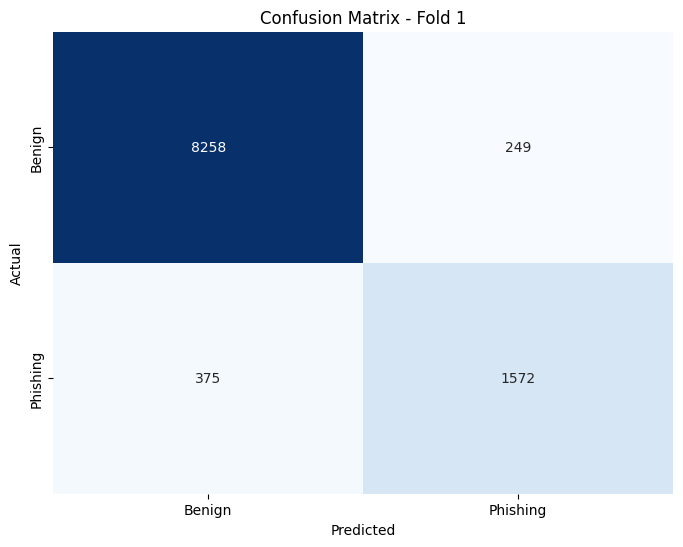


Confusion Matrix for Fold 1:
[[8258  249]
 [ 375 1572]]

=== Fold 2/10 ===


Fold 2 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4531, Train Accuracy = 78.66%, Val Loss = 0.3440, Val Accuracy = 84.81%, F1 Score = 0.8232, Precision = 0.8301, Recall = 0.8481, AUC-ROC = 0.8556, Epoch Time = 59.21 seconds
Saved best model for fold 2 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3128, Train Accuracy = 86.75%, Val Loss = 0.2741, Val Accuracy = 89.05%, F1 Score = 0.8832, Precision = 0.8837, Recall = 0.8905, AUC-ROC = 0.9130, Epoch Time = 59.19 seconds
Saved best model for fold 2 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2587, Train Accuracy = 89.95%, Val Loss = 0.2389, Val Accuracy = 91.07%, F1 Score = 0.9065, Precision = 0.9067, Recall = 0.9107, AUC-ROC = 0.9322, Epoch Time = 59.10 seconds
Saved best model for fold 2 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2349, Train Accuracy = 91.40%, Val Loss = 0.2233, Val Accuracy = 92.01%, F1 Score = 0.9173, Precision = 0.9171, Recall = 0.9201, AUC-ROC = 0.9395, Epoch Time = 58.72 seconds
Saved best model for fold 2 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2206, Train Accuracy = 92.15%, Val Loss = 0.2114, Val Accuracy = 92.65%, F1 Score = 0.9244, Precision = 0.9241, Recall = 0.9265, AUC-ROC = 0.9448, Epoch Time = 59.34 seconds
Saved best model for fold 2 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2099, Train Accuracy = 92.64%, Val Loss = 0.2042, Val Accuracy = 93.06%, F1 Score = 0.9286, Precision = 0.9284, Recall = 0.9306, AUC-ROC = 0.9478, Epoch Time = 58.96 seconds
Saved best model for fold 2 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2046, Train Accuracy = 92.87%, Val Loss = 0.2000, Val Accuracy = 93.21%, F1 Score = 0.9303, Precision = 0.9301, Recall = 0.9321, AUC-ROC = 0.9496, Epoch Time = 59.21 seconds
Saved best model for fold 2 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1993, Train Accuracy = 93.14%, Val Loss = 0.1937, Val Accuracy = 93.54%, F1 Score = 0.9338, Precision = 0.9336, Recall = 0.9354, AUC-ROC = 0.9524, Epoch Time = 58.67 seconds
Saved best model for fold 2 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1934, Train Accuracy = 93.38%, Val Loss = 0.1898, Val Accuracy = 93.60%, F1 Score = 0.9351, Precision = 0.9347, Recall = 0.9360, AUC-ROC = 0.9550, Epoch Time = 59.45 seconds
Saved best model for fold 2 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1886, Train Accuracy = 93.51%, Val Loss = 0.1845, Val Accuracy = 93.85%, F1 Score = 0.9373, Precision = 0.9370, Recall = 0.9385, AUC-ROC = 0.9564, Epoch Time = 58.69 seconds
Saved best model for fold 2 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1855, Train Accuracy = 93.67%, Val Loss = 0.1817, Val Accuracy = 93.93%, F1 Score = 0.9380, Precision = 0.9378, Recall = 0.9393, AUC-ROC = 0.9573, Epoch Time = 59.00 seconds
Saved best model for fold 2 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1821, Train Accuracy = 93.74%, Val Loss = 0.1795, Val Accuracy = 93.91%, F1 Score = 0.9382, Precision = 0.9378, Recall = 0.9391, AUC-ROC = 0.9591, Epoch Time = 59.51 seconds
Saved best model for fold 2 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1786, Train Accuracy = 93.84%, Val Loss = 0.1761, Val Accuracy = 94.09%, F1 Score = 0.9396, Precision = 0.9394, Recall = 0.9409, AUC-ROC = 0.9598, Epoch Time = 58.84 seconds
Saved best model for fold 2 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1763, Train Accuracy = 93.95%, Val Loss = 0.1752, Val Accuracy = 93.98%, F1 Score = 0.9391, Precision = 0.9387, Recall = 0.9398, AUC-ROC = 0.9608, Epoch Time = 59.32 seconds
Saved best model for fold 2 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1741, Train Accuracy = 94.08%, Val Loss = 0.1728, Val Accuracy = 94.06%, F1 Score = 0.9398, Precision = 0.9395, Recall = 0.9406, AUC-ROC = 0.9618, Epoch Time = 58.95 seconds
Saved best model for fold 2 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1723, Train Accuracy = 94.11%, Val Loss = 0.1698, Val Accuracy = 94.17%, F1 Score = 0.9407, Precision = 0.9404, Recall = 0.9417, AUC-ROC = 0.9625, Epoch Time = 63.28 seconds
Saved best model for fold 2 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1701, Train Accuracy = 94.20%, Val Loss = 0.1699, Val Accuracy = 94.10%, F1 Score = 0.9404, Precision = 0.9401, Recall = 0.9410, AUC-ROC = 0.9633, Epoch Time = 59.02 seconds
Saved best model for fold 2 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1687, Train Accuracy = 94.20%, Val Loss = 0.1679, Val Accuracy = 94.22%, F1 Score = 0.9414, Precision = 0.9410, Recall = 0.9422, AUC-ROC = 0.9635, Epoch Time = 59.64 seconds
Saved best model for fold 2 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1678, Train Accuracy = 94.25%, Val Loss = 0.1666, Val Accuracy = 94.23%, F1 Score = 0.9415, Precision = 0.9412, Recall = 0.9423, AUC-ROC = 0.9642, Epoch Time = 59.33 seconds
Saved best model for fold 2 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1653, Train Accuracy = 94.31%, Val Loss = 0.1640, Val Accuracy = 94.31%, F1 Score = 0.9424, Precision = 0.9421, Recall = 0.9431, AUC-ROC = 0.9653, Epoch Time = 58.68 seconds
Saved best model for fold 2 based on recall at epoch 20.

Total training time for Fold 2: 1186.11 seconds

Confusion Matrix for Fold 2:


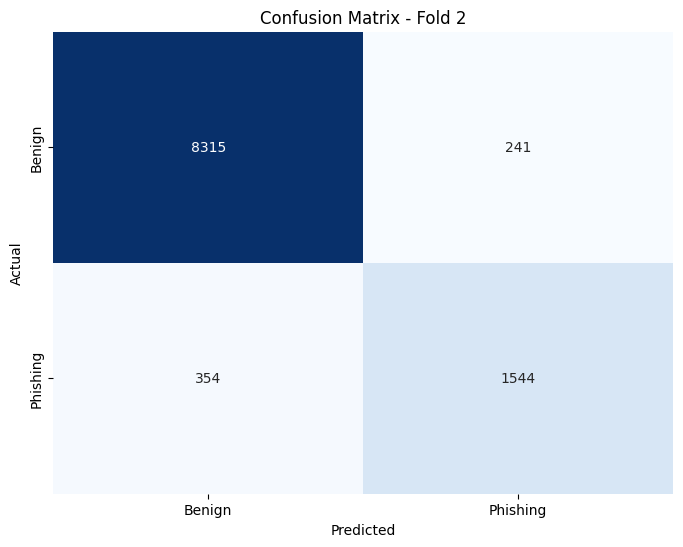


Confusion Matrix for Fold 2:
[[8315  241]
 [ 354 1544]]

=== Fold 3/10 ===


Fold 3 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4251, Train Accuracy = 82.59%, Val Loss = 0.3378, Val Accuracy = 86.17%, F1 Score = 0.8405, Precision = 0.8491, Recall = 0.8617, AUC-ROC = 0.8543, Epoch Time = 59.42 seconds
Saved best model for fold 3 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3173, Train Accuracy = 86.72%, Val Loss = 0.2677, Val Accuracy = 89.38%, F1 Score = 0.8853, Precision = 0.8877, Recall = 0.8938, AUC-ROC = 0.9155, Epoch Time = 59.68 seconds
Saved best model for fold 3 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2746, Train Accuracy = 88.92%, Val Loss = 0.2391, Val Accuracy = 90.72%, F1 Score = 0.9018, Precision = 0.9027, Recall = 0.9072, AUC-ROC = 0.9325, Epoch Time = 59.05 seconds
Saved best model for fold 3 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2508, Train Accuracy = 90.31%, Val Loss = 0.2185, Val Accuracy = 91.78%, F1 Score = 0.9139, Precision = 0.9145, Recall = 0.9178, AUC-ROC = 0.9425, Epoch Time = 59.51 seconds
Saved best model for fold 3 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2337, Train Accuracy = 91.37%, Val Loss = 0.2067, Val Accuracy = 92.40%, F1 Score = 0.9211, Precision = 0.9212, Recall = 0.9240, AUC-ROC = 0.9475, Epoch Time = 58.88 seconds
Saved best model for fold 3 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2250, Train Accuracy = 91.81%, Val Loss = 0.2000, Val Accuracy = 92.87%, F1 Score = 0.9265, Precision = 0.9264, Recall = 0.9287, AUC-ROC = 0.9503, Epoch Time = 59.21 seconds
Saved best model for fold 3 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2192, Train Accuracy = 92.16%, Val Loss = 0.1940, Val Accuracy = 93.11%, F1 Score = 0.9292, Precision = 0.9290, Recall = 0.9311, AUC-ROC = 0.9527, Epoch Time = 59.52 seconds
Saved best model for fold 3 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.2108, Train Accuracy = 92.47%, Val Loss = 0.1854, Val Accuracy = 93.48%, F1 Score = 0.9334, Precision = 0.9330, Recall = 0.9348, AUC-ROC = 0.9563, Epoch Time = 58.92 seconds
Saved best model for fold 3 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.2033, Train Accuracy = 92.86%, Val Loss = 0.1779, Val Accuracy = 93.73%, F1 Score = 0.9359, Precision = 0.9357, Recall = 0.9373, AUC-ROC = 0.9590, Epoch Time = 59.29 seconds
Saved best model for fold 3 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1964, Train Accuracy = 93.11%, Val Loss = 0.1749, Val Accuracy = 93.86%, F1 Score = 0.9377, Precision = 0.9373, Recall = 0.9386, AUC-ROC = 0.9605, Epoch Time = 58.94 seconds
Saved best model for fold 3 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1937, Train Accuracy = 93.22%, Val Loss = 0.1713, Val Accuracy = 94.04%, F1 Score = 0.9395, Precision = 0.9391, Recall = 0.9404, AUC-ROC = 0.9616, Epoch Time = 59.47 seconds
Saved best model for fold 3 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1878, Train Accuracy = 93.41%, Val Loss = 0.1657, Val Accuracy = 94.29%, F1 Score = 0.9422, Precision = 0.9419, Recall = 0.9429, AUC-ROC = 0.9639, Epoch Time = 59.62 seconds
Saved best model for fold 3 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1823, Train Accuracy = 93.65%, Val Loss = 0.1604, Val Accuracy = 94.40%, F1 Score = 0.9432, Precision = 0.9429, Recall = 0.9440, AUC-ROC = 0.9657, Epoch Time = 59.22 seconds
Saved best model for fold 3 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1772, Train Accuracy = 93.80%, Val Loss = 0.1598, Val Accuracy = 94.54%, F1 Score = 0.9451, Precision = 0.9450, Recall = 0.9454, AUC-ROC = 0.9671, Epoch Time = 59.77 seconds
Saved best model for fold 3 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1741, Train Accuracy = 93.96%, Val Loss = 0.1562, Val Accuracy = 94.58%, F1 Score = 0.9453, Precision = 0.9450, Recall = 0.9458, AUC-ROC = 0.9676, Epoch Time = 59.31 seconds
Saved best model for fold 3 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1725, Train Accuracy = 94.01%, Val Loss = 0.1535, Val Accuracy = 94.65%, F1 Score = 0.9457, Precision = 0.9454, Recall = 0.9465, AUC-ROC = 0.9681, Epoch Time = 60.08 seconds
Saved best model for fold 3 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1707, Train Accuracy = 94.07%, Val Loss = 0.1544, Val Accuracy = 94.70%, F1 Score = 0.9467, Precision = 0.9464, Recall = 0.9470, AUC-ROC = 0.9686, Epoch Time = 59.11 seconds
Saved best model for fold 3 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1700, Train Accuracy = 94.15%, Val Loss = 0.1531, Val Accuracy = 94.66%, F1 Score = 0.9462, Precision = 0.9459, Recall = 0.9466, AUC-ROC = 0.9689, Epoch Time = 59.36 seconds
Saved best model for fold 3 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1692, Train Accuracy = 94.13%, Val Loss = 0.1534, Val Accuracy = 94.66%, F1 Score = 0.9463, Precision = 0.9461, Recall = 0.9466, AUC-ROC = 0.9691, Epoch Time = 59.09 seconds
Saved best model for fold 3 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1689, Train Accuracy = 94.14%, Val Loss = 0.1535, Val Accuracy = 94.66%, F1 Score = 0.9464, Precision = 0.9462, Recall = 0.9466, AUC-ROC = 0.9693, Epoch Time = 59.10 seconds
Saved best model for fold 3 based on recall at epoch 20.

Total training time for Fold 3: 1186.57 seconds

Confusion Matrix for Fold 3:


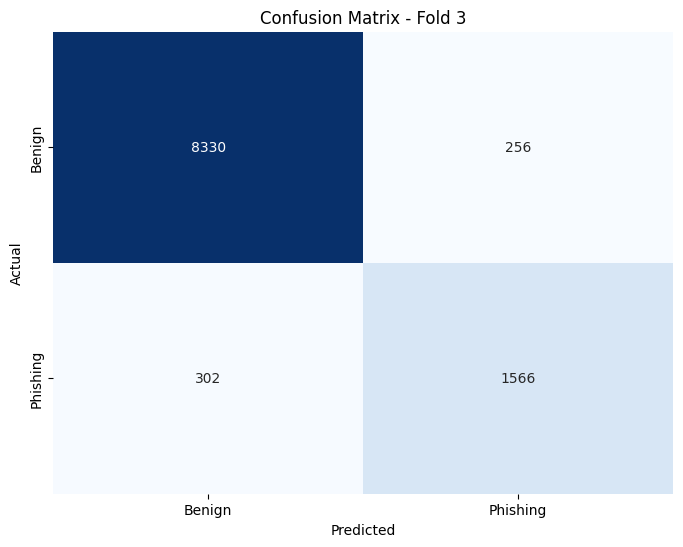


Confusion Matrix for Fold 3:
[[8330  256]
 [ 302 1566]]

=== Fold 4/10 ===


Fold 4 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4508, Train Accuracy = 81.28%, Val Loss = 0.3799, Val Accuracy = 83.12%, F1 Score = 0.7805, Precision = 0.8050, Recall = 0.8312, AUC-ROC = 0.8109, Epoch Time = 59.33 seconds
Saved best model for fold 4 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3590, Train Accuracy = 84.20%, Val Loss = 0.3219, Val Accuracy = 85.96%, F1 Score = 0.8418, Precision = 0.8452, Recall = 0.8596, AUC-ROC = 0.8758, Epoch Time = 59.52 seconds
Saved best model for fold 4 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.3079, Train Accuracy = 86.98%, Val Loss = 0.2840, Val Accuracy = 88.44%, F1 Score = 0.8752, Precision = 0.8763, Recall = 0.8844, AUC-ROC = 0.9063, Epoch Time = 59.03 seconds
Saved best model for fold 4 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2754, Train Accuracy = 88.92%, Val Loss = 0.2560, Val Accuracy = 89.79%, F1 Score = 0.8915, Precision = 0.8922, Recall = 0.8979, AUC-ROC = 0.9225, Epoch Time = 58.80 seconds
Saved best model for fold 4 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2502, Train Accuracy = 90.43%, Val Loss = 0.2376, Val Accuracy = 91.24%, F1 Score = 0.9087, Precision = 0.9085, Recall = 0.9124, AUC-ROC = 0.9307, Epoch Time = 59.64 seconds
Saved best model for fold 4 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2320, Train Accuracy = 91.54%, Val Loss = 0.2245, Val Accuracy = 92.06%, F1 Score = 0.9173, Precision = 0.9176, Recall = 0.9206, AUC-ROC = 0.9371, Epoch Time = 58.99 seconds
Saved best model for fold 4 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2190, Train Accuracy = 92.19%, Val Loss = 0.2143, Val Accuracy = 92.33%, F1 Score = 0.9208, Precision = 0.9205, Recall = 0.9233, AUC-ROC = 0.9420, Epoch Time = 59.58 seconds
Saved best model for fold 4 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.2091, Train Accuracy = 92.61%, Val Loss = 0.2067, Val Accuracy = 92.66%, F1 Score = 0.9241, Precision = 0.9241, Recall = 0.9266, AUC-ROC = 0.9455, Epoch Time = 58.94 seconds
Saved best model for fold 4 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.2021, Train Accuracy = 92.95%, Val Loss = 0.2021, Val Accuracy = 92.84%, F1 Score = 0.9265, Precision = 0.9262, Recall = 0.9284, AUC-ROC = 0.9482, Epoch Time = 59.61 seconds
Saved best model for fold 4 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1987, Train Accuracy = 93.06%, Val Loss = 0.1998, Val Accuracy = 92.86%, F1 Score = 0.9270, Precision = 0.9266, Recall = 0.9286, AUC-ROC = 0.9496, Epoch Time = 59.30 seconds
Saved best model for fold 4 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1961, Train Accuracy = 93.12%, Val Loss = 0.1969, Val Accuracy = 93.01%, F1 Score = 0.9284, Precision = 0.9280, Recall = 0.9301, AUC-ROC = 0.9508, Epoch Time = 59.28 seconds
Saved best model for fold 4 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1925, Train Accuracy = 93.31%, Val Loss = 0.1925, Val Accuracy = 93.11%, F1 Score = 0.9293, Precision = 0.9290, Recall = 0.9311, AUC-ROC = 0.9528, Epoch Time = 59.64 seconds
Saved best model for fold 4 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1873, Train Accuracy = 93.46%, Val Loss = 0.1865, Val Accuracy = 93.31%, F1 Score = 0.9319, Precision = 0.9314, Recall = 0.9331, AUC-ROC = 0.9563, Epoch Time = 59.36 seconds
Saved best model for fold 4 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1805, Train Accuracy = 93.68%, Val Loss = 0.1813, Val Accuracy = 93.47%, F1 Score = 0.9328, Precision = 0.9327, Recall = 0.9347, AUC-ROC = 0.9587, Epoch Time = 59.56 seconds
Saved best model for fold 4 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1764, Train Accuracy = 93.81%, Val Loss = 0.1768, Val Accuracy = 93.45%, F1 Score = 0.9332, Precision = 0.9328, Recall = 0.9345, AUC-ROC = 0.9607, Epoch Time = 59.02 seconds
Saved best model for fold 4 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1729, Train Accuracy = 93.95%, Val Loss = 0.1760, Val Accuracy = 93.60%, F1 Score = 0.9351, Precision = 0.9347, Recall = 0.9360, AUC-ROC = 0.9617, Epoch Time = 59.15 seconds
Saved best model for fold 4 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1709, Train Accuracy = 94.04%, Val Loss = 0.1731, Val Accuracy = 93.61%, F1 Score = 0.9349, Precision = 0.9345, Recall = 0.9361, AUC-ROC = 0.9624, Epoch Time = 59.95 seconds
Saved best model for fold 4 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1695, Train Accuracy = 94.08%, Val Loss = 0.1713, Val Accuracy = 93.74%, F1 Score = 0.9362, Precision = 0.9359, Recall = 0.9374, AUC-ROC = 0.9631, Epoch Time = 59.24 seconds
Saved best model for fold 4 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1682, Train Accuracy = 94.13%, Val Loss = 0.1684, Val Accuracy = 93.90%, F1 Score = 0.9375, Precision = 0.9373, Recall = 0.9390, AUC-ROC = 0.9644, Epoch Time = 59.78 seconds
Saved best model for fold 4 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1637, Train Accuracy = 94.28%, Val Loss = 0.1637, Val Accuracy = 93.84%, F1 Score = 0.9375, Precision = 0.9371, Recall = 0.9384, AUC-ROC = 0.9668, Epoch Time = 58.74 seconds
Saved best model for fold 4 based on recall at epoch 20.

Total training time for Fold 4: 1186.46 seconds

Confusion Matrix for Fold 4:


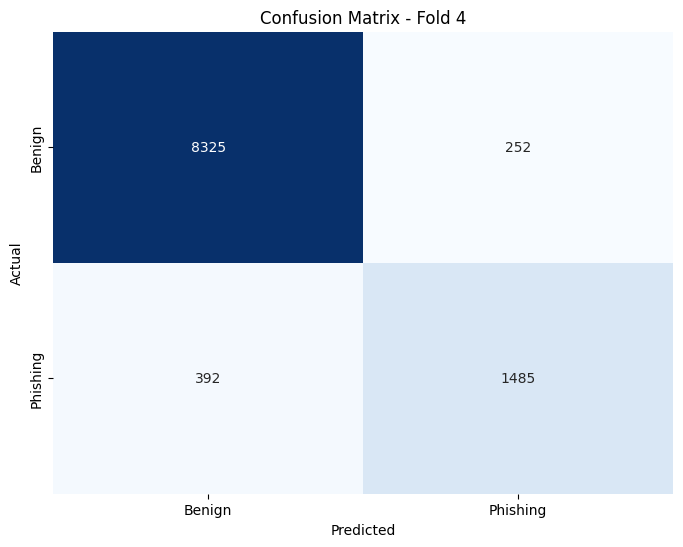


Confusion Matrix for Fold 4:
[[8325  252]
 [ 392 1485]]

=== Fold 5/10 ===


Fold 5 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.3903, Train Accuracy = 83.58%, Val Loss = 0.2985, Val Accuracy = 87.62%, F1 Score = 0.8663, Precision = 0.8668, Recall = 0.8762, AUC-ROC = 0.8934, Epoch Time = 59.92 seconds
Saved best model for fold 5 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.2627, Train Accuracy = 89.68%, Val Loss = 0.2276, Val Accuracy = 91.66%, F1 Score = 0.9135, Precision = 0.9133, Recall = 0.9166, AUC-ROC = 0.9387, Epoch Time = 59.47 seconds
Saved best model for fold 5 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2207, Train Accuracy = 92.08%, Val Loss = 0.2052, Val Accuracy = 92.84%, F1 Score = 0.9262, Precision = 0.9262, Recall = 0.9284, AUC-ROC = 0.9475, Epoch Time = 59.85 seconds
Saved best model for fold 5 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2023, Train Accuracy = 93.07%, Val Loss = 0.1934, Val Accuracy = 93.37%, F1 Score = 0.9323, Precision = 0.9319, Recall = 0.9337, AUC-ROC = 0.9528, Epoch Time = 59.28 seconds
Saved best model for fold 5 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.1911, Train Accuracy = 93.45%, Val Loss = 0.1869, Val Accuracy = 93.53%, F1 Score = 0.9335, Precision = 0.9335, Recall = 0.9353, AUC-ROC = 0.9553, Epoch Time = 59.63 seconds
Saved best model for fold 5 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.1864, Train Accuracy = 93.66%, Val Loss = 0.1847, Val Accuracy = 93.71%, F1 Score = 0.9359, Precision = 0.9355, Recall = 0.9371, AUC-ROC = 0.9567, Epoch Time = 58.99 seconds
Saved best model for fold 5 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.1829, Train Accuracy = 93.78%, Val Loss = 0.1815, Val Accuracy = 93.78%, F1 Score = 0.9365, Precision = 0.9362, Recall = 0.9378, AUC-ROC = 0.9578, Epoch Time = 59.35 seconds
Saved best model for fold 5 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1802, Train Accuracy = 93.86%, Val Loss = 0.1808, Val Accuracy = 93.86%, F1 Score = 0.9375, Precision = 0.9372, Recall = 0.9386, AUC-ROC = 0.9584, Epoch Time = 59.67 seconds
Saved best model for fold 5 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1782, Train Accuracy = 93.87%, Val Loss = 0.1772, Val Accuracy = 93.92%, F1 Score = 0.9377, Precision = 0.9376, Recall = 0.9392, AUC-ROC = 0.9594, Epoch Time = 59.24 seconds
Saved best model for fold 5 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1759, Train Accuracy = 94.01%, Val Loss = 0.1758, Val Accuracy = 94.02%, F1 Score = 0.9391, Precision = 0.9388, Recall = 0.9402, AUC-ROC = 0.9603, Epoch Time = 60.06 seconds
Saved best model for fold 5 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1734, Train Accuracy = 94.09%, Val Loss = 0.1743, Val Accuracy = 94.09%, F1 Score = 0.9398, Precision = 0.9395, Recall = 0.9409, AUC-ROC = 0.9609, Epoch Time = 59.39 seconds
Saved best model for fold 5 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1717, Train Accuracy = 94.10%, Val Loss = 0.1730, Val Accuracy = 94.13%, F1 Score = 0.9400, Precision = 0.9398, Recall = 0.9413, AUC-ROC = 0.9611, Epoch Time = 59.42 seconds
Saved best model for fold 5 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1710, Train Accuracy = 94.14%, Val Loss = 0.1731, Val Accuracy = 94.11%, F1 Score = 0.9402, Precision = 0.9398, Recall = 0.9411, AUC-ROC = 0.9618, Epoch Time = 59.94 seconds
Saved best model for fold 5 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1700, Train Accuracy = 94.15%, Val Loss = 0.1715, Val Accuracy = 94.17%, F1 Score = 0.9407, Precision = 0.9405, Recall = 0.9417, AUC-ROC = 0.9622, Epoch Time = 59.42 seconds
Saved best model for fold 5 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1686, Train Accuracy = 94.22%, Val Loss = 0.1696, Val Accuracy = 94.30%, F1 Score = 0.9419, Precision = 0.9417, Recall = 0.9430, AUC-ROC = 0.9628, Epoch Time = 59.71 seconds
Saved best model for fold 5 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1668, Train Accuracy = 94.27%, Val Loss = 0.1683, Val Accuracy = 94.28%, F1 Score = 0.9418, Precision = 0.9415, Recall = 0.9428, AUC-ROC = 0.9633, Epoch Time = 59.43 seconds
Saved best model for fold 5 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1648, Train Accuracy = 94.36%, Val Loss = 0.1672, Val Accuracy = 94.33%, F1 Score = 0.9423, Precision = 0.9420, Recall = 0.9433, AUC-ROC = 0.9640, Epoch Time = 59.76 seconds
Saved best model for fold 5 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1637, Train Accuracy = 94.35%, Val Loss = 0.1660, Val Accuracy = 94.35%, F1 Score = 0.9424, Precision = 0.9422, Recall = 0.9435, AUC-ROC = 0.9642, Epoch Time = 59.45 seconds
Saved best model for fold 5 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1630, Train Accuracy = 94.38%, Val Loss = 0.1668, Val Accuracy = 94.29%, F1 Score = 0.9422, Precision = 0.9419, Recall = 0.9429, AUC-ROC = 0.9645, Epoch Time = 59.37 seconds
Saved best model for fold 5 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1621, Train Accuracy = 94.44%, Val Loss = 0.1646, Val Accuracy = 94.41%, F1 Score = 0.9433, Precision = 0.9430, Recall = 0.9441, AUC-ROC = 0.9650, Epoch Time = 60.11 seconds
Saved best model for fold 5 based on recall at epoch 20.

Total training time for Fold 5: 1191.45 seconds

Confusion Matrix for Fold 5:


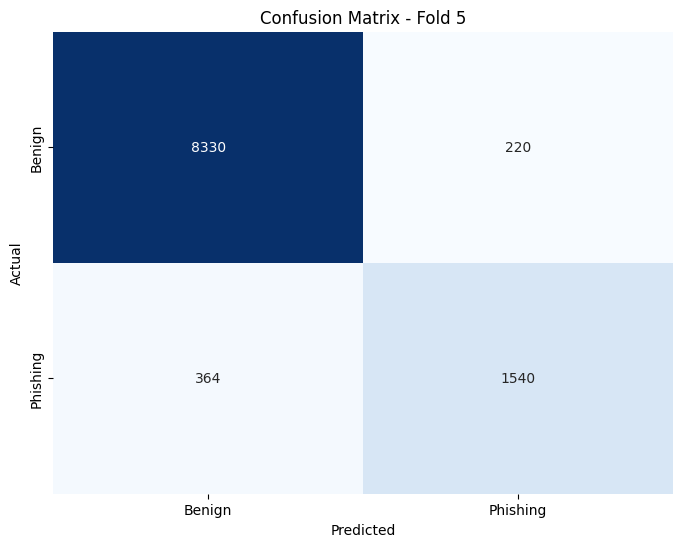


Confusion Matrix for Fold 5:
[[8330  220]
 [ 364 1540]]

=== Fold 6/10 ===


Fold 6 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4342, Train Accuracy = 82.17%, Val Loss = 0.3752, Val Accuracy = 83.99%, F1 Score = 0.8014, Precision = 0.8251, Recall = 0.8399, AUC-ROC = 0.8179, Epoch Time = 60.28 seconds
Saved best model for fold 6 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3522, Train Accuracy = 85.00%, Val Loss = 0.3235, Val Accuracy = 86.23%, F1 Score = 0.8438, Precision = 0.8509, Recall = 0.8623, AUC-ROC = 0.8770, Epoch Time = 62.33 seconds
Saved best model for fold 6 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.3201, Train Accuracy = 86.46%, Val Loss = 0.2975, Val Accuracy = 87.46%, F1 Score = 0.8600, Precision = 0.8666, Recall = 0.8746, AUC-ROC = 0.9011, Epoch Time = 59.36 seconds
Saved best model for fold 6 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2900, Train Accuracy = 87.95%, Val Loss = 0.2579, Val Accuracy = 89.33%, F1 Score = 0.8837, Precision = 0.8886, Recall = 0.8933, AUC-ROC = 0.9278, Epoch Time = 60.13 seconds
Saved best model for fold 6 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2596, Train Accuracy = 89.64%, Val Loss = 0.2318, Val Accuracy = 91.00%, F1 Score = 0.9043, Precision = 0.9066, Recall = 0.9100, AUC-ROC = 0.9399, Epoch Time = 59.74 seconds
Saved best model for fold 6 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2388, Train Accuracy = 90.96%, Val Loss = 0.2142, Val Accuracy = 92.09%, F1 Score = 0.9172, Precision = 0.9182, Recall = 0.9209, AUC-ROC = 0.9468, Epoch Time = 60.19 seconds
Saved best model for fold 6 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2231, Train Accuracy = 91.79%, Val Loss = 0.2010, Val Accuracy = 92.89%, F1 Score = 0.9264, Precision = 0.9267, Recall = 0.9289, AUC-ROC = 0.9515, Epoch Time = 59.71 seconds
Saved best model for fold 6 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.2118, Train Accuracy = 92.45%, Val Loss = 0.1917, Val Accuracy = 93.21%, F1 Score = 0.9298, Precision = 0.9301, Recall = 0.9321, AUC-ROC = 0.9552, Epoch Time = 59.99 seconds
Saved best model for fold 6 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.2023, Train Accuracy = 92.80%, Val Loss = 0.1865, Val Accuracy = 93.50%, F1 Score = 0.9335, Precision = 0.9333, Recall = 0.9350, AUC-ROC = 0.9570, Epoch Time = 60.28 seconds
Saved best model for fold 6 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1976, Train Accuracy = 93.08%, Val Loss = 0.1816, Val Accuracy = 93.66%, F1 Score = 0.9348, Precision = 0.9349, Recall = 0.9366, AUC-ROC = 0.9587, Epoch Time = 59.62 seconds
Saved best model for fold 6 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1921, Train Accuracy = 93.20%, Val Loss = 0.1774, Val Accuracy = 93.84%, F1 Score = 0.9371, Precision = 0.9369, Recall = 0.9384, AUC-ROC = 0.9604, Epoch Time = 60.36 seconds
Saved best model for fold 6 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1879, Train Accuracy = 93.47%, Val Loss = 0.1737, Val Accuracy = 93.99%, F1 Score = 0.9387, Precision = 0.9385, Recall = 0.9399, AUC-ROC = 0.9617, Epoch Time = 59.33 seconds
Saved best model for fold 6 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1834, Train Accuracy = 93.59%, Val Loss = 0.1707, Val Accuracy = 94.15%, F1 Score = 0.9400, Precision = 0.9400, Recall = 0.9415, AUC-ROC = 0.9626, Epoch Time = 59.83 seconds
Saved best model for fold 6 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1805, Train Accuracy = 93.73%, Val Loss = 0.1683, Val Accuracy = 94.20%, F1 Score = 0.9409, Precision = 0.9407, Recall = 0.9420, AUC-ROC = 0.9635, Epoch Time = 59.91 seconds
Saved best model for fold 6 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1777, Train Accuracy = 93.87%, Val Loss = 0.1665, Val Accuracy = 94.27%, F1 Score = 0.9416, Precision = 0.9414, Recall = 0.9427, AUC-ROC = 0.9645, Epoch Time = 59.61 seconds
Saved best model for fold 6 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1741, Train Accuracy = 93.96%, Val Loss = 0.1644, Val Accuracy = 94.37%, F1 Score = 0.9424, Precision = 0.9424, Recall = 0.9437, AUC-ROC = 0.9650, Epoch Time = 59.79 seconds
Saved best model for fold 6 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1721, Train Accuracy = 94.01%, Val Loss = 0.1631, Val Accuracy = 94.37%, F1 Score = 0.9422, Precision = 0.9424, Recall = 0.9437, AUC-ROC = 0.9655, Epoch Time = 59.39 seconds
Saved best model for fold 6 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1701, Train Accuracy = 94.11%, Val Loss = 0.1613, Val Accuracy = 94.44%, F1 Score = 0.9432, Precision = 0.9432, Recall = 0.9444, AUC-ROC = 0.9662, Epoch Time = 60.20 seconds
Saved best model for fold 6 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1682, Train Accuracy = 94.15%, Val Loss = 0.1616, Val Accuracy = 94.38%, F1 Score = 0.9432, Precision = 0.9429, Recall = 0.9438, AUC-ROC = 0.9668, Epoch Time = 59.66 seconds
Saved best model for fold 6 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1664, Train Accuracy = 94.25%, Val Loss = 0.1577, Val Accuracy = 94.52%, F1 Score = 0.9441, Precision = 0.9440, Recall = 0.9452, AUC-ROC = 0.9674, Epoch Time = 59.68 seconds
Saved best model for fold 6 based on recall at epoch 20.

Total training time for Fold 6: 1199.38 seconds

Confusion Matrix for Fold 6:


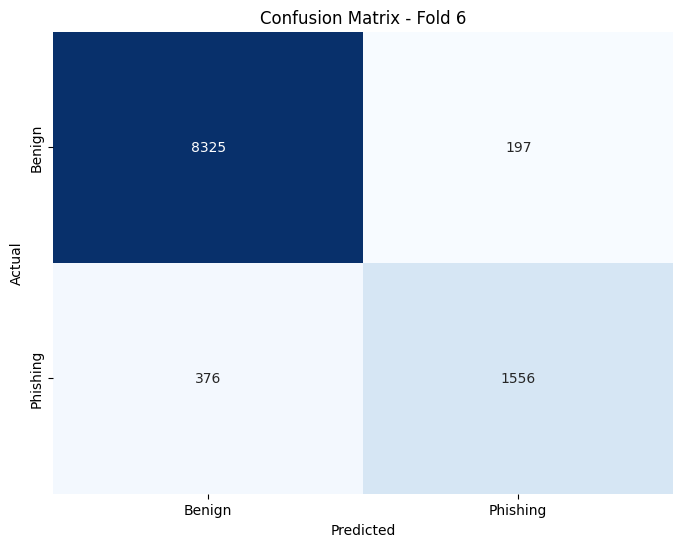


Confusion Matrix for Fold 6:
[[8325  197]
 [ 376 1556]]

=== Fold 7/10 ===


Fold 7 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4412, Train Accuracy = 81.22%, Val Loss = 0.3478, Val Accuracy = 85.09%, F1 Score = 0.8269, Precision = 0.8348, Recall = 0.8509, AUC-ROC = 0.8482, Epoch Time = 59.90 seconds
Saved best model for fold 7 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3105, Train Accuracy = 87.10%, Val Loss = 0.2753, Val Accuracy = 88.79%, F1 Score = 0.8781, Precision = 0.8813, Recall = 0.8879, AUC-ROC = 0.9114, Epoch Time = 59.90 seconds
Saved best model for fold 7 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2693, Train Accuracy = 89.36%, Val Loss = 0.2494, Val Accuracy = 90.15%, F1 Score = 0.8955, Precision = 0.8965, Recall = 0.9015, AUC-ROC = 0.9262, Epoch Time = 60.02 seconds
Saved best model for fold 7 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2472, Train Accuracy = 90.70%, Val Loss = 0.2304, Val Accuracy = 91.35%, F1 Score = 0.9097, Precision = 0.9099, Recall = 0.9135, AUC-ROC = 0.9353, Epoch Time = 59.49 seconds
Saved best model for fold 7 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2314, Train Accuracy = 91.58%, Val Loss = 0.2194, Val Accuracy = 92.09%, F1 Score = 0.9179, Precision = 0.9180, Recall = 0.9209, AUC-ROC = 0.9403, Epoch Time = 60.20 seconds
Saved best model for fold 7 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2240, Train Accuracy = 92.03%, Val Loss = 0.2132, Val Accuracy = 92.49%, F1 Score = 0.9224, Precision = 0.9224, Recall = 0.9249, AUC-ROC = 0.9430, Epoch Time = 59.58 seconds
Saved best model for fold 7 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2167, Train Accuracy = 92.37%, Val Loss = 0.2055, Val Accuracy = 92.95%, F1 Score = 0.9275, Precision = 0.9273, Recall = 0.9295, AUC-ROC = 0.9464, Epoch Time = 59.96 seconds
Saved best model for fold 7 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.2042, Train Accuracy = 92.90%, Val Loss = 0.1922, Val Accuracy = 93.43%, F1 Score = 0.9330, Precision = 0.9326, Recall = 0.9343, AUC-ROC = 0.9527, Epoch Time = 59.90 seconds
Saved best model for fold 7 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1943, Train Accuracy = 93.37%, Val Loss = 0.1828, Val Accuracy = 93.72%, F1 Score = 0.9356, Precision = 0.9355, Recall = 0.9372, AUC-ROC = 0.9559, Epoch Time = 59.38 seconds
Saved best model for fold 7 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1844, Train Accuracy = 93.67%, Val Loss = 0.1777, Val Accuracy = 93.93%, F1 Score = 0.9381, Precision = 0.9378, Recall = 0.9393, AUC-ROC = 0.9583, Epoch Time = 60.40 seconds
Saved best model for fold 7 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1800, Train Accuracy = 93.82%, Val Loss = 0.1764, Val Accuracy = 93.88%, F1 Score = 0.9381, Precision = 0.9377, Recall = 0.9388, AUC-ROC = 0.9597, Epoch Time = 59.34 seconds
Saved best model for fold 7 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1779, Train Accuracy = 93.91%, Val Loss = 0.1735, Val Accuracy = 94.02%, F1 Score = 0.9395, Precision = 0.9391, Recall = 0.9402, AUC-ROC = 0.9607, Epoch Time = 60.42 seconds
Saved best model for fold 7 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1749, Train Accuracy = 94.01%, Val Loss = 0.1712, Val Accuracy = 94.17%, F1 Score = 0.9408, Precision = 0.9405, Recall = 0.9417, AUC-ROC = 0.9613, Epoch Time = 60.19 seconds
Saved best model for fold 7 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1730, Train Accuracy = 94.11%, Val Loss = 0.1729, Val Accuracy = 94.00%, F1 Score = 0.9397, Precision = 0.9395, Recall = 0.9400, AUC-ROC = 0.9620, Epoch Time = 59.87 seconds
Saved best model for fold 7 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1710, Train Accuracy = 94.14%, Val Loss = 0.1687, Val Accuracy = 94.18%, F1 Score = 0.9413, Precision = 0.9409, Recall = 0.9418, AUC-ROC = 0.9630, Epoch Time = 60.40 seconds
Saved best model for fold 7 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1687, Train Accuracy = 94.18%, Val Loss = 0.1674, Val Accuracy = 94.19%, F1 Score = 0.9414, Precision = 0.9410, Recall = 0.9419, AUC-ROC = 0.9635, Epoch Time = 59.70 seconds
Saved best model for fold 7 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1677, Train Accuracy = 94.29%, Val Loss = 0.1665, Val Accuracy = 94.25%, F1 Score = 0.9420, Precision = 0.9417, Recall = 0.9425, AUC-ROC = 0.9640, Epoch Time = 60.00 seconds
Saved best model for fold 7 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1661, Train Accuracy = 94.32%, Val Loss = 0.1635, Val Accuracy = 94.41%, F1 Score = 0.9433, Precision = 0.9430, Recall = 0.9441, AUC-ROC = 0.9646, Epoch Time = 60.64 seconds
Saved best model for fold 7 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1640, Train Accuracy = 94.39%, Val Loss = 0.1634, Val Accuracy = 94.33%, F1 Score = 0.9429, Precision = 0.9426, Recall = 0.9433, AUC-ROC = 0.9654, Epoch Time = 60.06 seconds
Saved best model for fold 7 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1632, Train Accuracy = 94.43%, Val Loss = 0.1626, Val Accuracy = 94.41%, F1 Score = 0.9438, Precision = 0.9435, Recall = 0.9441, AUC-ROC = 0.9657, Epoch Time = 60.25 seconds
Saved best model for fold 7 based on recall at epoch 20.

Total training time for Fold 7: 1199.59 seconds

Confusion Matrix for Fold 7:


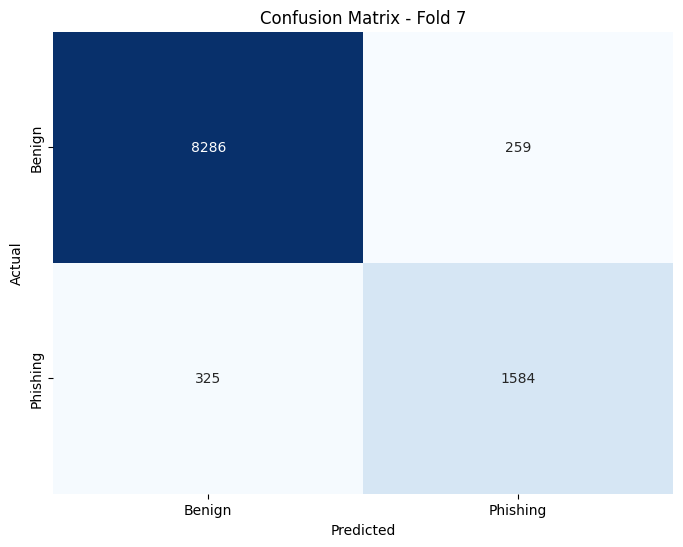


Confusion Matrix for Fold 7:
[[8286  259]
 [ 325 1584]]

=== Fold 8/10 ===


Fold 8 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4551, Train Accuracy = 78.56%, Val Loss = 0.3525, Val Accuracy = 85.09%, F1 Score = 0.8260, Precision = 0.8348, Recall = 0.8509, AUC-ROC = 0.8404, Epoch Time = 60.11 seconds
Saved best model for fold 8 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3161, Train Accuracy = 86.77%, Val Loss = 0.2804, Val Accuracy = 88.78%, F1 Score = 0.8788, Precision = 0.8808, Recall = 0.8878, AUC-ROC = 0.9030, Epoch Time = 60.40 seconds
Saved best model for fold 8 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2622, Train Accuracy = 89.88%, Val Loss = 0.2458, Val Accuracy = 90.73%, F1 Score = 0.9008, Precision = 0.9036, Recall = 0.9073, AUC-ROC = 0.9244, Epoch Time = 59.80 seconds
Saved best model for fold 8 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2312, Train Accuracy = 91.48%, Val Loss = 0.2166, Val Accuracy = 92.19%, F1 Score = 0.9182, Precision = 0.9192, Recall = 0.9219, AUC-ROC = 0.9385, Epoch Time = 60.53 seconds
Saved best model for fold 8 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2078, Train Accuracy = 92.68%, Val Loss = 0.1990, Val Accuracy = 92.84%, F1 Score = 0.9265, Precision = 0.9262, Recall = 0.9284, AUC-ROC = 0.9470, Epoch Time = 59.90 seconds
Saved best model for fold 8 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.1933, Train Accuracy = 93.23%, Val Loss = 0.1898, Val Accuracy = 93.34%, F1 Score = 0.9316, Precision = 0.9315, Recall = 0.9334, AUC-ROC = 0.9509, Epoch Time = 59.42 seconds
Saved best model for fold 8 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.1866, Train Accuracy = 93.53%, Val Loss = 0.1862, Val Accuracy = 93.47%, F1 Score = 0.9334, Precision = 0.9330, Recall = 0.9347, AUC-ROC = 0.9534, Epoch Time = 60.04 seconds
Saved best model for fold 8 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1829, Train Accuracy = 93.66%, Val Loss = 0.1826, Val Accuracy = 93.63%, F1 Score = 0.9350, Precision = 0.9347, Recall = 0.9363, AUC-ROC = 0.9547, Epoch Time = 59.54 seconds
Saved best model for fold 8 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1794, Train Accuracy = 93.80%, Val Loss = 0.1804, Val Accuracy = 93.78%, F1 Score = 0.9366, Precision = 0.9363, Recall = 0.9378, AUC-ROC = 0.9555, Epoch Time = 60.13 seconds
Saved best model for fold 8 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1774, Train Accuracy = 93.87%, Val Loss = 0.1797, Val Accuracy = 93.84%, F1 Score = 0.9377, Precision = 0.9373, Recall = 0.9384, AUC-ROC = 0.9569, Epoch Time = 60.34 seconds
Saved best model for fold 8 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1753, Train Accuracy = 93.98%, Val Loss = 0.1756, Val Accuracy = 94.12%, F1 Score = 0.9400, Precision = 0.9398, Recall = 0.9412, AUC-ROC = 0.9575, Epoch Time = 59.84 seconds
Saved best model for fold 8 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1724, Train Accuracy = 94.07%, Val Loss = 0.1741, Val Accuracy = 94.08%, F1 Score = 0.9399, Precision = 0.9395, Recall = 0.9408, AUC-ROC = 0.9585, Epoch Time = 60.35 seconds
Saved best model for fold 8 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1714, Train Accuracy = 94.12%, Val Loss = 0.1736, Val Accuracy = 94.09%, F1 Score = 0.9400, Precision = 0.9397, Recall = 0.9409, AUC-ROC = 0.9590, Epoch Time = 60.10 seconds
Saved best model for fold 8 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1699, Train Accuracy = 94.12%, Val Loss = 0.1714, Val Accuracy = 94.19%, F1 Score = 0.9409, Precision = 0.9407, Recall = 0.9419, AUC-ROC = 0.9595, Epoch Time = 60.13 seconds
Saved best model for fold 8 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1674, Train Accuracy = 94.29%, Val Loss = 0.1696, Val Accuracy = 94.28%, F1 Score = 0.9419, Precision = 0.9416, Recall = 0.9428, AUC-ROC = 0.9603, Epoch Time = 61.11 seconds
Saved best model for fold 8 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1659, Train Accuracy = 94.32%, Val Loss = 0.1682, Val Accuracy = 94.36%, F1 Score = 0.9426, Precision = 0.9423, Recall = 0.9436, AUC-ROC = 0.9610, Epoch Time = 59.64 seconds
Saved best model for fold 8 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1644, Train Accuracy = 94.35%, Val Loss = 0.1668, Val Accuracy = 94.33%, F1 Score = 0.9424, Precision = 0.9421, Recall = 0.9433, AUC-ROC = 0.9617, Epoch Time = 60.01 seconds
Saved best model for fold 8 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1635, Train Accuracy = 94.38%, Val Loss = 0.1668, Val Accuracy = 94.32%, F1 Score = 0.9426, Precision = 0.9423, Recall = 0.9432, AUC-ROC = 0.9624, Epoch Time = 59.78 seconds
Saved best model for fold 8 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1612, Train Accuracy = 94.47%, Val Loss = 0.1645, Val Accuracy = 94.39%, F1 Score = 0.9431, Precision = 0.9428, Recall = 0.9439, AUC-ROC = 0.9628, Epoch Time = 59.68 seconds
Saved best model for fold 8 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1602, Train Accuracy = 94.49%, Val Loss = 0.1638, Val Accuracy = 94.41%, F1 Score = 0.9434, Precision = 0.9431, Recall = 0.9441, AUC-ROC = 0.9632, Epoch Time = 60.04 seconds
Saved best model for fold 8 based on recall at epoch 20.

Total training time for Fold 8: 1200.88 seconds

Confusion Matrix for Fold 8:


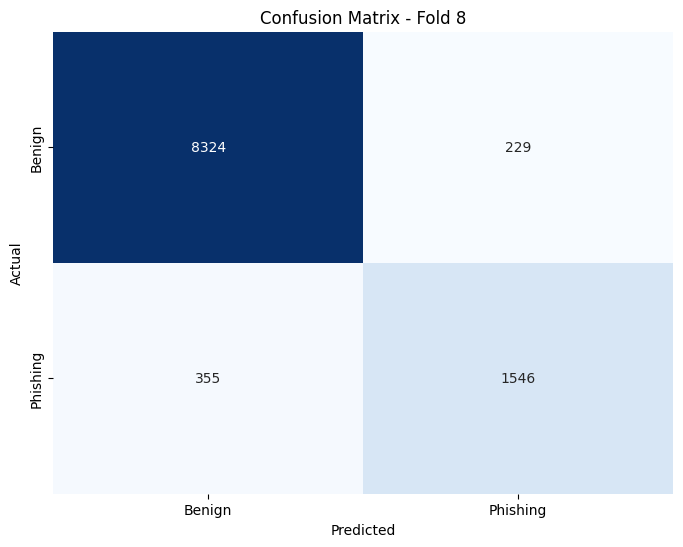


Confusion Matrix for Fold 8:
[[8324  229]
 [ 355 1546]]

=== Fold 9/10 ===


Fold 9 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4733, Train Accuracy = 80.29%, Val Loss = 0.4067, Val Accuracy = 81.70%, F1 Score = 0.7585, Precision = 0.7845, Recall = 0.8170, AUC-ROC = 0.7901, Epoch Time = 59.94 seconds
Saved best model for fold 9 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3649, Train Accuracy = 84.12%, Val Loss = 0.3490, Val Accuracy = 84.84%, F1 Score = 0.8255, Precision = 0.8337, Recall = 0.8484, AUC-ROC = 0.8568, Epoch Time = 60.21 seconds
Saved best model for fold 9 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.3227, Train Accuracy = 86.48%, Val Loss = 0.3221, Val Accuracy = 86.53%, F1 Score = 0.8521, Precision = 0.8547, Recall = 0.8653, AUC-ROC = 0.8802, Epoch Time = 60.01 seconds
Saved best model for fold 9 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2951, Train Accuracy = 88.00%, Val Loss = 0.2900, Val Accuracy = 88.10%, F1 Score = 0.8722, Precision = 0.8735, Recall = 0.8810, AUC-ROC = 0.9047, Epoch Time = 60.19 seconds
Saved best model for fold 9 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2695, Train Accuracy = 89.41%, Val Loss = 0.2675, Val Accuracy = 89.48%, F1 Score = 0.8889, Precision = 0.8894, Recall = 0.8948, AUC-ROC = 0.9186, Epoch Time = 59.87 seconds
Saved best model for fold 9 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2491, Train Accuracy = 90.47%, Val Loss = 0.2517, Val Accuracy = 90.42%, F1 Score = 0.9002, Precision = 0.9001, Recall = 0.9042, AUC-ROC = 0.9271, Epoch Time = 59.80 seconds
Saved best model for fold 9 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2380, Train Accuracy = 91.05%, Val Loss = 0.2434, Val Accuracy = 90.88%, F1 Score = 0.9050, Precision = 0.9051, Recall = 0.9088, AUC-ROC = 0.9310, Epoch Time = 60.48 seconds
Saved best model for fold 9 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.2288, Train Accuracy = 91.56%, Val Loss = 0.2308, Val Accuracy = 91.70%, F1 Score = 0.9138, Precision = 0.9140, Recall = 0.9170, AUC-ROC = 0.9370, Epoch Time = 59.77 seconds
Saved best model for fold 9 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.2170, Train Accuracy = 92.21%, Val Loss = 0.2201, Val Accuracy = 92.19%, F1 Score = 0.9193, Precision = 0.9194, Recall = 0.9219, AUC-ROC = 0.9418, Epoch Time = 59.70 seconds
Saved best model for fold 9 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.2070, Train Accuracy = 92.69%, Val Loss = 0.2123, Val Accuracy = 92.48%, F1 Score = 0.9227, Precision = 0.9225, Recall = 0.9248, AUC-ROC = 0.9450, Epoch Time = 60.40 seconds
Saved best model for fold 9 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.2019, Train Accuracy = 92.96%, Val Loss = 0.2094, Val Accuracy = 92.73%, F1 Score = 0.9260, Precision = 0.9255, Recall = 0.9273, AUC-ROC = 0.9472, Epoch Time = 59.58 seconds
Saved best model for fold 9 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1969, Train Accuracy = 93.13%, Val Loss = 0.2023, Val Accuracy = 92.85%, F1 Score = 0.9267, Precision = 0.9265, Recall = 0.9285, AUC-ROC = 0.9494, Epoch Time = 59.93 seconds
Saved best model for fold 9 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1896, Train Accuracy = 93.43%, Val Loss = 0.1946, Val Accuracy = 93.22%, F1 Score = 0.9307, Precision = 0.9304, Recall = 0.9322, AUC-ROC = 0.9530, Epoch Time = 59.22 seconds
Saved best model for fold 9 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1833, Train Accuracy = 93.71%, Val Loss = 0.1901, Val Accuracy = 93.50%, F1 Score = 0.9343, Precision = 0.9339, Recall = 0.9350, AUC-ROC = 0.9554, Epoch Time = 59.56 seconds
Saved best model for fold 9 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1771, Train Accuracy = 93.90%, Val Loss = 0.1867, Val Accuracy = 93.70%, F1 Score = 0.9365, Precision = 0.9362, Recall = 0.9370, AUC-ROC = 0.9574, Epoch Time = 60.30 seconds
Saved best model for fold 9 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1736, Train Accuracy = 94.06%, Val Loss = 0.1828, Val Accuracy = 93.81%, F1 Score = 0.9372, Precision = 0.9368, Recall = 0.9381, AUC-ROC = 0.9583, Epoch Time = 59.26 seconds
Saved best model for fold 9 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1720, Train Accuracy = 94.09%, Val Loss = 0.1822, Val Accuracy = 93.89%, F1 Score = 0.9383, Precision = 0.9380, Recall = 0.9389, AUC-ROC = 0.9589, Epoch Time = 59.37 seconds
Saved best model for fold 9 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1703, Train Accuracy = 94.16%, Val Loss = 0.1803, Val Accuracy = 93.91%, F1 Score = 0.9384, Precision = 0.9380, Recall = 0.9391, AUC-ROC = 0.9595, Epoch Time = 60.68 seconds
Saved best model for fold 9 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1692, Train Accuracy = 94.22%, Val Loss = 0.1783, Val Accuracy = 93.87%, F1 Score = 0.9373, Precision = 0.9372, Recall = 0.9387, AUC-ROC = 0.9600, Epoch Time = 59.69 seconds
Saved best model for fold 9 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1676, Train Accuracy = 94.26%, Val Loss = 0.1777, Val Accuracy = 93.98%, F1 Score = 0.9391, Precision = 0.9388, Recall = 0.9398, AUC-ROC = 0.9607, Epoch Time = 60.05 seconds
Saved best model for fold 9 based on recall at epoch 20.

Total training time for Fold 9: 1198.00 seconds

Confusion Matrix for Fold 9:


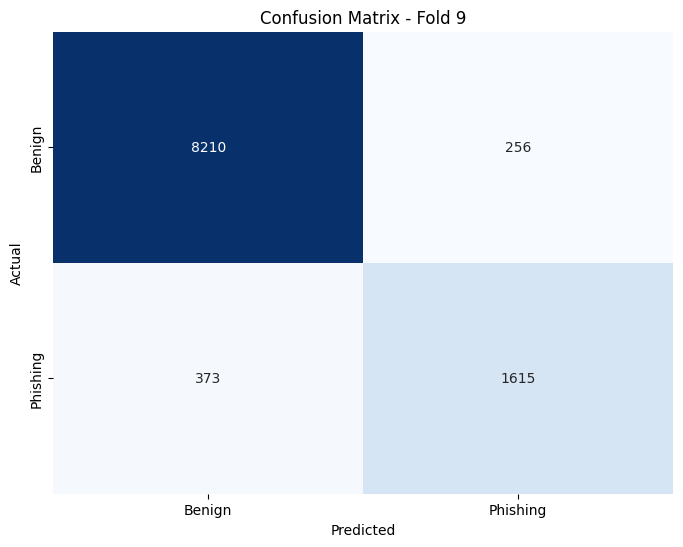


Confusion Matrix for Fold 9:
[[8210  256]
 [ 373 1615]]

=== Fold 10/10 ===


Fold 10 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.4916, Train Accuracy = 74.70%, Val Loss = 0.3471, Val Accuracy = 85.35%, F1 Score = 0.8284, Precision = 0.8374, Recall = 0.8535, AUC-ROC = 0.8435, Epoch Time = 60.82 seconds
Saved best model for fold 10 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.3164, Train Accuracy = 86.40%, Val Loss = 0.2720, Val Accuracy = 89.26%, F1 Score = 0.8852, Precision = 0.8859, Recall = 0.8926, AUC-ROC = 0.9089, Epoch Time = 60.57 seconds
Saved best model for fold 10 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2561, Train Accuracy = 90.02%, Val Loss = 0.2348, Val Accuracy = 91.64%, F1 Score = 0.9126, Precision = 0.9129, Recall = 0.9164, AUC-ROC = 0.9281, Epoch Time = 60.37 seconds
Saved best model for fold 10 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.2315, Train Accuracy = 91.50%, Val Loss = 0.2204, Val Accuracy = 92.49%, F1 Score = 0.9225, Precision = 0.9223, Recall = 0.9249, AUC-ROC = 0.9349, Epoch Time = 60.59 seconds
Saved best model for fold 10 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.2175, Train Accuracy = 92.23%, Val Loss = 0.2090, Val Accuracy = 93.02%, F1 Score = 0.9279, Precision = 0.9279, Recall = 0.9302, AUC-ROC = 0.9398, Epoch Time = 61.21 seconds
Saved best model for fold 10 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.2078, Train Accuracy = 92.76%, Val Loss = 0.2037, Val Accuracy = 93.28%, F1 Score = 0.9312, Precision = 0.9308, Recall = 0.9328, AUC-ROC = 0.9429, Epoch Time = 60.02 seconds
Saved best model for fold 10 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.2024, Train Accuracy = 92.91%, Val Loss = 0.1996, Val Accuracy = 93.36%, F1 Score = 0.9320, Precision = 0.9317, Recall = 0.9336, AUC-ROC = 0.9445, Epoch Time = 60.45 seconds
Saved best model for fold 10 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1980, Train Accuracy = 93.09%, Val Loss = 0.1935, Val Accuracy = 93.52%, F1 Score = 0.9336, Precision = 0.9334, Recall = 0.9352, AUC-ROC = 0.9472, Epoch Time = 61.23 seconds
Saved best model for fold 10 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1911, Train Accuracy = 93.33%, Val Loss = 0.1903, Val Accuracy = 93.65%, F1 Score = 0.9356, Precision = 0.9351, Recall = 0.9365, AUC-ROC = 0.9497, Epoch Time = 64.94 seconds
Saved best model for fold 10 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1864, Train Accuracy = 93.51%, Val Loss = 0.1852, Val Accuracy = 93.74%, F1 Score = 0.9361, Precision = 0.9358, Recall = 0.9374, AUC-ROC = 0.9513, Epoch Time = 60.85 seconds
Saved best model for fold 10 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1834, Train Accuracy = 93.64%, Val Loss = 0.1851, Val Accuracy = 93.82%, F1 Score = 0.9374, Precision = 0.9370, Recall = 0.9382, AUC-ROC = 0.9523, Epoch Time = 60.57 seconds
Saved best model for fold 10 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1806, Train Accuracy = 93.73%, Val Loss = 0.1808, Val Accuracy = 93.99%, F1 Score = 0.9390, Precision = 0.9387, Recall = 0.9399, AUC-ROC = 0.9539, Epoch Time = 69.55 seconds
Saved best model for fold 10 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1780, Train Accuracy = 93.83%, Val Loss = 0.1801, Val Accuracy = 94.06%, F1 Score = 0.9400, Precision = 0.9396, Recall = 0.9406, AUC-ROC = 0.9552, Epoch Time = 63.76 seconds
Saved best model for fold 10 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1738, Train Accuracy = 94.02%, Val Loss = 0.1738, Val Accuracy = 94.25%, F1 Score = 0.9417, Precision = 0.9413, Recall = 0.9425, AUC-ROC = 0.9573, Epoch Time = 60.74 seconds
Saved best model for fold 10 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1691, Train Accuracy = 94.15%, Val Loss = 0.1702, Val Accuracy = 94.36%, F1 Score = 0.9426, Precision = 0.9423, Recall = 0.9436, AUC-ROC = 0.9590, Epoch Time = 61.78 seconds
Saved best model for fold 10 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1653, Train Accuracy = 94.31%, Val Loss = 0.1671, Val Accuracy = 94.49%, F1 Score = 0.9442, Precision = 0.9439, Recall = 0.9449, AUC-ROC = 0.9607, Epoch Time = 60.51 seconds
Saved best model for fold 10 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1628, Train Accuracy = 94.32%, Val Loss = 0.1665, Val Accuracy = 94.46%, F1 Score = 0.9442, Precision = 0.9439, Recall = 0.9446, AUC-ROC = 0.9616, Epoch Time = 60.66 seconds
Saved best model for fold 10 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1608, Train Accuracy = 94.42%, Val Loss = 0.1671, Val Accuracy = 94.40%, F1 Score = 0.9438, Precision = 0.9437, Recall = 0.9440, AUC-ROC = 0.9621, Epoch Time = 60.93 seconds
Saved best model for fold 10 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1594, Train Accuracy = 94.46%, Val Loss = 0.1640, Val Accuracy = 94.55%, F1 Score = 0.9451, Precision = 0.9448, Recall = 0.9455, AUC-ROC = 0.9628, Epoch Time = 60.49 seconds
Saved best model for fold 10 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/736 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/82 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1578, Train Accuracy = 94.50%, Val Loss = 0.1621, Val Accuracy = 94.53%, F1 Score = 0.9447, Precision = 0.9444, Recall = 0.9453, AUC-ROC = 0.9633, Epoch Time = 60.43 seconds
Saved best model for fold 10 based on recall at epoch 20.

Total training time for Fold 10: 1230.48 seconds

Confusion Matrix for Fold 10:


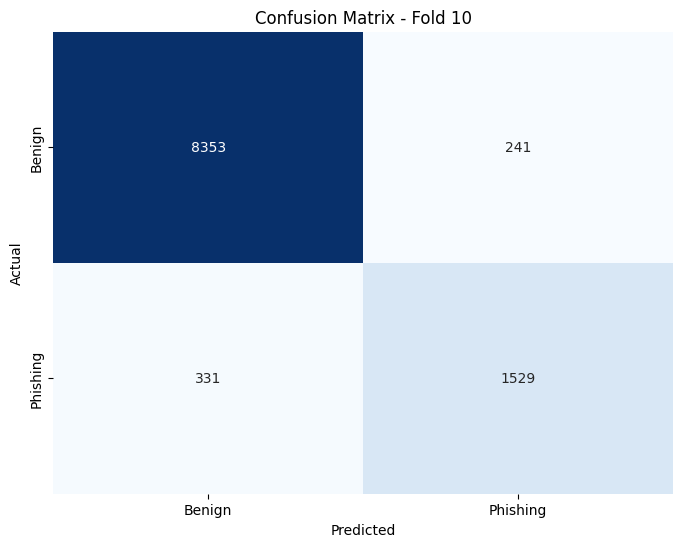


Confusion Matrix for Fold 10:
[[8353  241]
 [ 331 1529]]

Total training time for all folds: 12553.66 seconds
Rata-rata Metrik:
Train Loss: 0.4510 ± 0.0297
Train Accuracy: 0.9432 ± 0.0014
Val Loss: 0.3554 ± 0.0274
Val Accuracy: 0.9432 ± 0.0025
F1 Score: 0.9425 ± 0.0027
Auc Roc: 0.9648 ± 0.0026
Precision: 0.9422 ± 0.0027
Recall: 0.9432 ± 0.0025

=== Informasi Fold Terbaik ===
Fold: 3
Model Tersimpan di: best_model_tune_fold_3.pth
Metrik Terbaik:
Epoch: 17
Train Loss: 0.17068854767991148
Train Accuracy: 0.9406819292987267
Val Loss: 0.15443841149894202
Val Accuracy: 0.9470059307442127
F1 Score: 0.9466657036506284
Precision: 0.9464256325138728
Recall: 0.9470059307442127
Auc Roc: 0.9686203288456734
Epoch Time: 59.113834619522095

=== Confusion Matrix Keseluruhan ===
[[83056  2400]
 [ 3547 15537]]


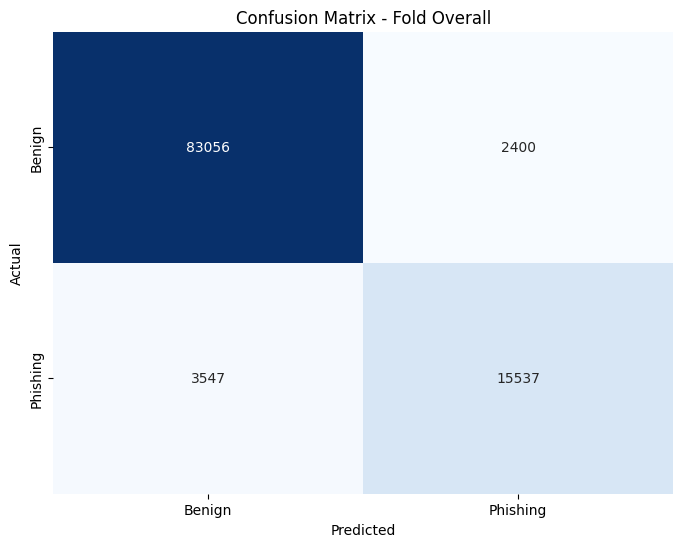

In [ ]:
import torch.nn.functional as F
import os
import sys
# Suppress warnings and set logging
logging.basicConfig(level=logging.ERROR)
warnings.filterwarnings("ignore")
# Suppress specific warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", module="torch.utils.data.dataloader")
# Redirect stderr to /dev/null
sys.stderr = open(os.devnull, 'w')

# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 128
lr = 5e-5
k_folds = 10
num_epochs = 20
num_workers = 4

# Mixed precision scaler
scaler = torch.cuda.amp.GradScaler()

# Custom Transformer-based model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output

# Tokenizer function
def tokenize_data(texts, tokenizer, max_length=64):
   return tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )

def train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels):
    model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0.01)

    best_accuracy = 0
    fold_metrics = []

    # Konversi y_val ke numpy array
    y_val_np = y_val.values if hasattr(y_val, 'values') else np.array(y_val)

    for epoch in tqdm(range(num_epochs), desc=f'Fold {fold} - Epoch', leave=False):
        start_epoch_time = time.time()  # Start time for the epoch

        # Training Phase
        model.train()
        total_train_loss = 0
        correct_train_preds = 0
        total_train_samples = 0

        with tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{num_epochs}", leave=False) as t_train:
            for batch in t_train:
                optimizer.zero_grad()
                input_ids, attention_mask, labels = [b.to(device) for b in batch]
                with torch.cuda.amp.autocast():
                    outputs = model(input_ids, attention_mask)
                    loss = criterion(outputs, labels)
                scaler.scale(loss).backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                scaler.step(optimizer)
                scaler.update()

                total_train_loss += loss.item()

                # Perhitungan akurasi di training
                preds = torch.argmax(outputs, dim=1)
                correct_train_preds += (preds == labels).sum().item()
                total_train_samples += labels.size(0)

                t_train.set_postfix({"Train Loss": loss.item()})

        avg_train_loss = total_train_loss / len(train_loader)
        train_accuracy = correct_train_preds / total_train_samples  # Train Accuracy

        # Validation Phase
        model.eval()
        val_predictions = []
        val_probs = []
        total_val_loss = 0
        correct_val_preds = 0
        total_val_samples = 0

        with tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}", leave=False) as t_val:
            with torch.no_grad():
                for batch in t_val:
                    input_ids, attention_mask, labels = [b.to(device) for b in batch]
                    with torch.cuda.amp.autocast():
                        outputs = model(input_ids, attention_mask)
                        loss = criterion(outputs, labels)

                    total_val_loss += loss.item()

                    batch_probs = torch.softmax(outputs, dim=1)
                    batch_predictions = torch.argmax(outputs, dim=1)

                    val_predictions.extend(batch_predictions.cpu().numpy())
                    val_probs.extend(batch_probs.cpu().numpy())

                    # Perhitungan akurasi di validation
                    correct_val_preds += (batch_predictions == labels).sum().item()
                    total_val_samples += labels.size(0)

                    t_val.set_postfix({"Val Loss": loss.item()})

        avg_val_loss = total_val_loss / len(val_loader)
        val_accuracy = correct_val_preds / total_val_samples  # Validation Accuracy

        val_predictions_np = np.array(val_predictions)
        val_probs_np = np.array(val_probs)

        precision = precision_score(y_val_np, val_predictions_np, average='weighted')
        recall = recall_score(y_val_np, val_predictions_np, average='weighted')
        f1 = f1_score(y_val_np, val_predictions_np, average='weighted')

        y_val_onehot = F.one_hot(torch.LongTensor(y_val_np), num_classes=num_labels).numpy()
        try:
            auc_roc = roc_auc_score(y_val_onehot, val_probs_np, multi_class='ovr')
        except ValueError:
            auc_roc = 0

        conf_matrix = confusion_matrix(y_val_np, val_predictions_np)

        # Log hasil epoch
        epoch_time = time.time() - start_epoch_time  # End time for the epoch

        print(f"Epoch {epoch + 1}: Train Loss = {avg_train_loss:.4f}, Train Accuracy = {train_accuracy * 100:.2f}%, "
              f"Val Loss = {avg_val_loss:.4f}, Val Accuracy = {val_accuracy * 100:.2f}%, "
              f"F1 Score = {f1:.4f}, Precision = {precision:.4f}, Recall = {recall:.4f}, "
              f"AUC-ROC = {auc_roc:.4f}, Epoch Time = {epoch_time:.2f} seconds")

        fold_metrics.append({
            'epoch': epoch + 1,
            'train_loss': avg_train_loss,
            'train_accuracy': train_accuracy,
            'val_loss': avg_val_loss,
            'val_accuracy': val_accuracy,
            'f1_score': f1,
            'precision': precision,
            'recall': recall,  # Add recall here
            'auc_roc': auc_roc,
            'epoch_time': epoch_time
        })


        # Inside train_and_evaluate function
        best_recall = -1  # Initialize best_recall

        # In the loop where you're evaluating the model's metrics
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Find the best recall for the fold
        if fold_best_recall > best_recall:
            best_recall = fold_best_recall
            best_model_path = f'best_model_nontune_fold_{fold}.pth'
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model for fold {fold} based on recall at epoch {epoch + 1}.")





    # Log time for the fold
    fold_total_time = sum(fm['epoch_time'] for fm in fold_metrics)
    print(f"\nTotal training time for Fold {fold}: {fold_total_time:.2f} seconds")

    # Setelah seluruh epoch selesai, tampilkan confusion matrix untuk fold tersebut
    conf_matrix = confusion_matrix(y_val_np, val_predictions_np)
    print(f"\nConfusion Matrix for Fold {fold}:")
    plot_confusion_matrix(conf_matrix, labels=['Benign', 'Phishing'], fold=fold)

    return fold_metrics, conf_matrix, best_model_path


def main():
    start_time = time.time()  # Start time for the whole training process

    # Pastikan Anda memiliki X_train_bin dan y_train_bin yang sudah disiapkan sebelumnya
    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)
    input_dim = 30522  # Vocabulary size for tokenizer
    num_labels = len(y_train_bin.unique())

    all_fold_metrics = []
    all_confusion_matrices = []
    best_fold_info = None
    best_overall_accuracy = 0
    # Inside the main function
    best_overall_recall = -1  # Initialize best_overall_recall before using it

    for fold, (train_index, val_index) in enumerate(kf.split(X_train_bin), 1):
        print(f"\n=== Fold {fold}/{k_folds} ===")
        X_train, X_val = X_train_bin.iloc[train_index], X_train_bin.iloc[val_index]
        y_train, y_val = y_train_bin.iloc[train_index], y_train_bin.iloc[val_index]

        tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
        train_encodings = tokenize_data(list(X_train), tokenizer)
        val_encodings = tokenize_data(list(X_val), tokenizer)

        y_train_tensor = torch.LongTensor(y_train.values)
        y_val_tensor = torch.LongTensor(y_val.values)

        train_dataset = TensorDataset(train_encodings['input_ids'], train_encodings['attention_mask'], y_train_tensor)
        val_dataset = TensorDataset(val_encodings['input_ids'], val_encodings['attention_mask'], y_val_tensor)

        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=True, num_workers=num_workers, persistent_workers=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, pin_memory=True, num_workers=num_workers, persistent_workers=True)

        # Train and Evaluate
        fold_metrics, conf_matrix, best_model_path = train_and_evaluate(
            fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels
        )

        # Tampilkan Confusion Matrix untuk setiap fold
        print(f"\nConfusion Matrix for Fold {fold}:")
        print(conf_matrix)

        all_fold_metrics.append(fold_metrics)
        all_confusion_matrices.append(conf_matrix)

        # Dapatkan fold terbaik
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Menggunakan recall terbaik
        if fold_best_recall > best_overall_recall:
            best_overall_recall = fold_best_recall
            best_fold_info = {
                'fold': fold,
                'best_model_path': best_model_path,
                'metrics': fold_metrics
            }
        elif fold_best_recall == best_overall_recall:
            fold_best_accuracy = max(fm['val_accuracy'] for fm in fold_metrics)  # Menggunakan val_accuracy
            if fold_best_accuracy > best_overall_accuracy:
                best_overall_accuracy = fold_best_accuracy
                best_fold_info = {
                    'fold': fold,
                    'best_model_path': best_model_path,
                    'metrics': fold_metrics
                }


    # Log total training time for all folds
    total_time = time.time() - start_time
    print(f"\nTotal training time for all folds: {total_time:.2f} seconds")

    # Ringkasan Metrik
    # Ensure all metrics are included, even if some are missing for certain folds
    metrics_summary = {
        'train_loss': [],
        'train_accuracy': [],
        'val_loss': [],
        'val_accuracy': [],
        'f1_score': [],
        'auc_roc': [],
        'precision': [],
        'recall': []
    }

    for fold_metrics in all_fold_metrics:
        for metric_name in metrics_summary.keys():
            # Add a fallback in case the metric is missing
            metric_values = [fm.get(metric_name, 0.0) for fm in fold_metrics]
            metrics_summary[metric_name].append(max(metric_values))  # Assuming you want to get max per fold

    # Print the summary
    print("Rata-rata Metrik:")
    for metric_name, values in metrics_summary.items():
        print(f"{metric_name.replace('_', ' ').title()}: {np.mean(values):.4f} ± {np.std(values):.4f}")

    # Tampilkan Informasi Fold Terbaik
    if best_fold_info:
        print(f"\n=== Informasi Fold Terbaik ===")
        print(f"Fold: {best_fold_info['fold']}")
        print(f"Model Tersimpan di: {best_fold_info['best_model_path']}")
        print("Metrik Terbaik:")
        best_metrics = max(best_fold_info['metrics'], key=lambda x: x['val_accuracy'])  # Menggunakan val_accuracy
        for key, value in best_metrics.items():
            print(f"{key.replace('_', ' ').title()}: {value}")

    # Confusion Matrix Keseluruhan
    print("\n=== Confusion Matrix Keseluruhan ===")
    total_confusion_matrix = np.sum(all_confusion_matrices, axis=0)
    print(total_confusion_matrix)

    # Definisikan label untuk klasifikasi (misalnya: benign, phishing)
    labels = ['Benign', 'Phishing']  # Ubah sesuai dengan jumlah label yang Anda punya

    # Plot confusion matrix
    plot_confusion_matrix(total_confusion_matrix, labels, fold='Overall')




if __name__ == "__main__":
    main()

## **CLASSIFICATION With Hyperparameter Tuning**


In [ ]:
import torch.nn.functional as F
import os
import sys
# Suppress warnings and set logging
logging.basicConfig(level=logging.ERROR)
warnings.filterwarnings("ignore")
# Suppress specific warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", module="torch.utils.data.dataloader")
# Redirect stderr to /dev/null
sys.stderr = open(os.devnull, 'w')

# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Parameters for the best configuration
best_params = {
    'batch_size': 64,
    'dim_feedforward': 1024,
    'lr': 0.0002,
    'num_attention_heads': 8,
    'num_layers': 6
}

batch_size = best_params['batch_size']
lr = best_params['lr']
k_folds = 10
num_epochs = 20
num_workers = 4

# Mixed precision scaler
scaler = torch.cuda.amp.GradScaler()

# Custom Transformer-based model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=best_params['num_attention_heads'],
                 dim_feedforward=best_params['dim_feedforward'], num_layers=best_params['num_layers']):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output

# Tokenizer function
def tokenize_data(texts, tokenizer, max_length=64):
    encodings = tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )
    return encodings

def train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels):
    model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0.01)

    best_accuracy = 0
    fold_metrics = []

    y_val_np = y_val.values if hasattr(y_val, 'values') else np.array(y_val)

    for epoch in tqdm(range(num_epochs), desc=f'Fold {fold} - Epoch', leave=False):
        start_epoch_time = time.time()  # Start time for the epoch

        # Training Phase
        model.train()
        total_train_loss = 0
        correct_train_preds = 0
        total_train_samples = 0

        with tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{num_epochs}", leave=False) as t_train:
            for batch in t_train:
                optimizer.zero_grad()
                input_ids, attention_mask, labels = [b.to(device) for b in batch]
                with torch.cuda.amp.autocast():
                    outputs = model(input_ids, attention_mask)
                    loss = criterion(outputs, labels)
                scaler.scale(loss).backward()
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                scaler.step(optimizer)
                scaler.update()

                total_train_loss += loss.item()

                # Perhitungan akurasi di training
                preds = torch.argmax(outputs, dim=1)
                correct_train_preds += (preds == labels).sum().item()
                total_train_samples += labels.size(0)

                t_train.set_postfix({"Train Loss": loss.item()})

        avg_train_loss = total_train_loss / len(train_loader)
        train_accuracy = correct_train_preds / total_train_samples  # Train Accuracy

        # Validation Phase
        model.eval()
        val_predictions = []
        val_probs = []
        total_val_loss = 0
        correct_val_preds = 0
        total_val_samples = 0

        with tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}", leave=False) as t_val:
            with torch.no_grad():
                for batch in t_val:
                    input_ids, attention_mask, labels = [b.to(device) for b in batch]
                    with torch.cuda.amp.autocast():
                        outputs = model(input_ids, attention_mask)
                        loss = criterion(outputs, labels)

                    total_val_loss += loss.item()

                    batch_probs = torch.softmax(outputs, dim=1)
                    batch_predictions = torch.argmax(outputs, dim=1)

                    val_predictions.extend(batch_predictions.cpu().numpy())
                    val_probs.extend(batch_probs.cpu().numpy())

                    # Perhitungan akurasi di validation
                    correct_val_preds += (batch_predictions == labels).sum().item()
                    total_val_samples += labels.size(0)

                    t_val.set_postfix({"Val Loss": loss.item()})

        avg_val_loss = total_val_loss / len(val_loader)
        val_accuracy = correct_val_preds / total_val_samples  # Validation Accuracy

        val_predictions_np = np.array(val_predictions)
        val_probs_np = np.array(val_probs)

        precision = precision_score(y_val_np, val_predictions_np, average='weighted')
        recall = recall_score(y_val_np, val_predictions_np, average='weighted')
        f1 = f1_score(y_val_np, val_predictions_np, average='weighted')

        y_val_onehot = F.one_hot(torch.LongTensor(y_val_np), num_classes=num_labels).numpy()
        try:
            auc_roc = roc_auc_score(y_val_onehot, val_probs_np, multi_class='ovr')
        except ValueError:
            auc_roc = 0

        conf_matrix = confusion_matrix(y_val_np, val_predictions_np)

        # Log hasil epoch
        epoch_time = time.time() - start_epoch_time  # End time for the epoch

        print(f"Epoch {epoch + 1}: Train Loss = {avg_train_loss:.4f}, Train Accuracy = {train_accuracy * 100:.2f}%, "
              f"Val Loss = {avg_val_loss:.4f}, Val Accuracy = {val_accuracy * 100:.2f}%, "
              f"F1 Score = {f1:.4f}, Precision = {precision:.4f}, Recall = {recall:.4f}, "
              f"AUC-ROC = {auc_roc:.4f}, Epoch Time = {epoch_time:.2f} seconds")

        fold_metrics.append({
            'epoch': epoch + 1,
            'train_loss': avg_train_loss,
            'train_accuracy': train_accuracy,
            'val_loss': avg_val_loss,
            'val_accuracy': val_accuracy,
            'f1_score': f1,
            'precision': precision,
            'recall': recall,  # Add recall here
            'auc_roc': auc_roc,
            'epoch_time': epoch_time
        })

        # Inside train_and_evaluate function
        best_recall = -1  # Initialize best_recall

        # In the loop where you're evaluating the model's metrics
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Find the best recall for the fold
        if fold_best_recall > best_recall:
            best_recall = fold_best_recall
            best_model_path = f'best_model_tune_fold_{fold}.pth'
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model for fold {fold} based on recall at epoch {epoch + 1}.")




    # Log time for the fold
    fold_total_time = sum(fm['epoch_time'] for fm in fold_metrics)
    print(f"\nTotal training time for Fold {fold}: {fold_total_time:.2f} seconds")

    # Setelah seluruh epoch selesai, tampilkan confusion matrix untuk fold tersebut
    conf_matrix = confusion_matrix(y_val_np, val_predictions_np)
    print(f"\nConfusion Matrix for Fold {fold}:")
    plot_confusion_matrix(conf_matrix, labels=['Benign', 'Phishing'], fold=fold)

    return fold_metrics, conf_matrix, best_model_path

def main():
    start_time = time.time()  # Start time for the whole training process

    # Pastikan Anda memiliki X_train_bin dan y_train_bin yang sudah disiapkan sebelumnya
    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)
    input_dim = 30522  # Vocabulary size for tokenizer
    num_labels = len(y_train_bin.unique())

    all_fold_metrics = []
    all_confusion_matrices = []
    best_fold_info = None
    best_overall_accuracy = 0
    best_overall_recall = -1  # Initialize best_overall_recall before using it

    for fold, (train_index, val_index) in enumerate(kf.split(X_train_bin), 1):
        print(f"\n=== Fold {fold}/{k_folds} ===")
        X_train, X_val = X_train_bin.iloc[train_index], X_train_bin.iloc[val_index]
        y_train, y_val = y_train_bin.iloc[train_index], y_train_bin.iloc[val_index]

        tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
        train_encodings = tokenize_data(list(X_train), tokenizer)
        val_encodings = tokenize_data(list(X_val), tokenizer)

        y_train_tensor = torch.LongTensor(y_train.values)
        y_val_tensor = torch.LongTensor(y_val.values)

        train_dataset = TensorDataset(train_encodings['input_ids'], train_encodings['attention_mask'], y_train_tensor)
        val_dataset = TensorDataset(val_encodings['input_ids'], val_encodings['attention_mask'], y_val_tensor)

        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=True, num_workers=num_workers, persistent_workers=True)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, pin_memory=True, num_workers=num_workers, persistent_workers=True)

        # Train and Evaluate
        fold_metrics, conf_matrix, best_model_path = train_and_evaluate(
            fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels
        )

        # Tampilkan Confusion Matrix untuk setiap fold
        print(f"\nConfusion Matrix for Fold {fold}:")
        print(conf_matrix)

        all_fold_metrics.append(fold_metrics)
        all_confusion_matrices.append(conf_matrix)

        # Dapatkan fold terbaik
        fold_best_accuracy = max(fm['val_accuracy'] for fm in fold_metrics)

        # Dapatkan fold terbaik
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Menggunakan recall terbaik
        if fold_best_recall > best_overall_recall:
            best_overall_recall = fold_best_recall
            best_fold_info = {
                'fold': fold,
                'best_model_path': best_model_path,
                'metrics': fold_metrics
            }
        elif fold_best_recall == best_overall_recall:
            fold_best_accuracy = max(fm['val_accuracy'] for fm in fold_metrics)  # Menggunakan val_accuracy
            if fold_best_accuracy > best_overall_accuracy:
                best_overall_accuracy = fold_best_accuracy
                best_fold_info = {
                    'fold': fold,
                    'best_model_path': best_model_path,
                    'metrics': fold_metrics
                }

    # Log total training time for all folds
    total_time = time.time() - start_time
    print(f"\nTotal training time for all folds: {total_time:.2f} seconds")

    # Ringkasan Metrik
    # Ensure all metrics are included, even if some are missing for certain folds
    metrics_summary = {
        'train_loss': [],
        'train_accuracy': [],
        'val_loss': [],
        'val_accuracy': [],
        'f1_score': [],
        'auc_roc': [],
        'precision': [],
        'recall': []
    }

    for fold_metrics in all_fold_metrics:
        for metric_name in metrics_summary.keys():
            # Add a fallback in case the metric is missing
            metric_values = [fm.get(metric_name, 0.0) for fm in fold_metrics]
            metrics_summary[metric_name].append(max(metric_values))  # Assuming you want to get max per fold

    # Print the summary
    print("Rata-rata Metrik:")
    for metric_name, values in metrics_summary.items():
        print(f"{metric_name.replace('_', ' ').title()}: {np.mean(values):.4f} ± {np.std(values):.4f}")

    # Tampilkan Informasi Fold Terbaik
    if best_fold_info:
        print(f"\n=== Informasi Fold Terbaik ===")
        print(f"Fold: {best_fold_info['fold']}")
        print(f"Model Tersimpan di: {best_fold_info['best_model_path']}")
        print("Metrik Terbaik:")
        best_metrics = max(best_fold_info['metrics'], key=lambda x: x['val_accuracy'])  # Menggunakan val_accuracy
        for key, value in best_metrics.items():
            print(f"{key.replace('_', ' ').title()}: {value}")


    # Confusion Matrix Keseluruhan
    print("\n=== Confusion Matrix Keseluruhan ===")
    total_confusion_matrix = np.sum(all_confusion_matrices, axis=0)
    print(total_confusion_matrix)

    # Definisikan label untuk klasifikasi (misalnya: benign, phishing)
    labels = ['Benign', 'Phishing']  # Ubah sesuai dengan jumlah label yang Anda punya

    # Plot confusion matrix
    plot_confusion_matrix(total_confusion_matrix, labels, fold='Overall')

if __name__ == "__main__":
    main()


=== Fold 1/10 ===


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

Fold 1 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/1471 [00:00<?, ?it/s]

# DATA BALANCING (SMOTE)

## CLASSIFICATION Non-Tuning

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

Processing Texts: 0it [00:00, ?it/s]


=== Fold 1/10 ===


Tokenizing:   0%|          | 0/153820 [00:00<?, ?text/s]

Tokenizing:   0%|          | 0/17092 [00:00<?, ?text/s]

Fold 1 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.2927, Val Loss = 0.2458, Train Accuracy = 86.55%, Val Accuracy = 89.33%, F1 Score = 0.8930, Precision = 0.8986, Recall = 0.8933, AUC-ROC = 0.9699, Epoch Time = 88.78 seconds
Saved best model for fold 1 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.1988, Val Loss = 0.1956, Train Accuracy = 90.65%, Val Accuracy = 91.26%, F1 Score = 0.9124, Precision = 0.9156, Recall = 0.9126, AUC-ROC = 0.9770, Epoch Time = 87.55 seconds
Saved best model for fold 1 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.1689, Val Loss = 0.1748, Train Accuracy = 91.99%, Val Accuracy = 92.08%, F1 Score = 0.9207, Precision = 0.9226, Recall = 0.9208, AUC-ROC = 0.9804, Epoch Time = 89.10 seconds
Saved best model for fold 1 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.1530, Val Loss = 0.1654, Train Accuracy = 92.64%, Val Accuracy = 92.58%, F1 Score = 0.9257, Precision = 0.9275, Recall = 0.9258, AUC-ROC = 0.9828, Epoch Time = 88.34 seconds
Saved best model for fold 1 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.1418, Val Loss = 0.1607, Train Accuracy = 93.12%, Val Accuracy = 92.84%, F1 Score = 0.9284, Precision = 0.9308, Recall = 0.9284, AUC-ROC = 0.9839, Epoch Time = 88.65 seconds
Saved best model for fold 1 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.1361, Val Loss = 0.1622, Train Accuracy = 93.30%, Val Accuracy = 92.66%, F1 Score = 0.9265, Precision = 0.9292, Recall = 0.9266, AUC-ROC = 0.9834, Epoch Time = 88.37 seconds
Saved best model for fold 1 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.1320, Val Loss = 0.1609, Train Accuracy = 93.52%, Val Accuracy = 92.80%, F1 Score = 0.9279, Precision = 0.9304, Recall = 0.9280, AUC-ROC = 0.9842, Epoch Time = 89.36 seconds
Saved best model for fold 1 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1275, Val Loss = 0.1613, Train Accuracy = 93.65%, Val Accuracy = 92.88%, F1 Score = 0.9287, Precision = 0.9316, Recall = 0.9288, AUC-ROC = 0.9844, Epoch Time = 90.78 seconds
Saved best model for fold 1 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 9/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 9: Train Loss = 0.1252, Val Loss = 0.1637, Train Accuracy = 93.73%, Val Accuracy = 92.90%, F1 Score = 0.9289, Precision = 0.9317, Recall = 0.9290, AUC-ROC = 0.9843, Epoch Time = 89.70 seconds
Saved best model for fold 1 based on recall at epoch 9.


Training Epoch 10/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 10/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 10: Train Loss = 0.1242, Val Loss = 0.1620, Train Accuracy = 93.78%, Val Accuracy = 92.93%, F1 Score = 0.9292, Precision = 0.9310, Recall = 0.9293, AUC-ROC = 0.9840, Epoch Time = 90.14 seconds
Saved best model for fold 1 based on recall at epoch 10.


Training Epoch 11/20:   0%|          | 0/1202 [00:01<?, ?it/s]

Validation Epoch 11/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 11: Train Loss = 0.1221, Val Loss = 0.1662, Train Accuracy = 93.87%, Val Accuracy = 93.09%, F1 Score = 0.9308, Precision = 0.9333, Recall = 0.9309, AUC-ROC = 0.9839, Epoch Time = 89.53 seconds
Saved best model for fold 1 based on recall at epoch 11.


Training Epoch 12/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 12/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 12: Train Loss = 0.1221, Val Loss = 0.1699, Train Accuracy = 93.78%, Val Accuracy = 92.84%, F1 Score = 0.9283, Precision = 0.9313, Recall = 0.9284, AUC-ROC = 0.9826, Epoch Time = 88.40 seconds
Saved best model for fold 1 based on recall at epoch 12.


Training Epoch 13/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 13/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 13: Train Loss = 0.1206, Val Loss = 0.1688, Train Accuracy = 93.89%, Val Accuracy = 92.91%, F1 Score = 0.9290, Precision = 0.9318, Recall = 0.9291, AUC-ROC = 0.9833, Epoch Time = 108.90 seconds
Saved best model for fold 1 based on recall at epoch 13.


Training Epoch 14/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 14/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 14: Train Loss = 0.1186, Val Loss = 0.1582, Train Accuracy = 93.94%, Val Accuracy = 93.25%, F1 Score = 0.9324, Precision = 0.9344, Recall = 0.9325, AUC-ROC = 0.9849, Epoch Time = 88.10 seconds
Saved best model for fold 1 based on recall at epoch 14.


Training Epoch 15/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 15/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 15: Train Loss = 0.1184, Val Loss = 0.1742, Train Accuracy = 93.94%, Val Accuracy = 93.05%, F1 Score = 0.9304, Precision = 0.9331, Recall = 0.9305, AUC-ROC = 0.9842, Epoch Time = 89.83 seconds
Saved best model for fold 1 based on recall at epoch 15.


Training Epoch 16/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 16/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 16: Train Loss = 0.1183, Val Loss = 0.1631, Train Accuracy = 93.93%, Val Accuracy = 92.97%, F1 Score = 0.9296, Precision = 0.9325, Recall = 0.9297, AUC-ROC = 0.9848, Epoch Time = 109.28 seconds
Saved best model for fold 1 based on recall at epoch 16.


Training Epoch 17/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 17/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 17: Train Loss = 0.1165, Val Loss = 0.1680, Train Accuracy = 94.04%, Val Accuracy = 92.99%, F1 Score = 0.9298, Precision = 0.9325, Recall = 0.9299, AUC-ROC = 0.9832, Epoch Time = 90.44 seconds
Saved best model for fold 1 based on recall at epoch 17.


Training Epoch 18/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 18/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 18: Train Loss = 0.1173, Val Loss = 0.1716, Train Accuracy = 93.96%, Val Accuracy = 92.94%, F1 Score = 0.9293, Precision = 0.9321, Recall = 0.9294, AUC-ROC = 0.9836, Epoch Time = 89.27 seconds
Saved best model for fold 1 based on recall at epoch 18.


Training Epoch 19/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 19/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 19: Train Loss = 0.1158, Val Loss = 0.1748, Train Accuracy = 94.07%, Val Accuracy = 92.97%, F1 Score = 0.9296, Precision = 0.9324, Recall = 0.9297, AUC-ROC = 0.9833, Epoch Time = 91.49 seconds
Saved best model for fold 1 based on recall at epoch 19.


Training Epoch 20/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 20/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 20: Train Loss = 0.1161, Val Loss = 0.1639, Train Accuracy = 94.05%, Val Accuracy = 93.10%, F1 Score = 0.9309, Precision = 0.9333, Recall = 0.9310, AUC-ROC = 0.9841, Epoch Time = 89.62 seconds
Saved best model for fold 1 based on recall at epoch 20.

Total training time for Fold 1: 1825.65 seconds

Confusion Matrix for Fold 1:


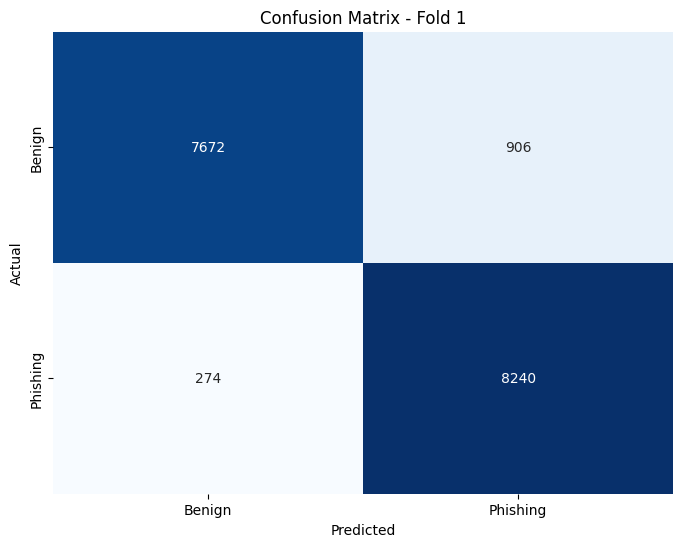


=== Fold 2/10 ===


Tokenizing:   0%|          | 0/153820 [00:00<?, ?text/s]

Tokenizing:   0%|          | 0/17092 [00:00<?, ?text/s]

Fold 2 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.2914, Val Loss = 0.2134, Train Accuracy = 86.52%, Val Accuracy = 90.66%, F1 Score = 0.9064, Precision = 0.9078, Recall = 0.9066, AUC-ROC = 0.9723, Epoch Time = 88.39 seconds
Saved best model for fold 2 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.1960, Val Loss = 0.1830, Train Accuracy = 90.88%, Val Accuracy = 91.87%, F1 Score = 0.9186, Precision = 0.9200, Recall = 0.9187, AUC-ROC = 0.9789, Epoch Time = 88.96 seconds
Saved best model for fold 2 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.1694, Val Loss = 0.1667, Train Accuracy = 91.93%, Val Accuracy = 92.52%, F1 Score = 0.9251, Precision = 0.9272, Recall = 0.9252, AUC-ROC = 0.9826, Epoch Time = 88.63 seconds
Saved best model for fold 2 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 4/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 4: Train Loss = 0.1544, Val Loss = 0.1706, Train Accuracy = 92.59%, Val Accuracy = 92.21%, F1 Score = 0.9218, Precision = 0.9268, Recall = 0.9221, AUC-ROC = 0.9828, Epoch Time = 89.88 seconds
Saved best model for fold 2 based on recall at epoch 4.


Training Epoch 5/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 5/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 5: Train Loss = 0.1432, Val Loss = 0.1584, Train Accuracy = 93.13%, Val Accuracy = 92.83%, F1 Score = 0.9281, Precision = 0.9302, Recall = 0.9283, AUC-ROC = 0.9837, Epoch Time = 89.61 seconds
Saved best model for fold 2 based on recall at epoch 5.


Training Epoch 6/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 6/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 6: Train Loss = 0.1378, Val Loss = 0.1594, Train Accuracy = 93.32%, Val Accuracy = 92.88%, F1 Score = 0.9287, Precision = 0.9309, Recall = 0.9288, AUC-ROC = 0.9834, Epoch Time = 89.29 seconds
Saved best model for fold 2 based on recall at epoch 6.


Training Epoch 7/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 7/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 7: Train Loss = 0.1334, Val Loss = 0.1579, Train Accuracy = 93.44%, Val Accuracy = 92.95%, F1 Score = 0.9294, Precision = 0.9316, Recall = 0.9295, AUC-ROC = 0.9836, Epoch Time = 90.01 seconds
Saved best model for fold 2 based on recall at epoch 7.


Training Epoch 8/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 8/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 8: Train Loss = 0.1308, Val Loss = 0.1585, Train Accuracy = 93.52%, Val Accuracy = 93.01%, F1 Score = 0.9300, Precision = 0.9314, Recall = 0.9301, AUC-ROC = 0.9839, Epoch Time = 89.27 seconds
Saved best model for fold 2 based on recall at epoch 8.


Training Epoch 9/20:   0%|          | 0/1202 [00:00<?, ?it/s]

In [ ]:
# Suppress warnings and set logging
logging.basicConfig(level=logging.ERROR)
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", module="torch.utils.data.dataloader")
# Redirect stderr to /dev/null
sys.stderr = open(os.devnull, 'w')

# Constants (Updated with best parameters)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 128
lr = 5e-5
k_folds = 10
num_epochs = 20
num_workers = 4
dim_feedforward = 512 #default
num_attention_heads = 8 #default
num_layers = 6 #default

# Mixed precision scaler
scaler = torch.cuda.amp.GradScaler()

# Custom Transformer-based model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=num_attention_heads, dim_feedforward=dim_feedforward, num_layers=num_layers):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output

def tokenize_data(texts, tokenizer, max_length=64):
    # Membuat progress bar untuk proses tokenisasi
    tokenized_results = []

    with tqdm(total=len(texts), desc="Tokenizing", unit="text") as pbar:
        for text in texts:
            # Lakukan tokenisasi untuk setiap teks
            encoded = tokenizer(
                text,
                truncation=True,
                padding='max_length',
                return_tensors='pt',
                max_length=max_length
            )
            tokenized_results.append(encoded)
            pbar.update(1)

    # Menggabungkan hasil tokenisasi
    keys = tokenized_results[0].keys()
    merged_tokenized = {
        key: torch.cat([result[key] for result in tokenized_results], dim=0)
        for key in keys
    }

    return merged_tokenized

# Update your train_and_evaluate function to log epoch time
def train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels, accumulation_steps=4):
    model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0.01)

    best_val_accuracy = 0
    fold_metrics = []

    # Convert y_val to numpy array
    y_val_np = y_val.values if hasattr(y_val, 'values') else np.array(y_val)

    for epoch in tqdm(range(num_epochs), desc=f'Fold {fold} - Epoch', leave=False):
        start_epoch_time = time.time()

        model.train()
        total_train_loss = 0
        train_predictions = []
        train_labels = []
        optimizer.zero_grad()

        with tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{num_epochs}", leave=False) as t_train:
            for batch_idx, batch in enumerate(t_train):
                input_ids, attention_mask, labels = [b.to(device) for b in batch]

                with torch.cuda.amp.autocast():
                    outputs = model(input_ids, attention_mask)
                    loss = criterion(outputs, labels)

                scaler.scale(loss).backward()

                if (batch_idx + 1) % accumulation_steps == 0 or (batch_idx + 1) == len(train_loader):
                    scaler.step(optimizer)
                    scaler.update()
                    optimizer.zero_grad()

                total_train_loss += loss.item()
                train_predictions.extend(torch.argmax(outputs, dim=1).cpu().numpy())
                train_labels.extend(labels.cpu().numpy())
                t_train.set_postfix({"Train Loss": loss.item()})

        avg_train_loss = total_train_loss / len(train_loader)
        train_accuracy = accuracy_score(train_labels, train_predictions)

        # Evaluation phase
        model.eval()
        val_predictions = []
        val_probs = []
        total_val_loss = 0

        with tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}", leave=False) as t_val:
            with torch.no_grad():
                for batch in t_val:
                    input_ids, attention_mask, labels = [b.to(device) for b in batch]
                    with torch.cuda.amp.autocast():
                        outputs = model(input_ids, attention_mask)
                        loss = criterion(outputs, labels)
                    total_val_loss += loss.item()
                    batch_probs = torch.softmax(outputs, dim=1)
                    batch_predictions = torch.argmax(outputs, dim=1)
                    val_predictions.extend(batch_predictions.cpu().numpy())
                    val_probs.extend(batch_probs.cpu().numpy())
                    t_val.set_postfix({"Val Loss": loss.item()})

        avg_val_loss = total_val_loss / len(val_loader)

        val_predictions_np = np.array(val_predictions)
        val_probs_np = np.array(val_probs)

        val_accuracy = accuracy_score(y_val_np, val_predictions_np)
        f1 = f1_score(y_val_np, val_predictions_np, average='weighted')
        precision = precision_score(y_val_np, val_predictions_np, average='weighted')
        recall = recall_score(y_val_np, val_predictions_np, average='weighted')

        y_val_onehot = F.one_hot(torch.LongTensor(y_val_np), num_classes=num_labels).numpy()
        try:
            auc_roc = roc_auc_score(y_val_onehot, val_probs_np, multi_class='ovr')
        except ValueError:
            auc_roc = 0

        conf_matrix = confusion_matrix(y_val_np, val_predictions_np)

        epoch_time = time.time() - start_epoch_time
        print(f"Epoch {epoch + 1}: Train Loss = {avg_train_loss:.4f}, Val Loss = {avg_val_loss:.4f}, "
              f"Train Accuracy = {train_accuracy * 100:.2f}%, Val Accuracy = {val_accuracy * 100:.2f}%, "
              f"F1 Score = {f1:.4f}, Precision = {precision:.4f}, Recall = {recall:.4f}, "
              f"AUC-ROC = {auc_roc:.4f}, Epoch Time = {epoch_time:.2f} seconds")

        fold_metrics.append({
            'epoch': epoch + 1,
            'train_loss': avg_train_loss,
            'val_loss': avg_val_loss,
            'train_accuracy': train_accuracy,  # Train accuracy
            'val_accuracy': val_accuracy,      # Validation accuracy
            'f1_score': f1,
            'precision': precision,
            'recall': recall,
            'auc_roc': auc_roc,
            'epoch_time': epoch_time
        })

        # Inside train_and_evaluate function
        local_model_dir = './best_models_smote_nontune'
        os.makedirs(local_model_dir, exist_ok=True)  # Membuat direktori jika belum ada
        best_recall = -1  # Initialize best_recall

        # In the loop where you're evaluating the model's metrics
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Find the best recall for the fold
        if fold_best_recall > best_recall:

            best_recall = fold_best_recall
            # best_model_path = os.path.join(local_model_dir, f'best_model_smote_nontune_fold_{fold}.pth')
            best_model_path = f'best_model_smote_nontune_fold_{fold}.pth'
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model for fold {fold} based on recall at epoch {epoch + 1}.")



    fold_total_time = sum(fm['epoch_time'] for fm in fold_metrics)
    print(f"\nTotal training time for Fold {fold}: {fold_total_time:.2f} seconds")

    conf_matrix = confusion_matrix(y_val_np, val_predictions_np)
    print(f"\nConfusion Matrix for Fold {fold}:")
    plot_confusion_matrix(conf_matrix, labels=['Benign', 'Phishing'], fold=fold)

    return fold_metrics, conf_matrix, best_model_path



def main():
    start_time = time.time()
    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)
    tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')
    num_labels = len(y_train_bin.unique())

    vectorizer = TfidfVectorizer(max_features=5000)
    X_train_vectorized = vectorizer.fit_transform(X_train_bin)

    smote = SMOTE(random_state=42)
    X_train_balanced, y_train_balanced = smote.fit_resample(X_train_vectorized, y_train_bin)

    feature_names = np.array(vectorizer.get_feature_names_out())
    X_train_balanced_texts = [
        " ".join(feature_names[row.indices]) for row in tqdm(X_train_balanced, desc="Processing Texts")
    ]

    all_fold_metrics = []
    all_confusion_matrices = []
    best_fold_info = None
    best_overall_val_accuracy = 0
    best_overall_recall = -1  # Initialize best_overall_recall before using it

    for fold, (train_index, val_index) in enumerate(kf.split(X_train_balanced_texts), 1):
        print(f"\n=== Fold {fold}/{k_folds} ===")
        X_train = [X_train_balanced_texts[i] for i in train_index]
        X_val = [X_train_balanced_texts[i] for i in val_index]
        y_train = y_train_balanced.iloc[train_index]
        y_val = y_train_balanced.iloc[val_index]

        train_encodings = tokenize_data(X_train, tokenizer)
        val_encodings = tokenize_data(X_val, tokenizer)

        y_train_tensor = torch.LongTensor(y_train.values)
        y_val_tensor = torch.LongTensor(y_val.values)
        train_dataset = TensorDataset(train_encodings['input_ids'], train_encodings['attention_mask'], y_train_tensor)
        val_dataset = TensorDataset(val_encodings['input_ids'], val_encodings['attention_mask'], y_val_tensor)

        train_loader = DataLoader(
            train_dataset, batch_size=batch_size, shuffle=True, pin_memory=True, num_workers=num_workers
        )
        val_loader = DataLoader(
            val_dataset, batch_size=batch_size, shuffle=False, pin_memory=True, num_workers=num_workers
        )

        fold_metrics, conf_matrix, best_model_path = train_and_evaluate(
            fold, train_loader, val_loader, y_train, y_val, tokenizer.vocab_size, num_labels
        )

        all_fold_metrics.append(fold_metrics)
        all_confusion_matrices.append(conf_matrix)

        # Dapatkan fold terbaik
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Menggunakan recall terbaik
        if fold_best_recall > best_overall_recall:
            best_overall_recall = fold_best_recall
            best_fold_info = {
                'fold': fold,
                'best_model_path': best_model_path,
                'metrics': fold_metrics
            }
        elif fold_best_recall == best_overall_recall:
            fold_best_accuracy = max(fm['val_accuracy'] for fm in fold_metrics)  # Menggunakan val_accuracy
            if fold_best_accuracy > best_overall_accuracy:
                best_overall_accuracy = fold_best_accuracy
                best_fold_info = {
                    'fold': fold,
                    'best_model_path': best_model_path,
                    'metrics': fold_metrics
                }

    total_time = time.time() - start_time
    print(f"\nTotal training time for all folds: {total_time:.2f} seconds")

    metrics_summary = {
        'train_loss': [],
        'val_loss': [],
        'train_accuracy': [],
        'val_accuracy': [],
        'f1_score': [],
        'precision': [],
        'recall': [],
        'auc_roc': []
    }

    for fold_metrics in all_fold_metrics:
        for metric_name in metrics_summary.keys():
            metrics_summary[metric_name].append(max(fm[metric_name] for fm in fold_metrics))

    print("\nRata-rata Metrik:")
    for metric_name, values in metrics_summary.items():
        print(f"{metric_name.replace('_', ' ').title()}: {np.mean(values):.4f} ± {np.std(values):.4f}")

    if best_fold_info:
        print(f"\n=== Informasi Fold Terbaik ===")
        print(f"Fold: {best_fold_info['fold']}")
        print(f"Model Tersimpan di: {best_fold_info['best_model_path']}")
        print("Metrik Terbaik:")
        best_metrics = max(best_fold_info['metrics'], key=lambda x: x['val_accuracy'])
        for key, value in best_metrics.items():
            print(f"{key.replace('_', ' ').title()}: {value}")

    print("\n=== Confusion Matrix Keseluruhan ===")
    total_confusion_matrix = np.sum(all_confusion_matrices, axis=0)
    print(total_confusion_matrix)
    labels = ['Benign', 'Phishing']
    plot_confusion_matrix(total_confusion_matrix, labels, fold='Overall')



if __name__ == "__main__":
    main()


## CLASSIFICATION With Hyperparameter Tuning

In [ ]:
# Suppress specific warnings
logging.basicConfig(level=logging.ERROR)
warnings.filterwarnings("ignore")
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", module="torch.utils.data.dataloader")

# Redirect stderr to /dev/null
sys.stderr = open(os.devnull, 'w')

# Parameters for the best configuration
best_params = {
    'batch_size': 128,
    'dim_feedforward': 1024,
    'lr': 0.0002,
    'num_attention_heads': 8,
    'num_layers': 6
}
batch_size = best_params['batch_size']
lr = best_params['lr']
k_folds = 10
num_epochs = 20
num_workers = 4

# Mixed precision scaler
scaler = torch.cuda.amp.GradScaler()

# Custom Transformer-based model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output

def tokenize_data(texts, tokenizer, max_length=64):
    tokenized_results = []

    with tqdm(total=len(texts), desc="Tokenizing", unit="text") as pbar:
        for text in texts:
            encoded = tokenizer(
                text,
                truncation=True,
                padding='max_length',
                return_tensors='pt',
                max_length=max_length
            )
            tokenized_results.append(encoded)
            pbar.update(1)

    keys = tokenized_results[0].keys()
    merged_tokenized = {
        key: torch.cat([result[key] for result in tokenized_results], dim=0)
        for key in keys
    }

    return merged_tokenized

def train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, input_dim, num_labels, accumulation_steps=4):
    """
    Fungsi utama untuk training dan evaluasi yang menangani checkpoint.
    """
    accumulation_steps = int(accumulation_steps)

    model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
    criterion = nn.CrossEntropyLoss()
    optimizer = AdamW(model.parameters(), lr=lr, weight_decay=0.01)
    scaler = torch.cuda.amp.GradScaler()

    checkpoint_path = f"checkpoint_fold_{fold}.pth"
    start_epoch = 0
    best_val_accuracy = 0

    # Memuat checkpoint jika ada
    if os.path.exists(checkpoint_path):
        print(f"Melanjutkan dari checkpoint {checkpoint_path}")
        start_epoch, best_val_accuracy = load_checkpoint(model, optimizer, scaler, checkpoint_path)

    fold_metrics = []
    y_val_np = y_val.values if hasattr(y_val, 'values') else np.array(y_val)

    # Inisialisasi val_predictions_np dan val_probs_np untuk menghindari error jika validasi gagal
    val_predictions_np = []
    val_probs_np = []

    for epoch in tqdm(range(start_epoch, num_epochs), desc=f'Fold {fold} - Epoch', leave=False):
        start_epoch_time = time.time()

        model.train()
        total_train_loss = 0
        train_predictions = []
        train_labels = []
        optimizer.zero_grad()

        with tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{num_epochs}", leave=False) as t_train:
            for batch_idx, batch in enumerate(t_train):
                input_ids, attention_mask, labels = [b.to(device) for b in batch]

                with torch.cuda.amp.autocast():
                    outputs = model(input_ids, attention_mask)
                    loss = criterion(outputs, labels)

                scaler.scale(loss).backward()

                if (batch_idx + 1) % accumulation_steps == 0 or (batch_idx + 1) == len(train_loader):
                    scaler.step(optimizer)
                    scaler.update()
                    optimizer.zero_grad()

                total_train_loss += loss.item()
                train_predictions.extend(torch.argmax(outputs, dim=1).cpu().numpy())
                train_labels.extend(labels.cpu().numpy())
                t_train.set_postfix({"Train Loss": loss.item()})

        avg_train_loss = total_train_loss / len(train_loader)
        train_accuracy = accuracy_score(train_labels, train_predictions)

        # Evaluation phase
        model.eval()
        total_val_loss = 0

        with tqdm(val_loader, desc=f"Validation Epoch {epoch + 1}/{num_epochs}", leave=False) as t_val:
            with torch.no_grad():
                for batch in t_val:
                    input_ids, attention_mask, labels = [b.to(device) for b in batch]
                    with torch.cuda.amp.autocast():
                        outputs = model(input_ids, attention_mask)
                        loss = criterion(outputs, labels)
                    total_val_loss += loss.item()
                    batch_probs = torch.softmax(outputs, dim=1)
                    batch_predictions = torch.argmax(outputs, dim=1)
                    val_predictions_np.extend(batch_predictions.cpu().numpy())
                    val_probs_np.extend(batch_probs.cpu().numpy())
                    t_val.set_postfix({"Val Loss": loss.item()})

        avg_val_loss = total_val_loss / len(val_loader)

        val_accuracy = accuracy_score(y_val_np, val_predictions_np)
        f1 = f1_score(y_val_np, val_predictions_np, average='weighted')
        precision = precision_score(y_val_np, val_predictions_np, average='weighted')
        recall = recall_score(y_val_np, val_predictions_np, average='weighted')

        y_val_onehot = F.one_hot(torch.LongTensor(y_val_np), num_classes=num_labels).numpy()
        try:
            auc_roc = roc_auc_score(y_val_onehot, val_probs_np, multi_class='ovr')
        except ValueError:
            auc_roc = 0

        # Simpan checkpoint di akhir setiap epoch
        save_checkpoint(epoch, model, optimizer, scaler, best_val_accuracy, checkpoint_path)

        conf_matrix = confusion_matrix(y_val_np, val_predictions_np)

        epoch_time = time.time() - start_epoch_time
        print(f"Epoch {epoch + 1}: Train Loss = {avg_train_loss:.4f}, Val Loss = {avg_val_loss:.4f}, "
              f"Train Accuracy = {train_accuracy * 100:.2f}%, Val Accuracy = {val_accuracy * 100:.2f}%, "
              f"F1 Score = {f1:.4f}, Precision = {precision:.4f}, Recall = {recall:.4f}, "
              f"AUC-ROC = {auc_roc:.4f}, Epoch Time = {epoch_time:.2f} seconds")

        fold_metrics.append({
            'epoch': epoch + 1,
            'train_loss': avg_train_loss,
            'val_loss': avg_val_loss,
            'train_accuracy': train_accuracy,  # Train accuracy
            'val_accuracy': val_accuracy,      # Validation accuracy
            'f1_score': f1,
            'precision': precision,
            'recall': recall,
            'auc_roc': auc_roc,
            'epoch_time': epoch_time
        })

        best_recall = -1  # Initialize best_recall

        # In the loop where you're evaluating the model's metrics
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Find the best recall for the fold
        if fold_best_recall > best_recall:
            best_recall = fold_best_recall
            best_model_path = f'best_model_smote_nontune_fold_{fold}.pth'
            torch.save(model.state_dict(), best_model_path)
            print(f"Saved best model for fold {fold} based on recall at epoch {epoch + 1}.")

    fold_total_time = sum(fm['epoch_time'] for fm in fold_metrics)
    print(f"\nTotal training time for Fold {fold}: {fold_total_time:.2f} seconds")

    conf_matrix = confusion_matrix(y_val_np, val_predictions_np)
    print(f"\nConfusion Matrix for Fold {fold}:")
    plot_confusion_matrix(conf_matrix, labels=['Benign', 'Phishing'], fold=fold)

    return fold_metrics, conf_matrix, best_model_path



def main():
    start_time = time.time()

    kf = KFold(n_splits=k_folds, shuffle=True, random_state=42)
    tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')
    num_labels = len(y_train_bin.unique())

    vectorizer = TfidfVectorizer(max_features=250)
    X_train_vectorized = vectorizer.fit_transform(X_train_bin)

    smote = SMOTE(random_state=42)
    X_train_balanced, y_train_balanced = smote.fit_resample(X_train_vectorized, y_train_bin)

    feature_names = np.array(vectorizer.get_feature_names_out())
    X_train_balanced_texts = [
        " ".join(feature_names[row.indices]) for row in tqdm(X_train_balanced, desc="Processing Texts")
    ]

    all_fold_metrics = []
    all_confusion_matrices = []
    best_fold_info = None
    best_overall_accuracy = 0
    best_overall_recall = -1  # Initialize best_overall_recall before using it

    for fold, (train_index, val_index) in enumerate(kf.split(X_train_balanced_texts), 1):
        print(f"\n=== Fold {fold}/{k_folds} ===")
        X_train = [X_train_balanced_texts[i] for i in train_index]
        X_val = [X_train_balanced_texts[i] for i in val_index]
        y_train = y_train_balanced.iloc[train_index]
        y_val = y_train_balanced.iloc[val_index]

        train_encodings = tokenize_data(X_train, tokenizer)
        val_encodings = tokenize_data(X_val, tokenizer)

        y_train_tensor = torch.LongTensor(y_train.values)
        y_val_tensor = torch.LongTensor(y_val.values)
        train_dataset = TensorDataset(train_encodings['input_ids'], train_encodings['attention_mask'], y_train_tensor)
        val_dataset = TensorDataset(val_encodings['input_ids'], val_encodings['attention_mask'], y_val_tensor)

        train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, pin_memory=True, num_workers=num_workers)
        val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, pin_memory=True, num_workers=num_workers)

        fold_metrics, conf_matrix, best_model_path = train_and_evaluate(fold, train_loader, val_loader, y_train, y_val, tokenizer.vocab_size, num_labels)

        print(f"\nConfusion Matrix for Fold {fold}:")
        print(conf_matrix)

        all_fold_metrics.append(fold_metrics)
        all_confusion_matrices.append(conf_matrix)

        # Dapatkan fold terbaik
        fold_best_recall = max(fm['recall'] for fm in fold_metrics)  # Menggunakan recall terbaik
        if fold_best_recall > best_overall_recall:
            best_overall_recall = fold_best_recall
            best_fold_info = {
                'fold': fold,
                'best_model_path': best_model_path,
                'metrics': fold_metrics
            }
        elif fold_best_recall == best_overall_recall:
            fold_best_accuracy = max(fm['val_accuracy'] for fm in fold_metrics)  # Menggunakan val_accuracy
            if fold_best_accuracy > best_overall_accuracy:
                best_overall_accuracy = fold_best_accuracy
                best_fold_info = {
                    'fold': fold,
                    'best_model_path': best_model_path,
                    'metrics': fold_metrics
                }

    total_time = time.time() - start_time
    print(f"\nTotal training time for all folds: {total_time:.2f} seconds")

    metrics_summary = {
        'train_loss': [],
        'val_loss': [],
        'train_accuracy': [],
        'val_accuracy': [],
        'f1_score': [],
        'precision': [],
        'recall': [],
        'auc_roc': []
    }

    for fold_metrics in all_fold_metrics:
        for metric_name in metrics_summary.keys():
            metrics_summary[metric_name].append(max(fm[metric_name] for fm in fold_metrics))

    print("\nRata-rata Metrik:")
    for metric_name, values in metrics_summary.items():
        print(f"{metric_name.replace('_', ' ').title()}: {np.mean(values):.4f} ± {np.std(values):.4f}")

    if best_fold_info:
        print(f"\n=== Informasi Fold Terbaik ===")
        print(f"Fold: {best_fold_info['fold']}")
        print(f"Model Tersimpan di: {best_fold_info['best_model_path']}")
        print("Metrik Terbaik:")
        best_metrics = max(best_fold_info['metrics'], key=lambda x: x['val_accuracy'])
        for key, value in best_metrics.items():
            print(f"{key.replace('_', ' ').title()}: {value}")

    print("\n=== Confusion Matrix Keseluruhan ===")
    total_confusion_matrix = np.sum(all_confusion_matrices, axis=0)
    print(total_confusion_matrix)
    labels = ['Benign', 'Phishing']
    plot_confusion_matrix(total_confusion_matrix, labels, fold='Overall')



if __name__ == "__main__":
    main()


Processing Texts: 0it [00:00, ?it/s]


=== Fold 1/10 ===


Tokenizing:   0%|          | 0/153820 [00:00<?, ?text/s]

Tokenizing:   0%|          | 0/17092 [00:00<?, ?text/s]

Fold 1 - Epoch:   0%|          | 0/20 [00:00<?, ?it/s]

Training Epoch 1/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 1/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 1: Train Loss = 0.3321, Val Loss = 0.2502, Train Accuracy = 84.80%, Val Accuracy = 87.77%, F1 Score = 0.8772, Precision = 0.8839, Recall = 0.8777, AUC-ROC = 0.9601, Epoch Time = 233.83 seconds
Saved best model for fold 1 based on recall at epoch 1.


Training Epoch 2/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 2/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 2: Train Loss = 0.2334, Val Loss = 0.2308, Train Accuracy = 88.16%, Val Accuracy = 88.34%, F1 Score = 0.8830, Precision = 0.8886, Recall = 0.8834, AUC-ROC = 0.9653, Epoch Time = 231.71 seconds
Saved best model for fold 1 based on recall at epoch 2.


Training Epoch 3/20:   0%|          | 0/1202 [00:00<?, ?it/s]

Validation Epoch 3/20:   0%|          | 0/134 [00:00<?, ?it/s]

Epoch 3: Train Loss = 0.2208, Val Loss = 0.2327, Train Accuracy = 88.57%, Val Accuracy = 88.40%, F1 Score = 0.8834, Precision = 0.8919, Recall = 0.8840, AUC-ROC = 0.9668, Epoch Time = 251.83 seconds
Saved best model for fold 1 based on recall at epoch 3.


Training Epoch 4/20:   0%|          | 0/1202 [00:00<?, ?it/s]

KeyboardInterrupt: 

# **DATA TESTING WITH BEST FOLD MODEL**

## Default NonTune

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(
<ipython-input-15-30d98265f1b5>:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you st

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/3 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Classification Report:
              precision    recall  f1-score   support

      Benign       0.96      0.97      0.97     36837
    Phishing       0.86      0.83      0.84      7966

    accuracy                           0.95     44803
   macro avg       0.91      0.90      0.90     44803
weighted avg       0.94      0.95      0.94     44803

AUC-ROC: 0.9663
Accuracy: 0.9450
Precision: 0.9443
Recall: 0.9450
F1 Score: 0.9446
Testing Time: 43.46 seconds


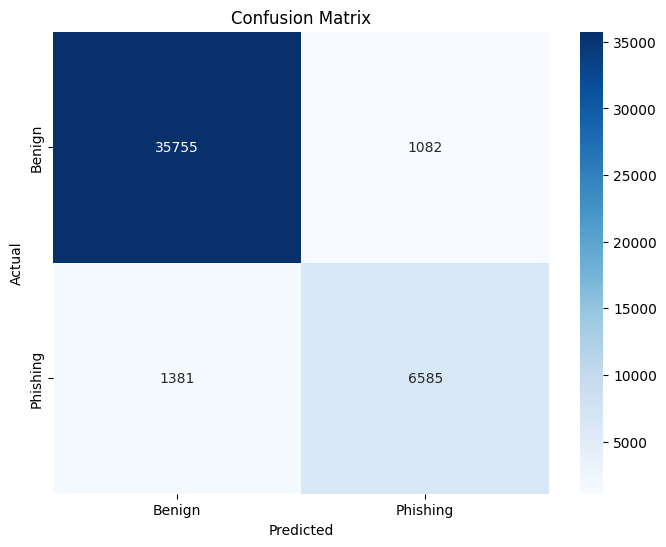


Metrics Summary:
Accuracy: 0.9450
Precision: 0.9443
Recall: 0.9450
F1 Score: 0.9446
AUC-ROC: 0.9663
Testing Time (s): 43.4608


In [ ]:
import torch
import torch.nn as nn
from transformers import BertTokenizer
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 128
model_path = "best_model_nontune_fold_3.pth"

# Load Best Model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        # Progress bar for token embedding
        with tqdm(total=input_ids.size(0), desc="Embedding Tokens", leave=False) as pbar:
            embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
            pbar.update(input_ids.size(0))  # Update the progress bar

        # Progress bar for transformer encoding
        with tqdm(total=embedded.size(1), desc="Encoding Layers", leave=False) as pbar:
            transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
            pbar.update(embedded.size(1))  # Update the progress bar

        # Pooling and linear layer
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))

        return output

# Load Model and Tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
input_dim = 30522  # Vocabulary size
num_labels = 2  # Adjust according to your classification task

model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

# Preprocess Testing Data
def tokenize_data(texts, tokenizer, max_length=64):
    return tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )

test_encodings = tokenize_data(list(X_test_bin), tokenizer)
y_test_tensor = torch.LongTensor(y_test_bin.values)

test_dataset = TensorDataset(
    test_encodings['input_ids'], test_encodings['attention_mask'], y_test_tensor
)
test_loader = DataLoader(
    test_dataset, batch_size=batch_size, shuffle=False, pin_memory=True
)


# Start Testing Timer
start_time = time.time()

# Evaluate on Test Data
all_predictions = []
all_probs = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        input_ids, attention_mask, labels = [b.to(device) for b in batch]
        outputs = model(input_ids, attention_mask)

        probs = torch.softmax(outputs, dim=1)
        predictions = torch.argmax(probs, dim=1)

        all_predictions.extend(predictions.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# End Testing Timer
end_time = time.time()
testing_time = end_time - start_time

# Calculate Metrics
y_true = np.array(all_labels)
y_pred = np.array(all_predictions)
y_probs = np.array(all_probs)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print("Classification Report:")
print(classification_report(y_true, y_pred, target_names=['Benign', 'Phishing']))

try:
    y_true_onehot = np.eye(num_labels)[y_true]
    auc_roc = roc_auc_score(y_true_onehot, y_probs, multi_class='ovr')
    print(f"AUC-ROC: {auc_roc:.4f}")
except ValueError:
    print("AUC-ROC could not be calculated.")

# Additional Metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Testing Time: {testing_time:.2f} seconds")

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'],
            yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Save Metrics for Logging
metrics = {
    "Accuracy": accuracy,
    "Precision": precision,
    "Recall": recall,
    "F1 Score": f1,
    "AUC-ROC": auc_roc if 'auc_roc' in locals() else None,
    "Testing Time (s)": testing_time
}

print("\nMetrics Summary:")
for k, v in metrics.items():
    print(f"{k}: {v:.4f}" if isinstance(v, float) else f"{k}: {v}")


## Default Tune

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(
<ipython-input-16-03b153bc07fa>:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you st

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/64 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/3 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Classification Report:
              precision    recall  f1-score   support

      Benign       0.98      0.98      0.98     36837
    Phishing       0.90      0.89      0.89      7966

    accuracy                           0.96     44803
   macro avg       0.94      0.93      0.94     44803
weighted avg       0.96      0.96      0.96     44803

AUC-ROC: 0.9839
Accuracy: 0.9627
Precision: 0.9625
Recall: 0.9627
F1 Score: 0.9626
Testing Time: 108.57 seconds


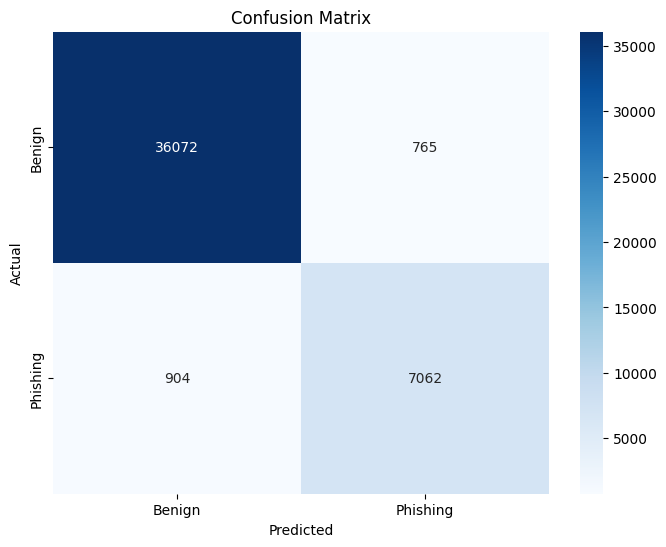


Metrics Summary:
Accuracy: 0.9627
Precision: 0.9625
Recall: 0.9627
F1 Score: 0.9626
AUC-ROC: 0.9839
Testing Time (s): 108.5679


In [ ]:
import torch
import torch.nn as nn
from transformers import BertTokenizer
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 64
model_path = "best_model_tune_fold_3.pth"

# Load Best Model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=1024, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        # Progress bar for token embedding
        with tqdm(total=input_ids.size(0), desc="Embedding Tokens", leave=False) as pbar:
            embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
            pbar.update(input_ids.size(0))  # Update the progress bar

        # Progress bar for transformer encoding
        with tqdm(total=embedded.size(1), desc="Encoding Layers", leave=False) as pbar:
            transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
            pbar.update(embedded.size(1))  # Update the progress bar

        # Pooling and linear layer
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))

        return output

# Load Model and Tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
input_dim = 30522  # Vocabulary size
num_labels = 2  # Adjust according to your classification task

model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

# Preprocess Testing Data
def tokenize_data(texts, tokenizer, max_length=64):
    return tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )

test_encodings = tokenize_data(list(X_test_bin), tokenizer)
y_test_tensor = torch.LongTensor(y_test_bin.values)

test_dataset = TensorDataset(
    test_encodings['input_ids'], test_encodings['attention_mask'], y_test_tensor
)
test_loader = DataLoader(
    test_dataset, batch_size=batch_size, shuffle=False, pin_memory=True
)


# Start Testing Timer
start_time = time.time()

# Evaluate on Test Data
all_predictions = []
all_probs = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        input_ids, attention_mask, labels = [b.to(device) for b in batch]
        outputs = model(input_ids, attention_mask)

        probs = torch.softmax(outputs, dim=1)
        predictions = torch.argmax(probs, dim=1)

        all_predictions.extend(predictions.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# End Testing Timer
end_time = time.time()
testing_time = end_time - start_time

# Calculate Metrics
y_true = np.array(all_labels)
y_pred = np.array(all_predictions)
y_probs = np.array(all_probs)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print("Classification Report:")
print(classification_report(y_true, y_pred, target_names=['Benign', 'Phishing']))

try:
    y_true_onehot = np.eye(num_labels)[y_true]
    auc_roc = roc_auc_score(y_true_onehot, y_probs, multi_class='ovr')
    print(f"AUC-ROC: {auc_roc:.4f}")
except ValueError:
    print("AUC-ROC could not be calculated.")

# Additional Metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Testing Time: {testing_time:.2f} seconds")

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'],
            yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Save Metrics for Logging
metrics = {
    "Accuracy": accuracy,
    "Precision": precision,
    "Recall": recall,
    "F1 Score": f1,
    "AUC-ROC": auc_roc if 'auc_roc' in locals() else None,
    "Testing Time (s)": testing_time
}

print("\nMetrics Summary:")
for k, v in metrics.items():
    print(f"{k}: {v:.4f}" if isinstance(v, float) else f"{k}: {v}")


## Smote Nontune

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:379: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(
<ipython-input-18-3a8192415951>:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you st

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/128 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Embedding Tokens:   0%|          | 0/3 [00:00<?, ?it/s]

Encoding Layers:   0%|          | 0/64 [00:00<?, ?it/s]

Classification Report:
              precision    recall  f1-score   support

      Benign       0.83      1.00      0.91     36837
    Phishing       0.94      0.04      0.07      7966

    accuracy                           0.83     44803
   macro avg       0.88      0.52      0.49     44803
weighted avg       0.85      0.83      0.76     44803

AUC-ROC: 0.7645
Accuracy: 0.8283
Precision: 0.8474
Recall: 0.8283
F1 Score: 0.7571
Testing Time: 30.29 seconds


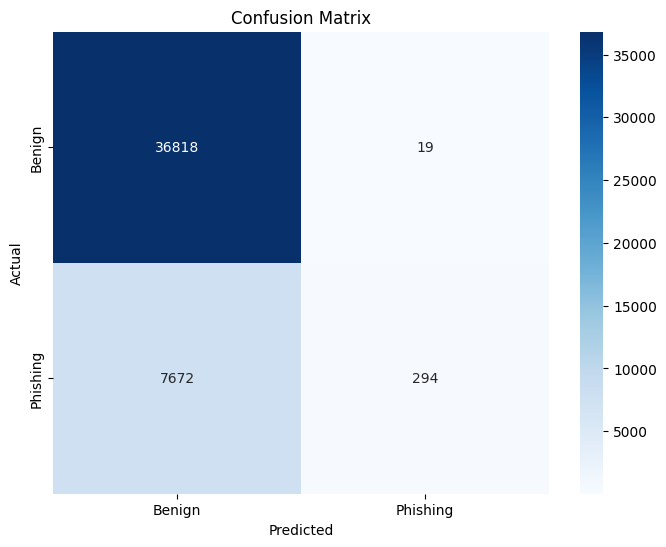


Metrics Summary:
Accuracy: 0.8283
Precision: 0.8474
Recall: 0.8283
F1 Score: 0.7571
AUC-ROC: 0.7645
Testing Time (s): 30.2893


In [ ]:
import torch
import torch.nn as nn
from transformers import BertTokenizer
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 128
model_path = "best_model_smote_nontune_fold_8.pth"

# Load Best Model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        # Progress bar for token embedding
        with tqdm(total=input_ids.size(0), desc="Embedding Tokens", leave=False) as pbar:
            embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
            pbar.update(input_ids.size(0))  # Update the progress bar

        # Progress bar for transformer encoding
        with tqdm(total=embedded.size(1), desc="Encoding Layers", leave=False) as pbar:
            transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
            pbar.update(embedded.size(1))  # Update the progress bar

        # Pooling and linear layer
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))

        return output

# Load Model and Tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
input_dim = 30522  # Vocabulary size
num_labels = 2  # Adjust according to your classification task

model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

# Preprocess Testing Data
def tokenize_data(texts, tokenizer, max_length=64):
    return tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )

test_encodings = tokenize_data(list(X_test_bin), tokenizer)
y_test_tensor = torch.LongTensor(y_test_bin.values)

test_dataset = TensorDataset(
    test_encodings['input_ids'], test_encodings['attention_mask'], y_test_tensor
)
test_loader = DataLoader(
    test_dataset, batch_size=batch_size, shuffle=False, pin_memory=True
)


# Start Testing Timer
start_time = time.time()

# Evaluate on Test Data
all_predictions = []
all_probs = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        input_ids, attention_mask, labels = [b.to(device) for b in batch]
        outputs = model(input_ids, attention_mask)

        probs = torch.softmax(outputs, dim=1)
        predictions = torch.argmax(probs, dim=1)

        all_predictions.extend(predictions.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# End Testing Timer
end_time = time.time()
testing_time = end_time - start_time

# Calculate Metrics
y_true = np.array(all_labels)
y_pred = np.array(all_predictions)
y_probs = np.array(all_probs)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print("Classification Report:")
print(classification_report(y_true, y_pred, target_names=['Benign', 'Phishing']))

try:
    y_true_onehot = np.eye(num_labels)[y_true]
    auc_roc = roc_auc_score(y_true_onehot, y_probs, multi_class='ovr')
    print(f"AUC-ROC: {auc_roc:.4f}")
except ValueError:
    print("AUC-ROC could not be calculated.")

# Additional Metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Testing Time: {testing_time:.2f} seconds")

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'],
            yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Save Metrics for Logging
metrics = {
    "Accuracy": accuracy,
    "Precision": precision,
    "Recall": recall,
    "F1 Score": f1,
    "AUC-ROC": auc_roc if 'auc_roc' in locals() else None,
    "Testing Time (s)": testing_time
}

print("\nMetrics Summary:")
for k, v in metrics.items():
    print(f"{k}: {v:.4f}" if isinstance(v, float) else f"{k}: {v}")


## Smote Tune

<ipython-input-10-a40c5596ecdd>:45: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Classification Report:
              precision    recall  f1-score   support

      Benign       0.89      0.99      0.94     36837
    Phishing       0.91      0.45      0.60      7966

    accuracy                           0.89     44803
   macro avg       0.90      0.72      0.77     44803
weighted avg       0.90      0.89      0.88     44803

AUC-ROC: 0.8643
Accuracy: 0.8947
Precision: 0.8962
Recall: 0.8947
F1 Score: 0.8798
Testing Time: 23.55 seconds


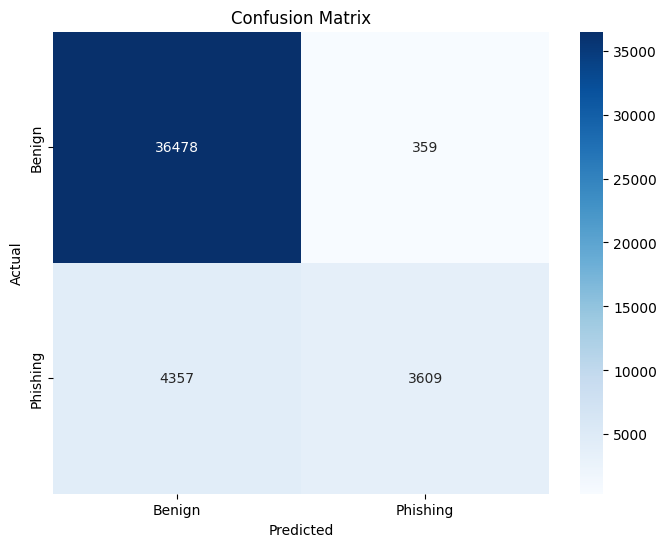


Metrics Summary:
Accuracy: 0.8947
Precision: 0.8962
Recall: 0.8947
F1 Score: 0.8798
AUC-ROC: 0.8643
Testing Time (s): 23.5460


In [ ]:
import torch
import torch.nn as nn
from transformers import BertTokenizer
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import classification_report, roc_auc_score, confusion_matrix
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Constants
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
batch_size = 64
model_path = "best_model_smote_tune_fold_8.pth"

# Load Best Model
class TransformerClassifier(nn.Module):
    def __init__(self, input_dim, num_labels, nhead=8, dim_feedforward=512, num_layers=6):
        super(TransformerClassifier, self).__init__()
        self.embedding = nn.Embedding(input_dim, dim_feedforward)
        encoder_layer = nn.TransformerEncoderLayer(
            d_model=dim_feedforward, nhead=nhead, dim_feedforward=dim_feedforward
        )
        self.transformer_encoder = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        self.fc = nn.Linear(dim_feedforward, num_labels)
        self.dropout = nn.Dropout(0.1)

    def forward(self, input_ids, attention_mask):
        embedded = self.embedding(input_ids) * attention_mask.unsqueeze(-1)
        transformed = self.transformer_encoder(embedded.permute(1, 0, 2))
        pooled_output = transformed.mean(dim=0)
        output = self.fc(self.dropout(pooled_output))
        return output


# Load Model and Tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
input_dim = 30522  # Vocabulary size
num_labels = 2  # Adjust according to your classification task

model = TransformerClassifier(input_dim=input_dim, num_labels=num_labels).to(device)
model.load_state_dict(torch.load(model_path, map_location=device))
model.eval()

# Preprocess Testing Data
def tokenize_data(texts, tokenizer, max_length=64):
    return tokenizer(
        texts, truncation=True, padding='max_length', return_tensors='pt', max_length=max_length
    )

test_encodings = tokenize_data(list(X_test_bin), tokenizer)
y_test_tensor = torch.LongTensor(y_test_bin.values)

test_dataset = TensorDataset(
    test_encodings['input_ids'], test_encodings['attention_mask'], y_test_tensor
)
test_loader = DataLoader(
    test_dataset, batch_size=batch_size, shuffle=False, pin_memory=True
)


# Start Testing Timer
start_time = time.time()

# Evaluate on Test Data
all_predictions = []
all_probs = []
all_labels = []

with torch.no_grad():
    for batch in test_loader:
        input_ids, attention_mask, labels = [b.to(device) for b in batch]
        outputs = model(input_ids, attention_mask)

        probs = torch.softmax(outputs, dim=1)
        predictions = torch.argmax(probs, dim=1)

        all_predictions.extend(predictions.cpu().numpy())
        all_probs.extend(probs.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

# End Testing Timer
end_time = time.time()
testing_time = end_time - start_time

# Calculate Metrics
y_true = np.array(all_labels)
y_pred = np.array(all_predictions)
y_probs = np.array(all_probs)

accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print("Classification Report:")
print(classification_report(y_true, y_pred, target_names=['Benign', 'Phishing']))

try:
    y_true_onehot = np.eye(num_labels)[y_true]
    auc_roc = roc_auc_score(y_true_onehot, y_probs, multi_class='ovr')
    print(f"AUC-ROC: {auc_roc:.4f}")
except ValueError:
    print("AUC-ROC could not be calculated.")

# Additional Metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"Testing Time: {testing_time:.2f} seconds")

# Confusion Matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Plot Confusion Matrix
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'],
            yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Save Metrics for Logging
metrics = {
    "Accuracy": accuracy,
    "Precision": precision,
    "Recall": recall,
    "F1 Score": f1,
    "AUC-ROC": auc_roc if 'auc_roc' in locals() else None,
    "Testing Time (s)": testing_time
}

print("\nMetrics Summary:")
for k, v in metrics.items():
    print(f"{k}: {v:.4f}" if isinstance(v, float) else f"{k}: {v}")


# **ANALISIS DAN VISUALISASI HASIL**

In [ ]:
# import os

# # Ensure the directory exists
# output_dir = '/content/gdrive/My Drive/ASDOS/template/Topik4_Phishing URL Detection Using BERT-Based Transformer Models/result/'
# os.makedirs(output_dir, exist_ok=True)

## Data Default Non Tune

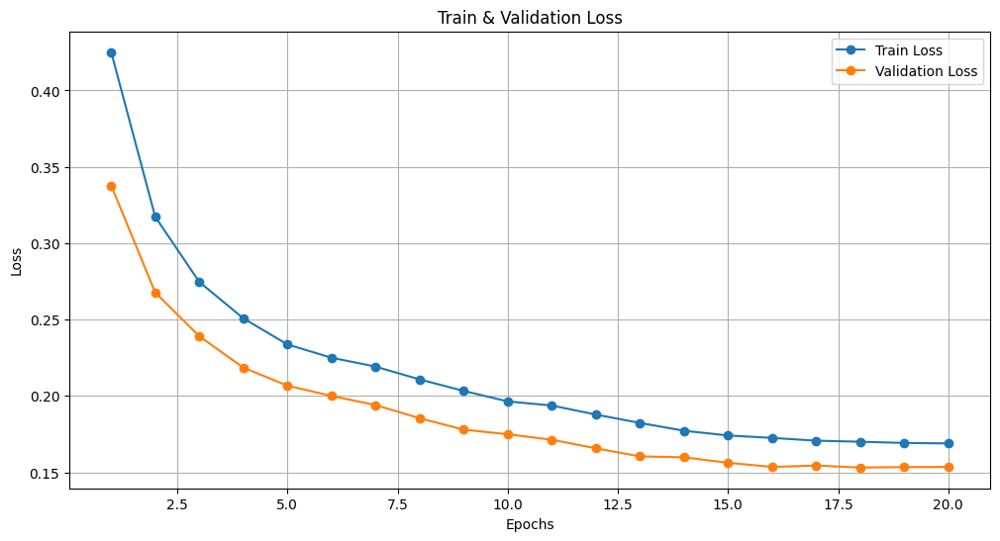

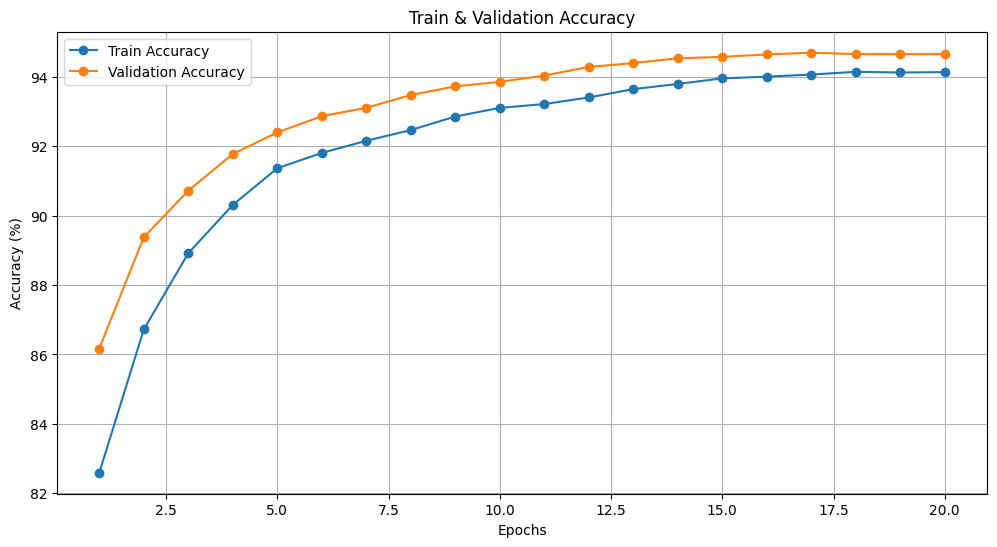

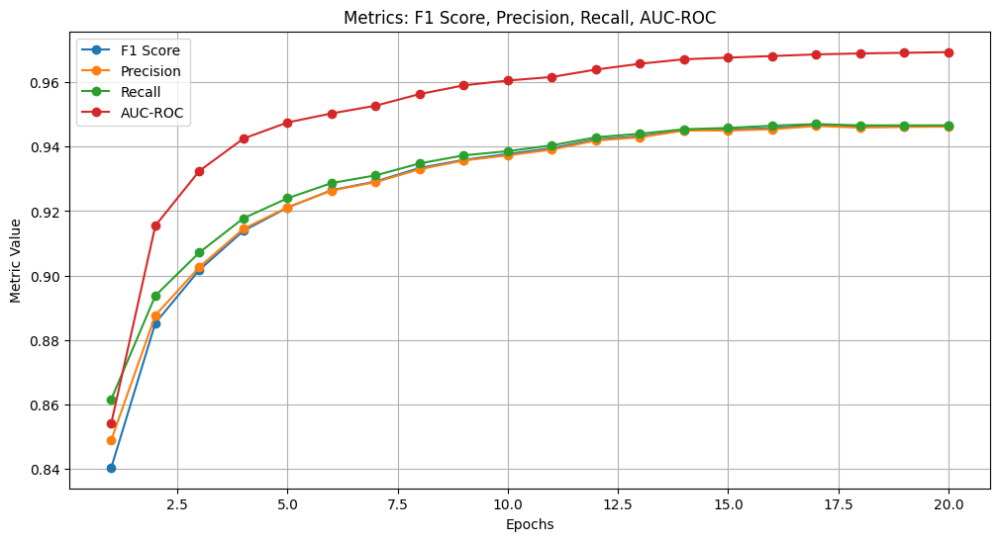

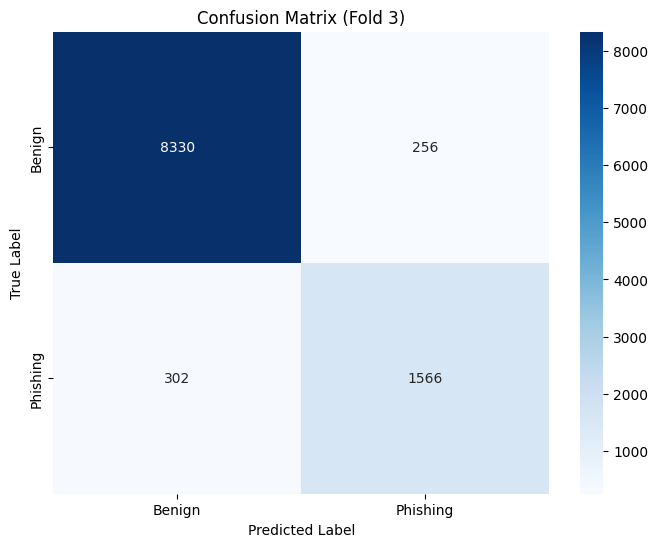

,Epoch,Train Loss,Train Accuracy (%),Validation Loss,Validation Accuracy (%),F1 Score,Precision,Recall,AUC-ROC
0,1,0.4251,82.59,0.3378,86.17,0.8405,0.8491,0.8617,0.8543
1,2,0.3173,86.72,0.2677,89.38,0.8853,0.8877,0.8938,0.9155
2,3,0.2746,88.92,0.2391,90.72,0.9018,0.9027,0.9072,0.9325
3,4,0.2508,90.31,0.2185,91.78,0.9139,0.9145,0.9178,0.9425
4,5,0.2337,91.37,0.2067,92.40,0.9211,0.9212,0.9240,0.9475
5,6,0.2250,91.81,0.2000,92.87,0.9265,0.9264,0.9287,0.9503
6,7,0.2192,92.16,0.1940,93.11,0.9292,0.9290,0.9311,0.9527
7,8,0.2108,92.47,0.1854,93.48,0.9334,0.9330,0.9348,0.9563
8,9,0.2033,92.86,0.1779,93.73,0.9359,0.9357,0.9373,0.9590
9,10,0.1964,93.11,0.1749,93.86,0.9377,0.9373,0.9386,0.9605


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Data dari log Fold 3
epochs = list(range(1, 21))
train_loss = [
    0.4251, 0.3173, 0.2746, 0.2508, 0.2337, 0.2250, 0.2192, 0.2108, 0.2033,
    0.1964, 0.1937, 0.1878, 0.1823, 0.1772, 0.1741, 0.1725, 0.1707, 0.1700,
    0.1692, 0.1689
]
val_loss = [
    0.3378, 0.2677, 0.2391, 0.2185, 0.2067, 0.2000, 0.1940, 0.1854, 0.1779,
    0.1749, 0.1713, 0.1657, 0.1604, 0.1598, 0.1562, 0.1535, 0.1544, 0.1531,
    0.1534, 0.1535
]
train_acc = [
    82.59, 86.72, 88.92, 90.31, 91.37, 91.81, 92.16, 92.47, 92.86, 93.11, 93.22,
    93.41, 93.65, 93.80, 93.96, 94.01, 94.07, 94.15, 94.13, 94.14
]
val_acc = [
    86.17, 89.38, 90.72, 91.78, 92.40, 92.87, 93.11, 93.48, 93.73, 93.86, 94.04,
    94.29, 94.40, 94.54, 94.58, 94.65, 94.70, 94.66, 94.66, 94.66
]
f1_scores = [
    0.8405, 0.8853, 0.9018, 0.9139, 0.9211, 0.9265, 0.9292, 0.9334, 0.9359,
    0.9377, 0.9395, 0.9422, 0.9432, 0.9451, 0.9453, 0.9457, 0.9467, 0.9462,
    0.9463, 0.9464
]
precisions = [
    0.8491, 0.8877, 0.9027, 0.9145, 0.9212, 0.9264, 0.9290, 0.9330, 0.9357,
    0.9373, 0.9391, 0.9419, 0.9429, 0.9450, 0.9450, 0.9454, 0.9464, 0.9459,
    0.9461, 0.9462
]
recalls = [
    0.8617, 0.8938, 0.9072, 0.9178, 0.9240, 0.9287, 0.9311, 0.9348, 0.9373,
    0.9386, 0.9404, 0.9429, 0.9440, 0.9454, 0.9458, 0.9465, 0.9470, 0.9466,
    0.9466, 0.9466
]
auc_rocs = [
    0.8543, 0.9155, 0.9325, 0.9425, 0.9475, 0.9503, 0.9527, 0.9563, 0.9590,
    0.9605, 0.9616, 0.9639, 0.9657, 0.9671, 0.9676, 0.9681, 0.9686, 0.9689,
    0.9691, 0.9693
]

# Confusion matrix data
confusion_matrix = np.array([[8330, 256], [302, 1566]])

# Plotting train/val loss
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
plt.title('Train & Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# Plotting train/val accuracy
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='o')
plt.title('Train & Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid()
plt.show()

# Plotting other metrics
plt.figure(figsize=(12, 6))
plt.plot(epochs, f1_scores, label='F1 Score', marker='o')
plt.plot(epochs, precisions, label='Precision', marker='o')
plt.plot(epochs, recalls, label='Recall', marker='o')
plt.plot(epochs, auc_rocs, label='AUC-ROC', marker='o')
plt.title('Metrics: F1 Score, Precision, Recall, AUC-ROC')
plt.xlabel('Epochs')
plt.ylabel('Metric Value')
plt.legend()
plt.grid()
plt.show()

# Plotting confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'], yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix (Fold 3)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display log table for Fold 3
data = {
    "Epoch": epochs,
    "Train Loss": train_loss,
    "Train Accuracy (%)": train_acc,
    "Validation Loss": val_loss,
    "Validation Accuracy (%)": val_acc,
    "F1 Score": f1_scores,
    "Precision": precisions,
    "Recall": recalls,
    "AUC-ROC": auc_rocs
}
log_table = pd.DataFrame(data)
log_table


---

 **Performansi Terbaik**
**Fold Terbaik**: **Fold 3**  
**Epoch Terbaik (Fold 3)**: **Epoch 17**  

| **Metric**         | **Value**      |
|---------------------|----------------|
| **Train Loss**      | 0.1707         |
| **Train Accuracy**  | 94.07%         |
| **Validation Loss** | 0.1544         |
| **Validation Accuracy** | 94.70%     |
| **F1 Score**        | 0.9467         |
| **Precision**       | 0.9464         |
| **Recall**          | 0.9470         |
| **AUC-ROC**         | 0.9686         |

---

 **Rata-rata Performa Semua Fold**

| **Metric**          | **Mean ± Std**          |
|----------------------|-------------------------|
| **Train Loss**       | 0.4510 ± 0.0297         |
| **Train Accuracy**   | 94.32% ± 0.14%          |
| **Validation Loss**  | 0.3554 ± 0.0274         |
| **Validation Accuracy** | 94.32% ± 0.25%       |
| **F1 Score**         | 0.9425 ± 0.0027         |
| **Precision**        | 0.9422 ± 0.0027         |
| **Recall**           | 0.9432 ± 0.0025         |
| **AUC-ROC**          | 0.9648 ± 0.0026         |

---

 **Confusion Matrix Keseluruhan**

| **Type**              | **Value**  |
|------------------------|------------|
| **True Positives (TP)** | 15,537    |
| **True Negatives (TN)** | 83,056    |
| **False Positives (FP)** | 2,400    |
| **False Negatives (FN)** | 3,547    |

---


## Data Default Tune

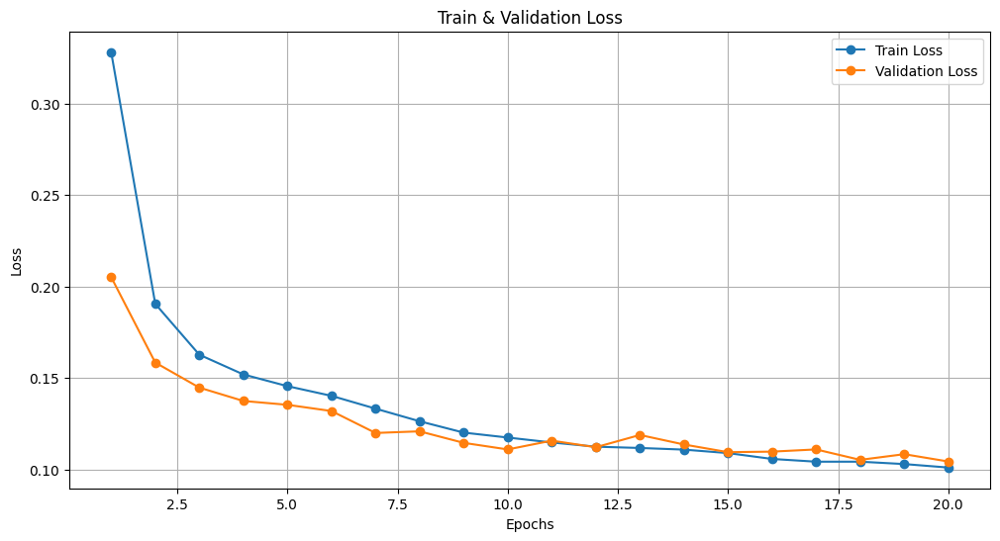

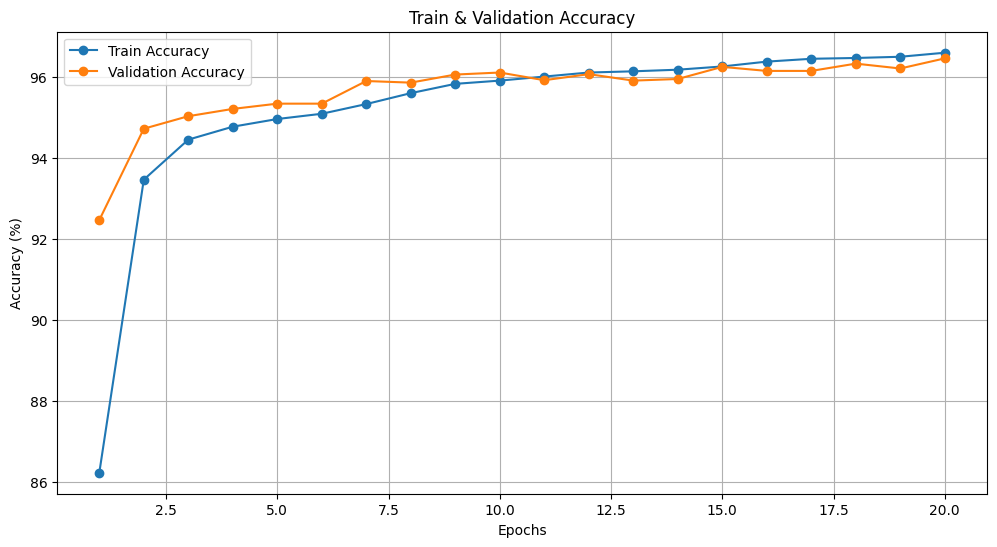

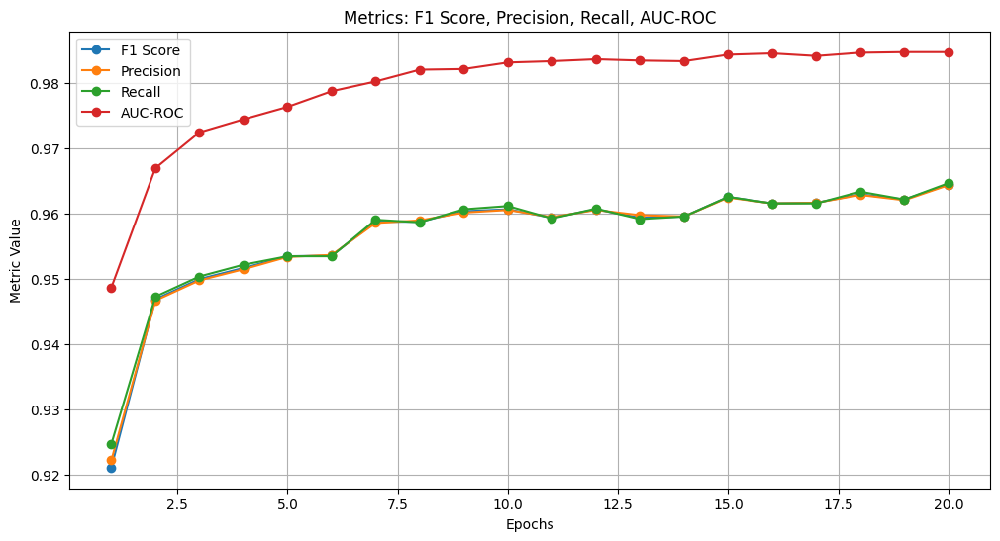

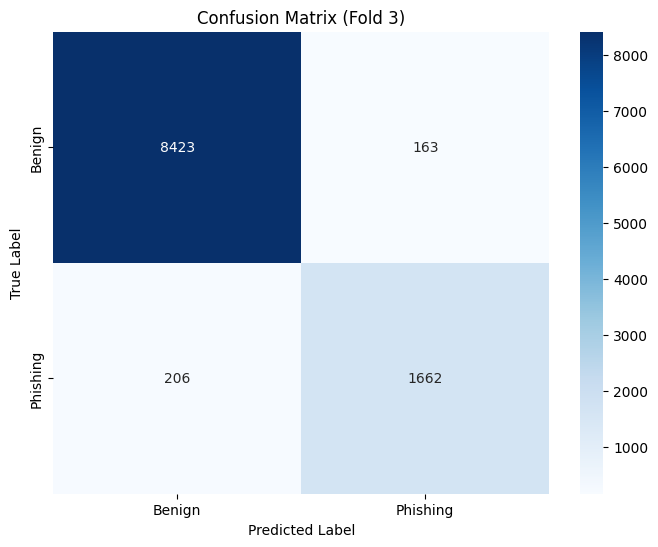

,Epoch,Train Loss,Train Accuracy (%),Validation Loss,Validation Accuracy (%),F1 Score,Precision,Recall,AUC-ROC
0,1,0.3282,86.22,0.2052,92.47,0.9211,0.9222,0.9247,0.9487
1,2,0.1906,93.47,0.1585,94.73,0.9469,0.9467,0.9473,0.9670
2,3,0.1628,94.46,0.1448,95.04,0.9500,0.9498,0.9504,0.9725
3,4,0.1520,94.78,0.1375,95.22,0.9517,0.9515,0.9522,0.9745
4,5,0.1456,94.97,0.1354,95.35,0.9535,0.9534,0.9535,0.9764
5,6,0.1403,95.10,0.1320,95.35,0.9536,0.9537,0.9535,0.9788
6,7,0.1333,95.34,0.1200,95.91,0.9588,0.9586,0.9591,0.9803
7,8,0.1264,95.61,0.1209,95.87,0.9588,0.9590,0.9587,0.9821
8,9,0.1202,95.84,0.1146,96.07,0.9604,0.9602,0.9607,0.9822
9,10,0.1175,95.92,0.1110,96.12,0.9607,0.9606,0.9612,0.9832


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Data dari log Fold 3
epochs = list(range(1, 21))
train_loss = [
    0.3282, 0.1906, 0.1628, 0.1520, 0.1456, 0.1403, 0.1333, 0.1264, 0.1202, 0.1175,
    0.1148, 0.1125, 0.1118, 0.1109, 0.1090, 0.1058, 0.1043, 0.1043, 0.1030, 0.1011
]
val_loss = [
    0.2052, 0.1585, 0.1448, 0.1375, 0.1354, 0.1320, 0.1200, 0.1209, 0.1146, 0.1110,
    0.1158, 0.1122, 0.1189, 0.1137, 0.1095, 0.1098, 0.1110, 0.1053, 0.1084, 0.1044
]
train_acc = [
    86.22, 93.47, 94.46, 94.78, 94.97, 95.10, 95.34, 95.61, 95.84, 95.92,
    96.02, 96.12, 96.15, 96.19, 96.27, 96.39, 96.46, 96.48, 96.51, 96.61
]
val_acc = [
    92.47, 94.73, 95.04, 95.22, 95.35, 95.35, 95.91, 95.87, 96.07, 96.12,
    95.93, 96.08, 95.92, 95.96, 96.26, 96.16, 96.16, 96.34, 96.22, 96.47
]
f1_scores = [
    0.9211, 0.9469, 0.9500, 0.9517, 0.9535, 0.9536, 0.9588, 0.9588, 0.9604, 0.9607,
    0.9594, 0.9607, 0.9594, 0.9596, 0.9626, 0.9616, 0.9617, 0.9630, 0.9622, 0.9645
]
precisions = [
    0.9222, 0.9467, 0.9498, 0.9515, 0.9534, 0.9537, 0.9586, 0.9590, 0.9602, 0.9606,
    0.9595, 0.9606, 0.9598, 0.9596, 0.9625, 0.9616, 0.9617, 0.9629, 0.9621, 0.9644
]
recalls = [
    0.9247, 0.9473, 0.9504, 0.9522, 0.9535, 0.9535, 0.9591, 0.9587, 0.9607, 0.9612,
    0.9593, 0.9608, 0.9592, 0.9596, 0.9626, 0.9616, 0.9616, 0.9634, 0.9622, 0.9647
]
auc_rocs = [
    0.9487, 0.9670, 0.9725, 0.9745, 0.9764, 0.9788, 0.9803, 0.9821, 0.9822, 0.9832,
    0.9834, 0.9837, 0.9835, 0.9834, 0.9844, 0.9846, 0.9842, 0.9847, 0.9848, 0.9848
]

# Confusion matrix data
confusion_matrix = np.array([[8423, 163], [206, 1662]])

# Plotting train/val loss
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
plt.title('Train & Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# Plotting train/val accuracy
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='o')
plt.title('Train & Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid()
plt.show()

# Plotting other metrics
plt.figure(figsize=(12, 6))
plt.plot(epochs, f1_scores, label='F1 Score', marker='o')
plt.plot(epochs, precisions, label='Precision', marker='o')
plt.plot(epochs, recalls, label='Recall', marker='o')
plt.plot(epochs, auc_rocs, label='AUC-ROC', marker='o')
plt.title('Metrics: F1 Score, Precision, Recall, AUC-ROC')
plt.xlabel('Epochs')
plt.ylabel('Metric Value')
plt.legend()
plt.grid()
plt.show()

# Plotting confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'], yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix (Fold 3)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display log table for Fold 3
data = {
    "Epoch": epochs,
    "Train Loss": train_loss,
    "Train Accuracy (%)": train_acc,
    "Validation Loss": val_loss,
    "Validation Accuracy (%)": val_acc,
    "F1 Score": f1_scores,
    "Precision": precisions,
    "Recall": recalls,
    "AUC-ROC": auc_rocs
}
log_table = pd.DataFrame(data)
log_table


---

 **Performansi Terbaik**
**Fold Terbaik**: **Fold 3**  
**Epoch Terbaik (Fold 3)**: **Epoch 20**  

| **Metric**         | **Value**        |
|---------------------|------------------|
| **Train Loss**      | 0.1011           |
| **Train Accuracy**  | 96.61%           |
| **Validation Loss** | 0.1044           |
| **Validation Accuracy** | 96.47%       |
| **F1 Score**        | 0.9645           |
| **Precision**       | 0.9644           |
| **Recall**          | 0.9647           |
| **AUC-ROC**         | 0.9848           |

---

 **Rata-rata Performa Semua Fold**

| **Metric**          | **Mean ± Std**          |
|----------------------|-------------------------|
| **Train Loss**       | 0.3396 ± 0.0291         |
| **Train Accuracy**   | 96.42% ± 0.16%          |
| **Validation Loss**  | 0.2335 ± 0.0319         |
| **Validation Accuracy** | 95.96% ± 0.22%       |
| **F1 Score**         | 0.9594 ± 0.0022         |
| **Precision**        | 0.9594 ± 0.0022         |
| **Recall**           | 0.9596 ± 0.0022         |
| **AUC-ROC**          | 0.9815 ± 0.0015         |

---

 **Confusion Matrix Keseluruhan**

| **Type**              | **Value**  |
|------------------------|------------|
| **True Positives (TP)** | 16,870    |
| **True Negatives (TN)** | 83,359    |
| **False Positives (FP)** | 2,097    |
| **False Negatives (FN)** | 2,214    |

---

 **Waktu Pelatihan**

- **Total Training Time for All Folds**: **41,041.62 seconds**  
- **Best Model Saved At**: **`best_model_tune_fold_3.pth`**

## Data Balanced Non Tune

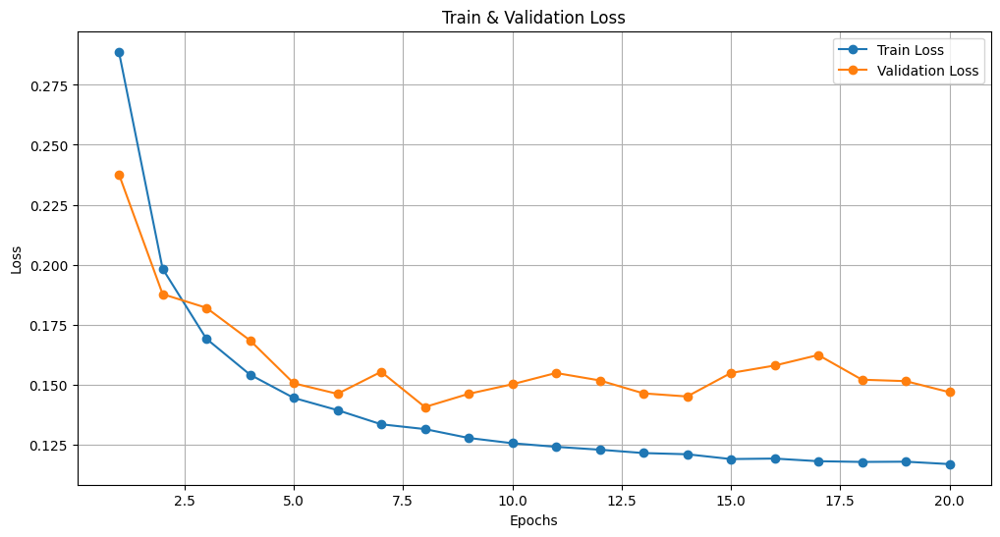

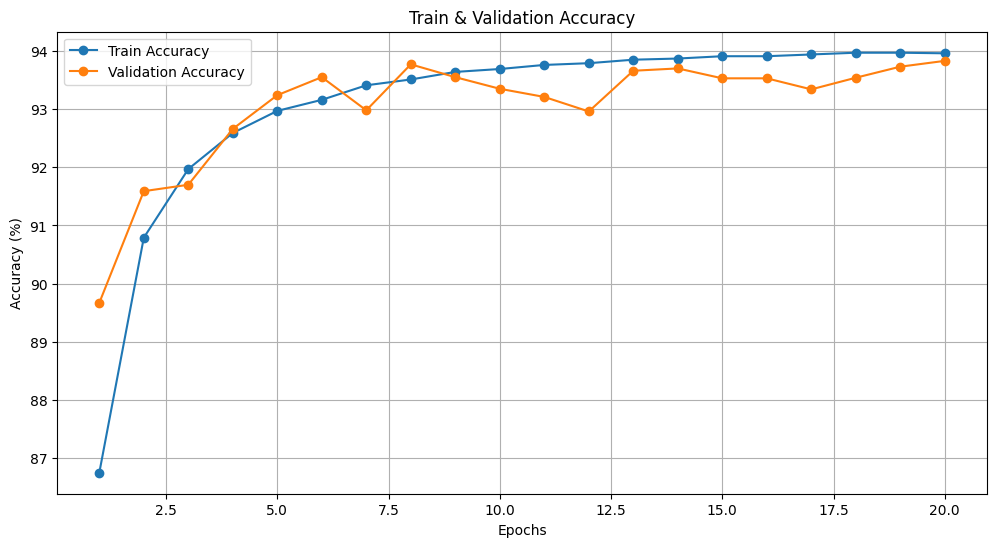

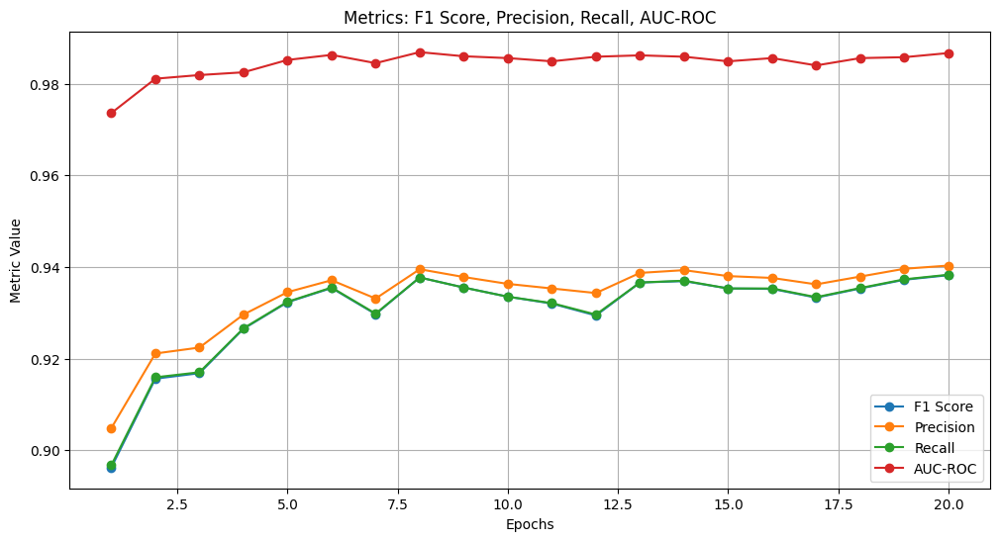

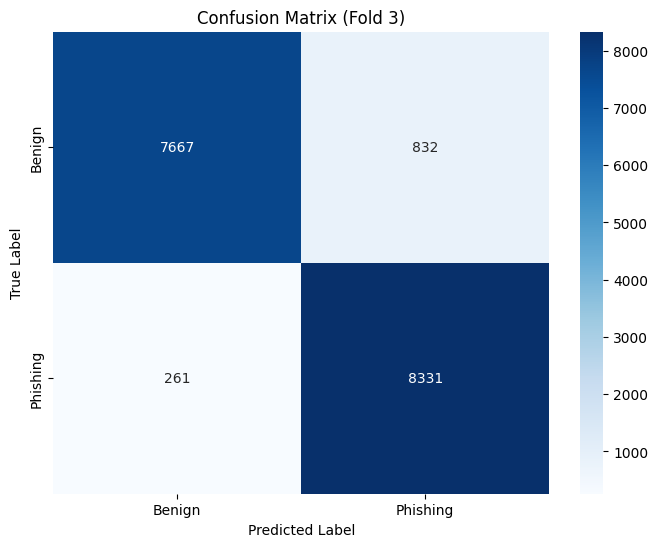

,Epoch,Train Loss,Train Accuracy (%),Validation Loss,Validation Accuracy (%),F1 Score,Precision,Recall,AUC-ROC
0,1,0.2888,86.75,0.2377,89.67,0.8962,0.9048,0.8967,0.9736
1,2,0.1983,90.79,0.1877,91.59,0.9156,0.9211,0.9159,0.9811
2,3,0.1691,91.97,0.1820,91.70,0.9168,0.9224,0.9170,0.9819
3,4,0.1541,92.59,0.1684,92.66,0.9265,0.9296,0.9266,0.9825
4,5,0.1444,92.97,0.1505,93.24,0.9323,0.9345,0.9324,0.9852
5,6,0.1393,93.16,0.1461,93.55,0.9354,0.9371,0.9355,0.9863
6,7,0.1334,93.41,0.1553,92.98,0.9297,0.9331,0.9298,0.9845
7,8,0.1314,93.51,0.1406,93.77,0.9377,0.9395,0.9377,0.9869
8,9,0.1277,93.64,0.1461,93.55,0.9355,0.9378,0.9355,0.9860
9,10,0.1255,93.69,0.1501,93.35,0.9335,0.9363,0.9335,0.9856


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Data dari log Fold 3
epochs = list(range(1, 21))
train_loss = [
    0.2888, 0.1983, 0.1691, 0.1541, 0.1444, 0.1393, 0.1334, 0.1314, 0.1277, 0.1255,
    0.1240, 0.1228, 0.1214, 0.1209, 0.1189, 0.1191, 0.1180, 0.1177, 0.1178, 0.1168
]
val_loss = [
    0.2377, 0.1877, 0.1820, 0.1684, 0.1505, 0.1461, 0.1553, 0.1406, 0.1461, 0.1501,
    0.1548, 0.1517, 0.1463, 0.1450, 0.1548, 0.1579, 0.1623, 0.1520, 0.1514, 0.1468
]
train_acc = [
    86.75, 90.79, 91.97, 92.59, 92.97, 93.16, 93.41, 93.51, 93.64, 93.69,
    93.76, 93.79, 93.85, 93.87, 93.91, 93.91, 93.94, 93.97, 93.97, 93.96
]
val_acc = [
    89.67, 91.59, 91.70, 92.66, 93.24, 93.55, 92.98, 93.77, 93.55, 93.35,
    93.21, 92.96, 93.66, 93.70, 93.53, 93.53, 93.34, 93.54, 93.73, 93.83
]
f1_scores = [
    0.8962, 0.9156, 0.9168, 0.9265, 0.9323, 0.9354, 0.9297, 0.9377, 0.9355, 0.9335,
    0.9320, 0.9294, 0.9366, 0.9369, 0.9353, 0.9352, 0.9333, 0.9353, 0.9372, 0.9382
]
precisions = [
    0.9048, 0.9211, 0.9224, 0.9296, 0.9345, 0.9371, 0.9331, 0.9395, 0.9378, 0.9363,
    0.9353, 0.9343, 0.9387, 0.9393, 0.9380, 0.9376, 0.9362, 0.9379, 0.9396, 0.9403
]
recalls = [
    0.8967, 0.9159, 0.9170, 0.9266, 0.9324, 0.9355, 0.9298, 0.9377, 0.9355, 0.9335,
    0.9321, 0.9296, 0.9366, 0.9370, 0.9353, 0.9353, 0.9334, 0.9354, 0.9373, 0.9383
]
auc_rocs = [
    0.9736, 0.9811, 0.9819, 0.9825, 0.9852, 0.9863, 0.9845, 0.9869, 0.9860, 0.9856,
    0.9849, 0.9859, 0.9862, 0.9859, 0.9849, 0.9856, 0.9840, 0.9856, 0.9858, 0.9867
]

# Confusion matrix data
confusion_matrix = np.array([[7667, 832], [261, 8331]])


# Plotting train/val loss
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
plt.title('Train & Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# Plotting train/val accuracy
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='o')
plt.title('Train & Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid()
plt.show()

# Plotting other metrics
plt.figure(figsize=(12, 6))
plt.plot(epochs, f1_scores, label='F1 Score', marker='o')
plt.plot(epochs, precisions, label='Precision', marker='o')
plt.plot(epochs, recalls, label='Recall', marker='o')
plt.plot(epochs, auc_rocs, label='AUC-ROC', marker='o')
plt.title('Metrics: F1 Score, Precision, Recall, AUC-ROC')
plt.xlabel('Epochs')
plt.ylabel('Metric Value')
plt.legend()
plt.grid()
plt.show()

# Plotting confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'], yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix (Fold 3)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display log table for Fold 3
data = {
    "Epoch": epochs,
    "Train Loss": train_loss,
    "Train Accuracy (%)": train_acc,
    "Validation Loss": val_loss,
    "Validation Accuracy (%)": val_acc,
    "F1 Score": f1_scores,
    "Precision": precisions,
    "Recall": recalls,
    "AUC-ROC": auc_rocs
}
log_table = pd.DataFrame(data)
log_table


---

 **Performansi Terbaik**
**Fold Terbaik**: **Fold 8**  
**Epoch Terbaik (Fold 8)**: **Epoch 20**  


| **Metric**         | **Value**        |
|---------------------|------------------|
| **Train Loss**      | 0.1168           |
| **Train Accuracy**  | 93.96%           |
| **Validation Loss** | 0.1468           |
| **Validation Accuracy** | 93.83%       |
| **F1 Score**        | 0.9382           |
| **Precision**       | 0.9403           |
| **Recall**          | 0.9383           |
| **AUC-ROC**         | 0.9867           |

---

 **Rata-rata Performa Semua Fold**

| **Metric**          | **Mean ± Std**          |
|----------------------|-------------------------|
| **Train Loss**       | 0.2917 ± 0.0067         |
| **Validation Loss**  | 0.2270 ± 0.0084         |
| **Train Accuracy**   | 94.06% ± 0.04%          |
| **Validation Accuracy** | 93.30% ± 0.25%       |
| **F1 Score**         | 0.9329 ± 0.0025         |
| **Precision**        | 0.9352 ± 0.0024         |
| **Recall**           | 0.9330 ± 0.0025         |
| **AUC-ROC**          | 0.9855 ± 0.0007         |

---

 **Confusion Matrix Keseluruhan**

| **Type**              | **Value**  |
|------------------------|------------|
| **True Positives (TP)** | 82,769    |
| **True Negatives (TN)** | 76,546    |
| **False Positives (FP)** | 8,910    |
| **False Negatives (FN)** | 2,687    |

---

 **Waktu Pelatihan**
- **Total Training Time for All Folds**: **52,728.78 seconds**  
- **Best Model Saved At**: **`best_model_smote_nontune_fold_8.pth`**  

## Data Balanced Tune

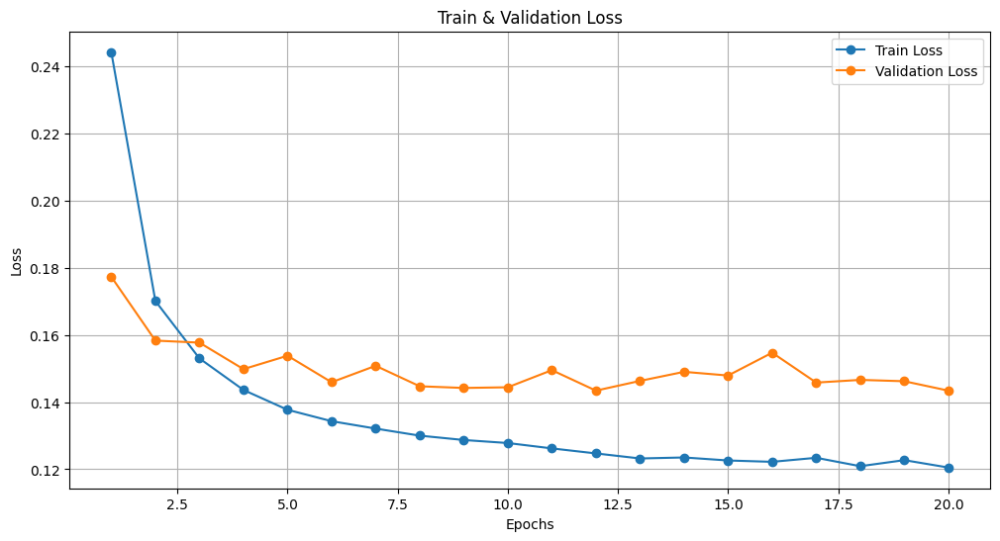

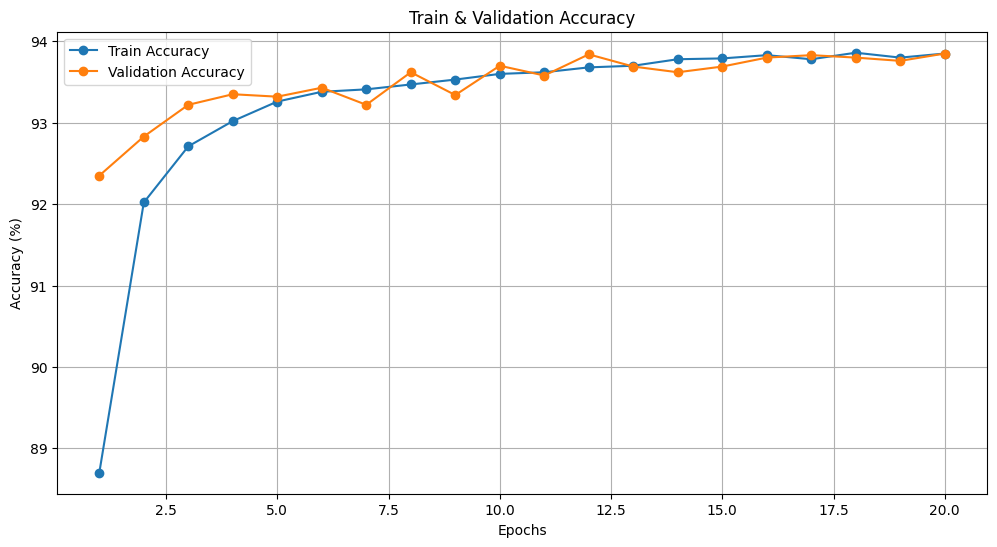

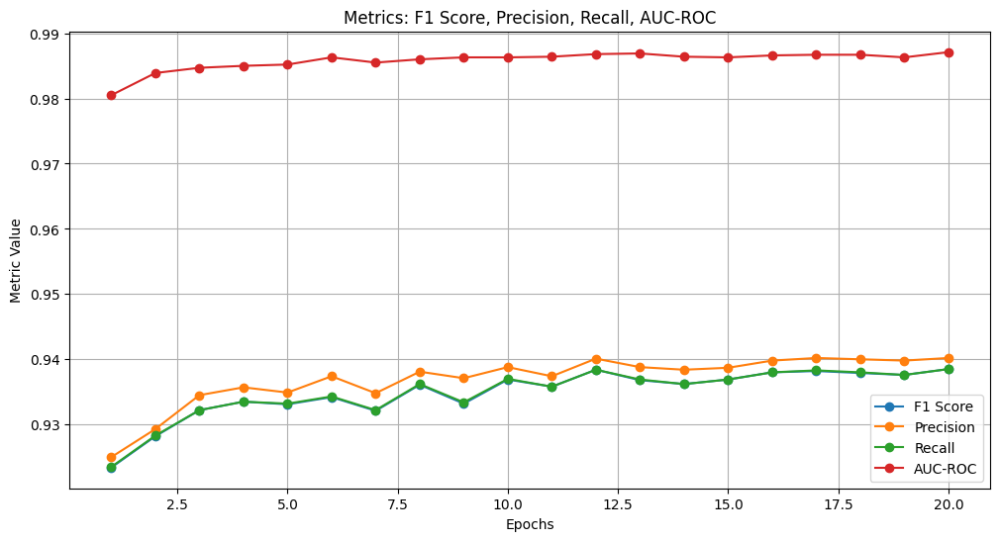

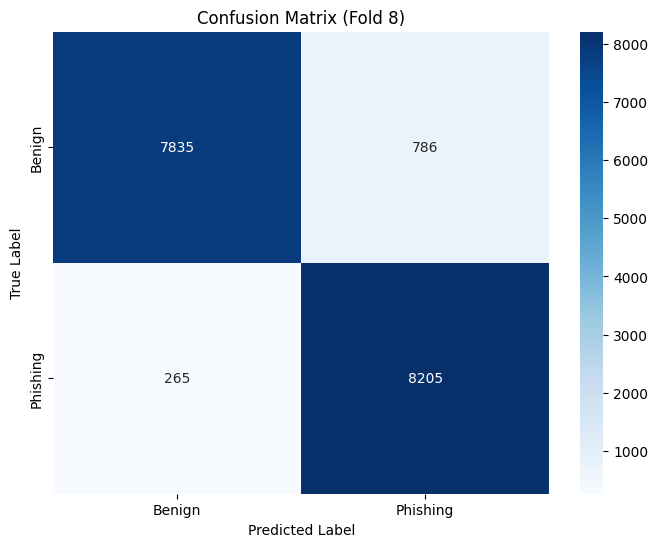

,Epoch,Train Loss,Train Accuracy (%),Validation Loss,Validation Accuracy (%),F1 Score,Precision,Recall,AUC-ROC
0,1,0.2442,88.70,0.1773,92.35,0.9234,0.9250,0.9235,0.9805
1,2,0.1701,92.02,0.1583,92.83,0.9282,0.9293,0.9283,0.9839
2,3,0.1530,92.71,0.1577,93.22,0.9322,0.9345,0.9322,0.9847
3,4,0.1436,93.02,0.1498,93.35,0.9335,0.9357,0.9335,0.9850
4,5,0.1377,93.26,0.1538,93.32,0.9331,0.9349,0.9332,0.9852
5,6,0.1343,93.38,0.1459,93.43,0.9342,0.9374,0.9343,0.9863
6,7,0.1321,93.41,0.1508,93.22,0.9321,0.9348,0.9322,0.9855
7,8,0.1300,93.47,0.1447,93.62,0.9361,0.9381,0.9362,0.9860
8,9,0.1287,93.53,0.1442,93.34,0.9332,0.9371,0.9334,0.9863
9,10,0.1278,93.60,0.1444,93.70,0.9369,0.9388,0.9370,0.9863


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Data dari log Fold 8
epochs = list(range(1, 21))
train_loss = [0.2442, 0.1701, 0.1530, 0.1436, 0.1377, 0.1343, 0.1321, 0.1300, 0.1287, 0.1278,
              0.1262, 0.1247, 0.1232, 0.1235, 0.1226, 0.1222, 0.1234, 0.1209, 0.1227, 0.1205]
val_loss = [0.1773, 0.1583, 0.1577, 0.1498, 0.1538, 0.1459, 0.1508, 0.1447, 0.1442, 0.1444,
            0.1495, 0.1434, 0.1463, 0.1490, 0.1479, 0.1547, 0.1458, 0.1466, 0.1462, 0.1434]
train_acc = [88.70, 92.02, 92.71, 93.02, 93.26, 93.38, 93.41, 93.47, 93.53, 93.60,
             93.62, 93.68, 93.70, 93.78, 93.79, 93.83, 93.78, 93.86, 93.80, 93.85]
val_acc = [92.35, 92.83, 93.22, 93.35, 93.32, 93.43, 93.22, 93.62, 93.34, 93.70,
           93.58, 93.84, 93.69, 93.62, 93.69, 93.80, 93.83, 93.80, 93.76, 93.85]
f1_scores = [0.9234, 0.9282, 0.9322, 0.9335, 0.9331, 0.9342, 0.9321, 0.9361, 0.9332, 0.9369,
             0.9358, 0.9384, 0.9368, 0.9362, 0.9369, 0.9380, 0.9382, 0.9379, 0.9376, 0.9385]
precisions = [0.9250, 0.9293, 0.9345, 0.9357, 0.9349, 0.9374, 0.9348, 0.9381, 0.9371, 0.9388,
              0.9374, 0.9401, 0.9388, 0.9384, 0.9387, 0.9398, 0.9402, 0.9400, 0.9398, 0.9402]
recalls = [0.9235, 0.9283, 0.9322, 0.9335, 0.9332, 0.9343, 0.9322, 0.9362, 0.9334, 0.9370,
           0.9358, 0.9384, 0.9369, 0.9362, 0.9369, 0.9380, 0.9383, 0.9380, 0.9376, 0.9385]
auc_rocs = [0.9805, 0.9839, 0.9847, 0.9850, 0.9852, 0.9863, 0.9855, 0.9860, 0.9863, 0.9863,
            0.9864, 0.9868, 0.9869, 0.9864, 0.9863, 0.9866, 0.9867, 0.9867, 0.9863, 0.9871]

# Confusion matrix data
confusion_matrix = np.array([[7835, 786], [265, 8205]])

# Plotting train/val loss
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_loss, label='Train Loss', marker='o')
plt.plot(epochs, val_loss, label='Validation Loss', marker='o')
plt.title('Train & Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# Plotting train/val accuracy
plt.figure(figsize=(12, 6))
plt.plot(epochs, train_acc, label='Train Accuracy', marker='o')
plt.plot(epochs, val_acc, label='Validation Accuracy', marker='o')
plt.title('Train & Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.legend()
plt.grid()
plt.show()

# Plotting other metrics
plt.figure(figsize=(12, 6))
plt.plot(epochs, f1_scores, label='F1 Score', marker='o')
plt.plot(epochs, precisions, label='Precision', marker='o')
plt.plot(epochs, recalls, label='Recall', marker='o')
plt.plot(epochs, auc_rocs, label='AUC-ROC', marker='o')
plt.title('Metrics: F1 Score, Precision, Recall, AUC-ROC')
plt.xlabel('Epochs')
plt.ylabel('Metric Value')
plt.legend()
plt.grid()
plt.show()

# Plotting confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign', 'Phishing'], yticklabels=['Benign', 'Phishing'])
plt.title('Confusion Matrix (Fold 8)')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

# Display log table for Fold 8
data = {
    "Epoch": epochs,
    "Train Loss": train_loss,
    "Train Accuracy (%)": train_acc,
    "Validation Loss": val_loss,
    "Validation Accuracy (%)": val_acc,
    "F1 Score": f1_scores,
    "Precision": precisions,
    "Recall": recalls,
    "AUC-ROC": auc_rocs
}
log_table = pd.DataFrame(data)
log_table


Berikut adalah format yang disesuaikan untuk hasil performa seperti yang Anda minta:

---

 **Performansi Terbaik**

**Fold Terbaik**: **Fold 8**  
**Epoch Terbaik (Fold 8)**: **Epoch 20**  
**Model Tersimpan di**: `best_model_smote_tune_fold_8.pth`

| **Metric**         | **Value**      |
|---------------------|----------------|
| **Train Loss**      | 0.1205         |
| **Train Accuracy**  | 93.85%         |
| **Validation Loss** | 0.1434         |
| **Validation Accuracy** | 93.85%     |
| **F1 Score**        | 0.9385         |
| **Precision**       | 0.9402         |
| **Recall**          | 0.9385         |
| **AUC-ROC**         | 0.9871         |

---

 **Rata-rata Performa Semua Fold**

| **Metric**          | **Mean ± Std**          |
|----------------------|-------------------------|
| **Train Loss**       | 0.2522 ± 0.0039         |
| **Validation Loss**  | 0.1865 ± 0.0047         |
| **Train Accuracy**   | 93.92% ± 0.04%          |
| **Validation Accuracy** | 93.32% ± 0.26%       |
| **F1 Score**         | 0.9331 ± 0.0026         |
| **Precision**        | 0.9352 ± 0.0023         |
| **Recall**           | 0.9332 ± 0.0026         |
| **AUC-ROC**          | 0.9856 ± 0.0006         |

---

 **Confusion Matrix Keseluruhan**

| **Type**              | **Value**  |
|------------------------|------------|
| **True Positives (TP)** | 82,512    |
| **True Negatives (TN)** | 76,849    |
| **False Positives (FP)** | 8,607    |
| **False Negatives (FN)** | 2,944    |

---

 **Waktu Pelatihan**

**Total waktu pelatihan semua fold**: **25,596.81 detik**

Jika ada detail tambahan, saya bisa membantu memperbarui atau menyesuaikannya! 🚀